# Disease Prediction using Machine Learning Malaria as exemple


### Import libraries for the analysis 

In [1]:
import pandas as pd        
import numpy as np         
import matplotlib.pyplot as plt   # data visualization
import seaborn as sns             # data visualization


### Data Loading

In [2]:
#read the data with pandas
dataframe=pd.read_csv('malaria_clin_data.csv')
dataframe

,SampleID,consent_given,location,Enrollment_Year,bednet,fever_symptom,temperature,Suspected_Organism,Suspected_infection,RDT,...,platelet_count,platelet_distr_width,mean_platelet_vl,neutrophils_percent,lymphocytes_percent,mixed_cells_percent,neutrophils_count,lymphocytes_count,mixed_cells_count,RBC_dist_width_Percent
0,CCS20043,yes,Navrongo,2004,NaN,Yes,38.0,Not Known / Missing entry,NaN,Positive,...,156.0,8.2,6.8,61.8,31.7,6.5,3.6,1.8,0.3,19.0
1,CCS20102,yes,Navrongo,2004,NaN,Yes,38.2,Not Known / Missing entry,NaN,Positive,...,55.0,16.5,7.6,68.5,23.6,7.9,5.4,1.8,0.6,14.4
2,CCS20106,yes,Navrongo,2004,NaN,Yes,37.7,Not Known / Missing entry,NaN,Positive,...,20.0,2.3,5.9,32.8,53.3,13.9,2.8,4.3,1.1,18.0
3,CCS20147,yes,Navrongo,2004,NaN,Yes,37.7,Not Known / Missing entry,NaN,Positive,...,132.0,17.2,6.2,82.6,11.5,5.9,13.2,1.8,0.9,13.7
4,CCS20170,yes,Navrongo,2004,NaN,Yes,37.1,Not Known / Missing entry,NaN,Positive,...,85.0,16.1,6.8,83.7,11.3,5.0,3.8,0.5,0.2,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2202,KC366,yes,Kintampo,2017,yes,No,37.1,Bacteria/Protozoa,Malaria/LRTI,Positive,...,277.0,12.3,7.1,71.3,22.6,6.1,8.9,2.7,0.7,16.1
2203,KC368,yes,Kintampo,2017,no,No,36.7,Bacteria/Protozoa,Helminthiasis,Negative,...,340.0,15.2,7.2,73.6,21.0,5.4,6.0,1.7,0.4,15.1
2204,KC369,yes,Kintampo,2017,yes,No,36.4,Bacteria,Dermatitis,Negative,...,300.0,14.3,6.5,43.6,49.4,7.0,4.3,4.6,0.6,18.2
2205,KC370,yes,Kintampo,2017,yes,No,37.4,Not Known / Missing entry,URTI,Negative,...,136.0,13.3,7.1,35.3,58.1,6.6,4.4,7.1,0.8,14.2


## Target

In [4]:
dataframe['Clinical_Diagnosis'].describe()

count                      2207
unique                        3
top       Non-malaria Infection
freq                        978
Name: Clinical_Diagnosis, dtype: object

In [22]:
target = dataframe['Clinical_Diagnosis']

In [5]:
# the number of rows and columns in the dataframe
dataframe.shape

(2207, 34)

In [6]:
#the first 5 rows in the dataframe
dataframe.head()

,SampleID,consent_given,location,Enrollment_Year,bednet,fever_symptom,temperature,Suspected_Organism,Suspected_infection,RDT,...,platelet_count,platelet_distr_width,mean_platelet_vl,neutrophils_percent,lymphocytes_percent,mixed_cells_percent,neutrophils_count,lymphocytes_count,mixed_cells_count,RBC_dist_width_Percent
0,CCS20043,yes,Navrongo,2004,NaN,Yes,38.0,Not Known / Missing entry,NaN,Positive,...,156.0,8.2,6.8,61.8,31.7,6.5,3.6,1.8,0.3,19.0
1,CCS20102,yes,Navrongo,2004,NaN,Yes,38.2,Not Known / Missing entry,NaN,Positive,...,55.0,16.5,7.6,68.5,23.6,7.9,5.4,1.8,0.6,14.4
2,CCS20106,yes,Navrongo,2004,NaN,Yes,37.7,Not Known / Missing entry,NaN,Positive,...,20.0,2.3,5.9,32.8,53.3,13.9,2.8,4.3,1.1,18.0
3,CCS20147,yes,Navrongo,2004,NaN,Yes,37.7,Not Known / Missing entry,NaN,Positive,...,132.0,17.2,6.2,82.6,11.5,5.9,13.2,1.8,0.9,13.7
4,CCS20170,yes,Navrongo,2004,NaN,Yes,37.1,Not Known / Missing entry,NaN,Positive,...,85.0,16.1,6.8,83.7,11.3,5.0,3.8,0.5,0.2,15.0


In [7]:
# list the column names
dataframe.columns

Index(['SampleID', 'consent_given', 'location', 'Enrollment_Year', 'bednet',
       'fever_symptom', 'temperature', 'Suspected_Organism',
       'Suspected_infection', 'RDT', 'Blood_culture', 'Urine_culture',
       'Taq_man_PCR', 'parasite_density', 'Microscopy', 'Laboratory_Results',
       'Clinical_Diagnosis', 'wbc_count', 'rbc_count', 'hb_level',
       'hematocrit', 'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
       'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
       'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
       'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
       'RBC_dist_width_Percent'],
      dtype='object')

In [8]:
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2207 entries, 0 to 2206
Data columns (total 34 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   SampleID                2207 non-null   object 
 1   consent_given           2207 non-null   object 
 2   location                2207 non-null   object 
 3   Enrollment_Year         2207 non-null   int64  
 4   bednet                  1676 non-null   object 
 5   fever_symptom           2200 non-null   object 
 6   temperature             2197 non-null   float64
 7   Suspected_Organism      2207 non-null   object 
 8   Suspected_infection     1569 non-null   object 
 9   RDT                     2065 non-null   object 
 10  Blood_culture           122 non-null    object 
 11  Urine_culture           112 non-null    object 
 12  Taq_man_PCR             176 non-null    object 
 13  parasite_density        2173 non-null   float64
 14  Microscopy              2170 non-null   

In [9]:
#we are interested in the columns : 'Clinical_diagnosis' up to 'RBC_dist_width_Percent'
#meaning we will subset the data from column 16 - the last column
subset=dataframe.iloc[:,16:]

In [10]:
subset.columns

Index(['Clinical_Diagnosis', 'wbc_count', 'rbc_count', 'hb_level',
       'hematocrit', 'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
       'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
       'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
       'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
       'RBC_dist_width_Percent'],
      dtype='object')

1. **Clinical_Diagnosis**: This column  contains the clinical diagnosis for each case, indicating whether the individual was diagnosed with malaria or not.

2. **wbc_count**: White Blood Cell (WBC) count refers to the number of white blood cells per volume of blood. It is a measure of the body's immune response and can indicate whether there is an infection present, including malaria.

3. **rbc_count**: Red Blood Cell (RBC) count refers to the number of red blood cells per volume of blood. Malaria can affect RBCs, leading to anemia and other complications, so monitoring RBC count is important in diagnosing and managing malaria.

4. **hb_level**: Hemoglobin (Hb) level measures the amount of hemoglobin, a protein in red blood cells that carries oxygen, in the blood. Malaria can cause hemolysis (destruction of RBCs), leading to a decrease in hemoglobin levels and anemia.

5. **hematocrit**: Hematocrit is the percentage of the blood volume that is occupied by red blood cells. It is another measure of anemia and can be affected by malaria-induced hemolysis.

6. **mean_cell_volume**: Mean Cell Volume (MCV) is the average volume of a red blood cell. Changes in MCV can indicate various types of anemia, including that caused by malaria.

7. **mean_corp_hb**: Mean Corpuscular Hemoglobin (MCH) is the average amount of hemoglobin per red blood cell. It provides information about the amount of hemoglobin available in each RBC, which can be affected by malaria-induced hemolysis.

8. **mean_cell_hb_conc**: Mean Corpuscular Hemoglobin Concentration (MCHC) is the average concentration of hemoglobin in a given volume of packed red blood cells. It provides information about the concentration of hemoglobin in RBCs and can be altered in various types of anemia, including that caused by malaria.

9. **platelet_count**: Platelet count refers to the number of platelets (thrombocytes) in the blood. Malaria can cause thrombocytopenia (low platelet count), which can lead to bleeding complications.

10. **platelet_distr_width**: Platelet Distribution Width (PDW) is a measure of the variation in platelet size. Changes in PDW can indicate platelet activation and consumption, which can occur in malaria.

11. **mean_platelet_vl**: Mean Platelet Volume (MPV) is the average volume of platelets in the blood. Changes in MPV can indicate platelet activation and can be associated with various conditions, including malaria.

12. **neutrophils_percent**: Neutrophils Percentage refers to the percentage of white blood cells that are neutrophils. Neutrophils are a type of white blood cell involved in the immune response to infections, including malaria.

13. **lymphocytes_percent**: Lymphocytes Percentage refers to the percentage of white blood cells that are lymphocytes. Lymphocytes play a role in the adaptive immune response and can be affected by malaria.

14. **mixed_cells_percent**: Mixed Cells Percentage refers to the percentage of white blood cells that are neither neutrophils nor lymphocytes. This category may include other types of white blood cells such as monocytes and eosinophils, which can also be affected by malaria.

15. **neutrophils_count**: Neutrophils Count refers to the absolute number of neutrophils in the blood. It provides information about the body's response to infection, including malaria.

16. **lymphocytes_count**: Lymphocytes Count refers to the absolute number of lymphocytes in the blood. Changes in lymphocyte count can indicate alterations in the immune response, which can occur during malaria infection.

17. **mixed_cells_count**: Mixed Cells Count refers to the absolute number of white blood cells that are neither neutrophils nor lymphocytes. Similar to the percentage, this category may include other types of white blood cells that can be affected by malaria.

18. **RBC_dist_width_Percent**: Red Blood Cell Distribution Width-Percent (RDW-SD) measures the variation in the size of red blood cells. Changes in RDW can indicate the presence of different types of anemia, including that caused by malaria.


In [11]:
subset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2207 entries, 0 to 2206
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Clinical_Diagnosis      2207 non-null   object 
 1   wbc_count               2207 non-null   float64
 2   rbc_count               2207 non-null   float64
 3   hb_level                2207 non-null   float64
 4   hematocrit              2207 non-null   float64
 5   mean_cell_volume        2207 non-null   float64
 6   mean_corp_hb            2204 non-null   float64
 7   mean_cell_hb_conc       2205 non-null   float64
 8   platelet_count          2198 non-null   float64
 9   platelet_distr_width    2175 non-null   float64
 10  mean_platelet_vl        2190 non-null   float64
 11  neutrophils_percent     2207 non-null   float64
 12  lymphocytes_percent     2207 non-null   float64
 13  mixed_cells_percent     2207 non-null   float64
 14  neutrophils_count       2195 non-null   

In [12]:
subset.describe()

,wbc_count,rbc_count,hb_level,hematocrit,mean_cell_volume,mean_corp_hb,mean_cell_hb_conc,platelet_count,platelet_distr_width,mean_platelet_vl,neutrophils_percent,lymphocytes_percent,mixed_cells_percent,neutrophils_count,lymphocytes_count,mixed_cells_count,RBC_dist_width_Percent
count,2207.000000,2207.000000,2207.000000,2207.000000,2207.000000,2204.000000,2205.000000,2198.000000,2175.000000,2190.000000,2207.000000,2207.000000,2207.000000,2195.000000,2196.000000,2196.000000,2198.000000
mean,10.734209,3.890689,9.360222,29.101541,74.635850,24.102704,32.304259,213.672611,14.124184,8.026119,58.486951,33.119574,8.393521,6.435157,3.450660,0.856179,16.381797
std,5.924517,1.139474,2.680846,8.912130,8.239094,3.227082,2.893977,129.661849,3.092620,1.196604,16.561085,14.938599,3.466975,4.244165,2.560436,0.637455,2.610800
min,0.500000,0.500000,1.400000,4.300000,7.800000,2.100000,15.700000,3.000000,0.000000,3.300000,9.300000,3.800000,0.300000,0.100000,0.300000,0.000000,10.600000
25%,6.850000,3.300000,7.800000,23.700000,69.800000,22.100000,30.600000,104.000000,12.900000,7.200000,45.900000,20.800000,5.800000,3.600000,1.700000,0.400000,14.500000
50%,9.300000,4.150000,10.100000,31.600000,75.000000,24.100000,32.100000,199.500000,14.900000,7.900000,59.200000,31.800000,8.100000,5.400000,2.800000,0.700000,15.800000
75%,12.900000,4.640000,11.300000,35.400000,80.000000,26.200000,33.500000,299.000000,15.600000,8.800000,72.100000,44.200000,10.600000,8.000000,4.400000,1.100000,17.700000
max,53.900000,6.670000,18.700000,52.700000,121.000000,38.800000,46.600000,1087.000000,23.900000,18.600000,93.300000,81.500000,27.300000,42.000000,28.100000,5.600000,29.000000


In [13]:
#The mising data. 
subset.isnull().sum()

Clinical_Diagnosis         0
wbc_count                  0
rbc_count                  0
hb_level                   0
hematocrit                 0
mean_cell_volume           0
mean_corp_hb               3
mean_cell_hb_conc          2
platelet_count             9
platelet_distr_width      32
mean_platelet_vl          17
neutrophils_percent        0
lymphocytes_percent        0
mixed_cells_percent        0
neutrophils_count         12
lymphocytes_count         11
mixed_cells_count         11
RBC_dist_width_Percent     9
dtype: int64

In [14]:
# drop  all rows with missing values
subset.dropna(inplace=True)
subset.shape

(2156, 18)

### EDA

In [15]:
#devide my data to numerical and categorical columns
categoricals = []
numericals = []

for col in subset.columns:
    if subset[col].dtype == 'object':  # Check if the data type is object (categorical)
        categoricals.append(col)
    else:
        numericals.append(col)


<h3>Categorical Features</h3>


In [16]:
#the different malaria labels. 
subset['Clinical_Diagnosis'].unique()

array(['Severe Malaria', 'Uncomplicated Malaria', 'Non-malaria Infection'],
      dtype=object)

In [17]:
# distribution by classes
subset['Clinical_Diagnosis'].value_counts()

Clinical_Diagnosis
Non-malaria Infection    966
Uncomplicated Malaria    702
Severe Malaria           488
Name: count, dtype: int64

<Axes: ylabel='count'>

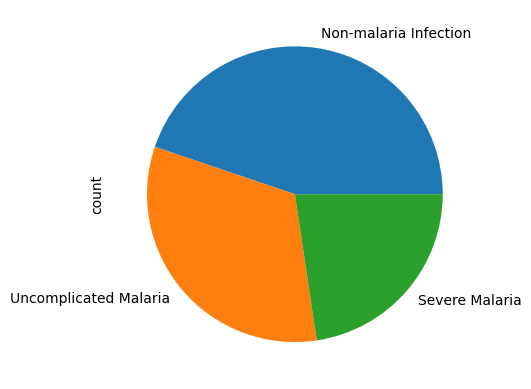

In [19]:
#  visualise the classes distribution

#subset['Clinical_Diagnosis'].value_counts().plot.bar()
subset['Clinical_Diagnosis'].value_counts().plot.pie()

**Normal White Blood Cell Count (WBC):** 

The normal range for white blood cell count (WBC) is typically considered to be 4,500 to 11,000 cells per cubic millimeter (mm^3) of blood. This range may vary slightly depending on the laboratory and reference source.

Reference: [National Library of Medicine - Table 1.1: Reference Ranges for Laboratory Tests During Pregnancy](https://www.ncbi.nlm.nih.gov/books/NBK2263/table/ch1.T1/)


In [20]:

# Define normal range for 'wbc_count'
wbc_count_normal_range = (4.5, 11.0)

# Function to check if a value is normal for 'wbc_count'
def is_wbc_count_normal(value):
    return wbc_count_normal_range[0] <= value <= wbc_count_normal_range[1]

# Create 'status_wbc' column based on normal conditions for 'wbc_count'
subset['status_wbc'] = subset['wbc_count'].apply(lambda x: 'normal' if is_wbc_count_normal(x) else 'not normal')

# Print the DataFrame to verify the 'status_wbc' column
print(subset)

         Clinical_Diagnosis  wbc_count  rbc_count  hb_level  hematocrit  \
0            Severe Malaria        5.7       2.80       5.8        16.1   
1            Severe Malaria        7.8       3.50       9.2        24.2   
2            Severe Malaria        8.2       1.00       2.3         5.7   
3            Severe Malaria       15.9       3.30      10.1        25.1   
4            Severe Malaria        4.5       2.10       5.7        16.1   
...                     ...        ...        ...       ...         ...   
2202  Uncomplicated Malaria       12.3       4.33      10.2        32.0   
2203  Non-malaria Infection        8.1       3.74       9.5        29.1   
2204  Non-malaria Infection        9.5       4.38      11.9        36.6   
2205  Non-malaria Infection       12.3       4.78      12.1        38.2   
2206  Non-malaria Infection        4.7       3.83       9.3        29.9   

      mean_cell_volume  mean_corp_hb  mean_cell_hb_conc  platelet_count  \
0                 59.0  

In [129]:
normal = subset[subset['status_wbc']=='normal']
not_normal = subset[subset['status_wbc']!='normal']
subset['status_wbc'].value_counts(normalize=True)


status_wbc
normal        0.597403
not normal    0.402597
Name: proportion, dtype: float64

In [23]:
target.value_counts(normalize=True)

Clinical_Diagnosis
Non-malaria Infection    0.443135
Uncomplicated Malaria    0.318532
Severe Malaria           0.238333
Name: proportion, dtype: float64

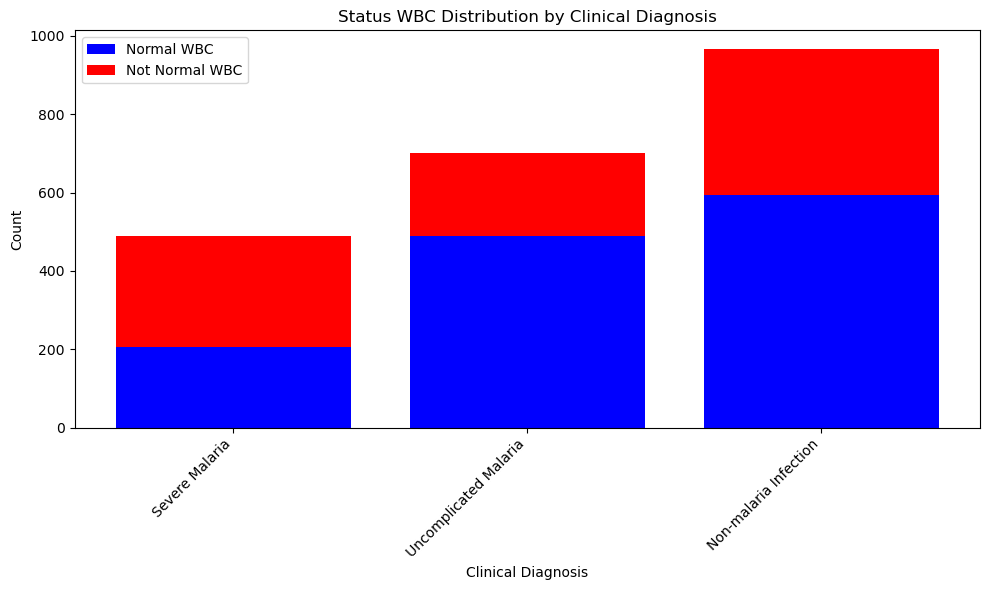

In [24]:
import matplotlib.pyplot as plt

# Create subsets based on 'status' column
normal = subset[subset['status_wbc'] == 'normal']
not_normal = subset[subset['status_wbc'] != 'normal']

# Get unique categories of 'Clinical_Diagnosis'
diagnosis_categories = subset['Clinical_Diagnosis'].unique()

# Plot histogram
plt.figure(figsize=(10, 6))

status_counts = []
for diagnosis in diagnosis_categories:
    normal_count = normal[normal['Clinical_Diagnosis'] == diagnosis].shape[0]
    not_normal_count = not_normal[not_normal['Clinical_Diagnosis'] == diagnosis].shape[0]
    status_counts.append([normal_count, not_normal_count])

status_counts = list(zip(*status_counts))

plt.bar(diagnosis_categories, status_counts[0], color='blue', label='Normal WBC')
plt.bar(diagnosis_categories, status_counts[1], color='red', bottom=status_counts[0], label='Not Normal WBC')

plt.xlabel('Clinical Diagnosis')
plt.ylabel('Count')
plt.title('Status WBC Distribution by Clinical Diagnosis')
plt.legend()

plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()



**Observation:**
In cases of severe malaria, it has been observed that the white blood cell count (WBC) may remain within the normal range.

**Mean corpuscular volume (MCV):** 
MCV is a measure of the average volume of a single red blood cell. It is typically reported in units of femtoliters (fL) or cubic micrometers (µm^3). MCV is an important parameter in a complete blood count (CBC) test and is used to evaluate the size of red blood cells.
The normal range for Mean Corpuscular Volume (MCV) is typically considered to be 80 to 100 µm^3. This range may vary slightly depending on the laboratory and reference source.

Reference: [National Library of Medicine - Table 1.1: Reference Ranges for Laboratory Tests During Pregnancy](https://www.ncbi.nlm.nih.gov/books/NBK2263/table/ch1.T1/)

In [25]:
# Define normal range for 'mean_cell_volume'
mcv_normal_range = (80, 100)

# Function to check if a value is normal for 'mean_cell_volume'
def is_mcv_normal(value):
    return mcv_normal_range[0] <= value <= mcv_normal_range[1]

# Create 'status_mcv' column based on normal conditions for 'mean_cell_volume'
subset['status_mcv'] = subset['mean_cell_volume'].apply(lambda x: 'normal' if is_mcv_normal(x) else 'not normal')

normal_mcv = subset[subset['status_mcv']=='normal']
not_normal_mcv = subset[subset['status_mcv']!='normal']
subset['status_mcv'].value_counts()


status_mcv
not normal    1605
normal         551
Name: count, dtype: int64

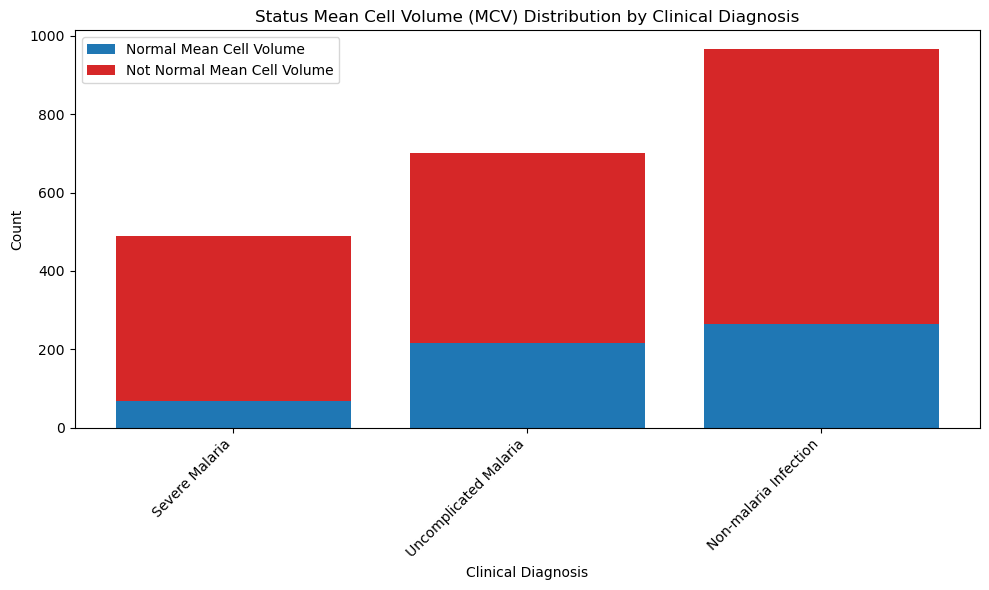

In [26]:


# Get unique categories of 'Clinical_Diagnosis'
diagnosis_categories = subset['Clinical_Diagnosis'].unique()

# Plot histogram
plt.figure(figsize=(10, 6))
# Define colors for the bars
normal_color = '#1f77b4'  # Blue shade
not_normal_color = '#d62728'  # Red shade

status_counts = []
for diagnosis in diagnosis_categories:
    normal_count = normal_mcv[normal_mcv['Clinical_Diagnosis'] == diagnosis].shape[0]
    not_normal_count = not_normal_mcv[not_normal_mcv['Clinical_Diagnosis'] == diagnosis].shape[0]
    status_counts.append([normal_count, not_normal_count])

status_counts = list(zip(*status_counts))

plt.bar(diagnosis_categories, status_counts[0], color=normal_color, label='Normal Mean Cell Volume')
plt.bar(diagnosis_categories, status_counts[1], color=not_normal_color, bottom=status_counts[0], label='Not Normal Mean Cell Volume')

plt.xlabel('Clinical Diagnosis')
plt.ylabel('Count')
plt.title('Status Mean Cell Volume (MCV) Distribution by Clinical Diagnosis')
plt.legend()

plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


**Observation:**
In cases of Non-malaria infection , it has been observed that the mean cell volume  the  count of not-normal mre than normal.

In [140]:
subset.columns

Index(['Clinical_Diagnosis', 'wbc_count', 'rbc_count', 'hb_level',
       'hematocrit', 'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
       'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
       'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
       'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
       'RBC_dist_width_Percent', 'status', 'status_wbc', 'status_mcv'],
      dtype='object')

**Platelets:**

Platelets, also known as thrombocytes, are small cell fragments circulating in the blood that play a crucial role in blood clotting (hemostasis) to stop bleeding.

**Normal Range for Platelet Count:**

The normal range for platelet count is typically considered to be between 150,000 and 400,000 platelets per cubic millimeter (mm^3) of blood, or equivalently, between 150 and 400 x 10^9/L.

Reference: [National Library of Medicine - Table 1.1: Reference Ranges for Laboratory Tests During Pregnancy](https://www.ncbi.nlm.nih.gov/books/NBK2263/table/ch1.T1/)


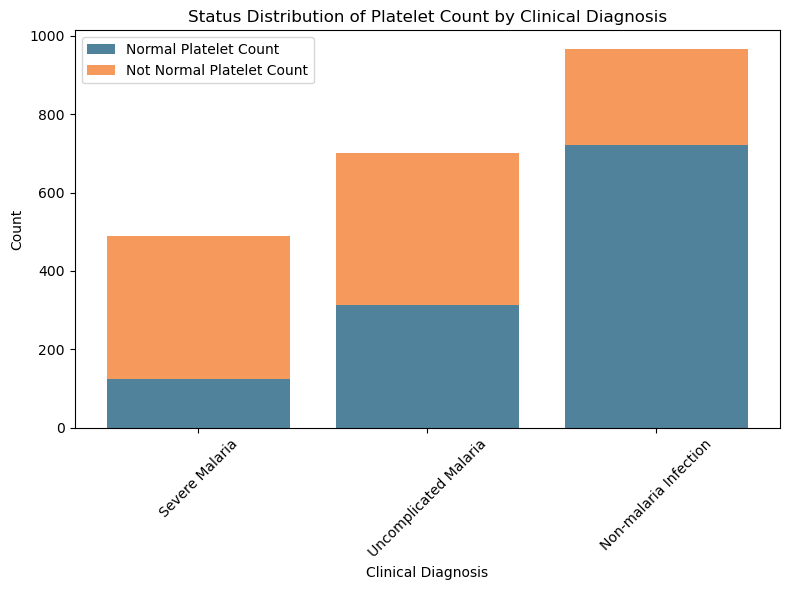

In [27]:

# Define normal range for platelet count
platelet_normal_range = (150, 400)  # *1000/mm^3

# Function to check if a value is normal for platelet count
def is_platelet_normal(value):
    return platelet_normal_range[0] <= value <= platelet_normal_range[1]

# Create 'status_platelet' column based on normal conditions for platelet count
subset['status_platelet'] = subset['platelet_count'].apply(lambda x: 'normal' if is_platelet_normal(x) else 'not normal')

# Get unique categories of 'Clinical_Diagnosis'
diagnosis_categories = subset['Clinical_Diagnosis'].unique()

# Plot histogram for platelet count
plt.figure(figsize=(8, 6))

status_counts = []
for diagnosis in diagnosis_categories:
    normal_count = subset[(subset['status_platelet'] == 'normal') & (subset['Clinical_Diagnosis'] == diagnosis)].shape[0]
    not_normal_count = subset[(subset['status_platelet'] == 'not normal') & (subset['Clinical_Diagnosis'] == diagnosis)].shape[0]
    status_counts.append([normal_count, not_normal_count])

status_counts = list(zip(*status_counts))

plt.bar(diagnosis_categories, status_counts[0], color='#51829B', label='Normal Platelet Count')
plt.bar(diagnosis_categories, status_counts[1], color='#F6995C', bottom=status_counts[0], label='Not Normal Platelet Count')

plt.xlabel('Clinical Diagnosis')
plt.ylabel('Count')
plt.title('Status Distribution of Platelet Count by Clinical Diagnosis')
plt.legend()

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



**Hypothesis:** the counts of Platelets is indecator of infection or not with maleria


<h3>Numerical characteristics</h3>

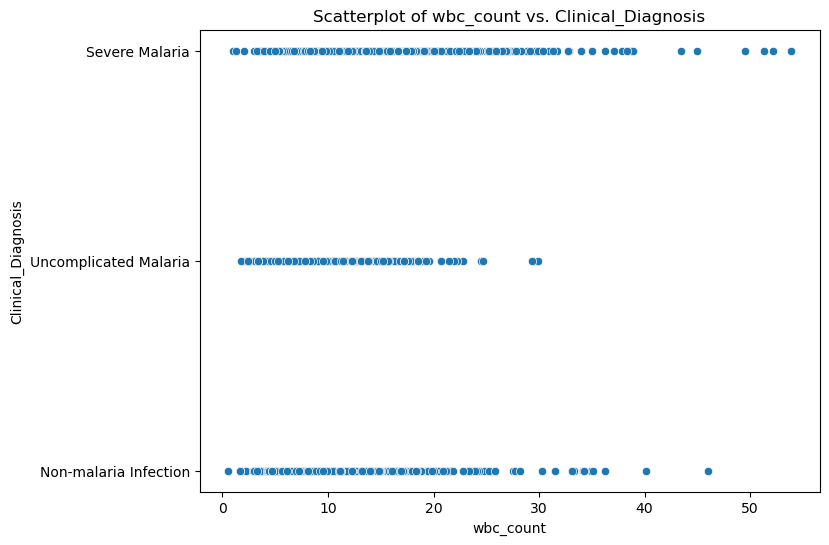

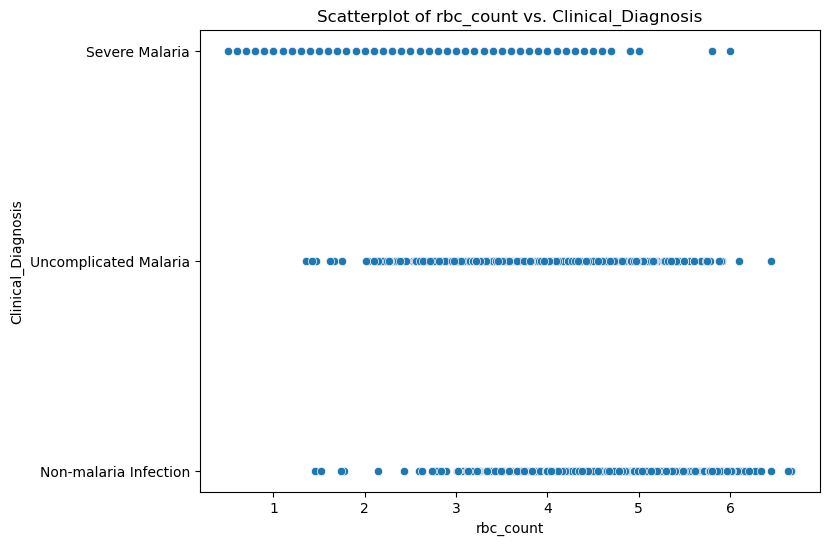

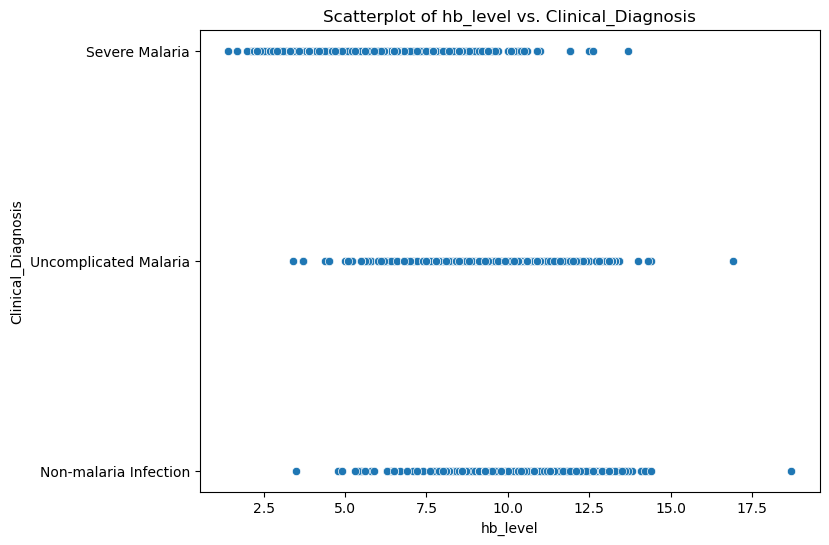

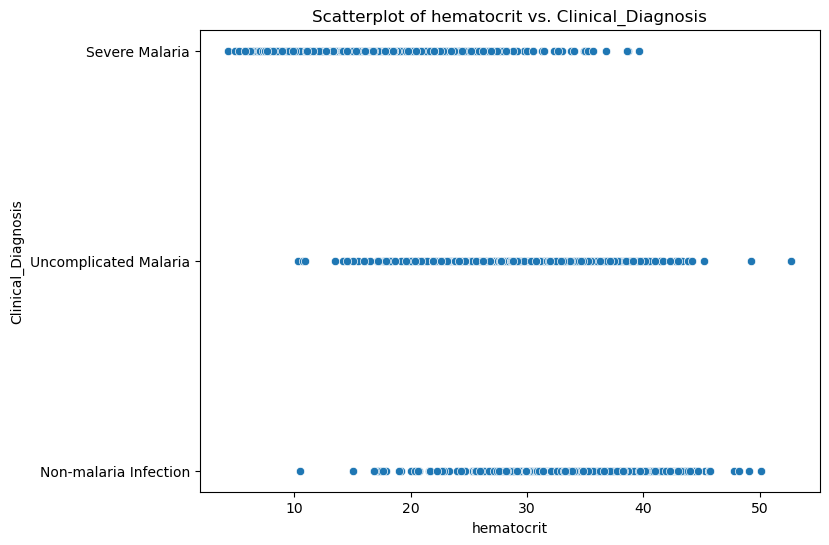

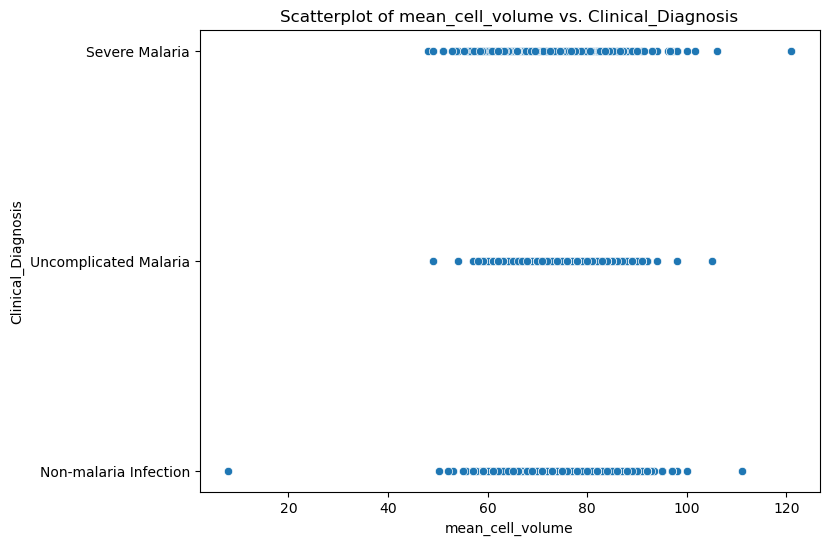

...

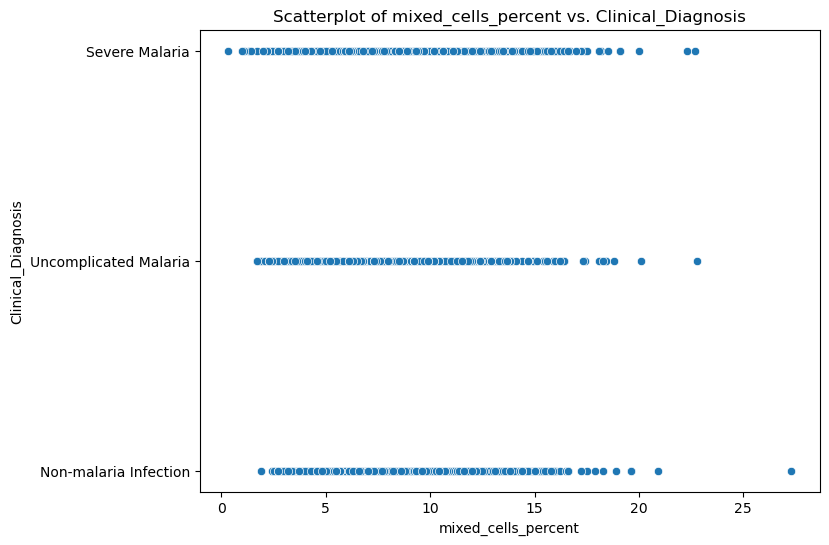

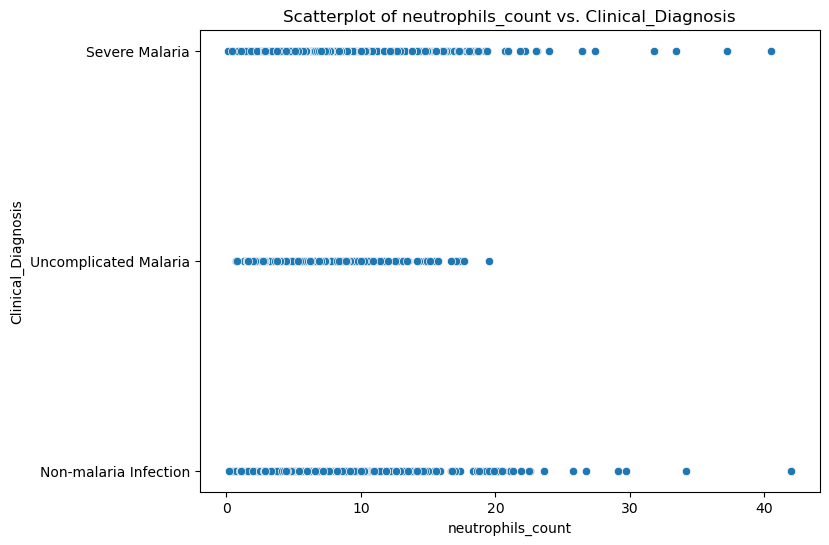

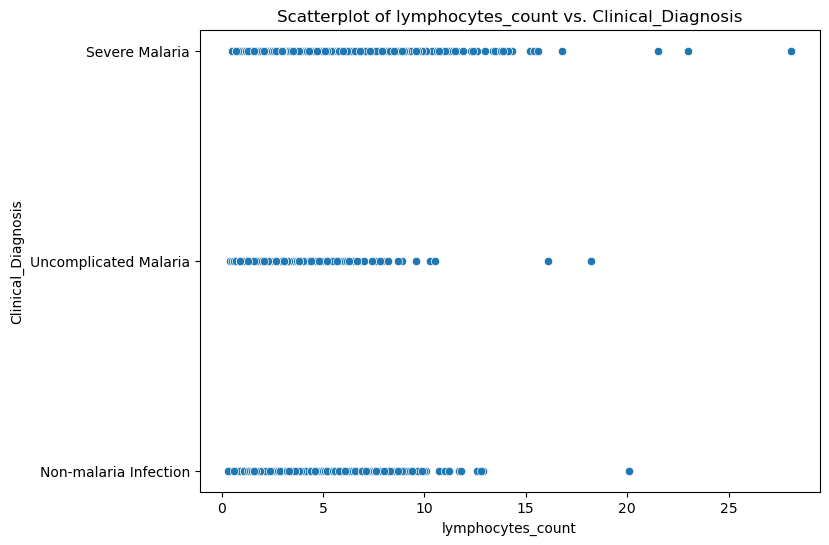

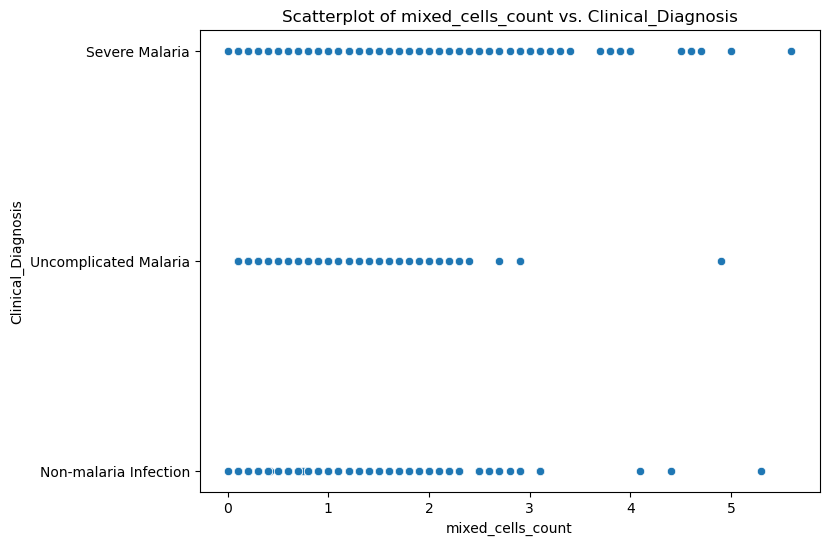

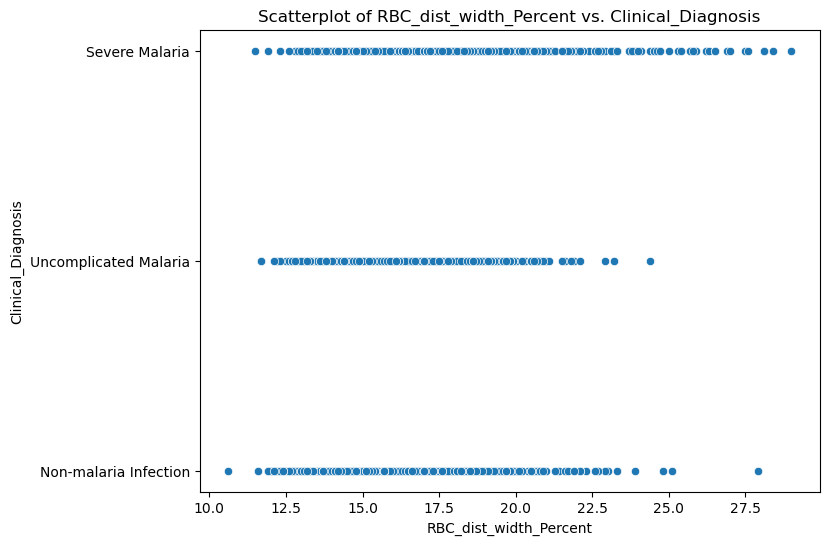

In [30]:
numericals_cols=['wbc_count',
 'rbc_count',
 'hb_level',
 'hematocrit',
 'mean_cell_volume',
 'mean_corp_hb',
 'mean_cell_hb_conc',
 'platelet_count',
 'platelet_distr_width',
 'mean_platelet_vl',
 'neutrophils_percent',
 'lymphocytes_percent',
 'mixed_cells_percent',
 'neutrophils_count',
 'lymphocytes_count',
 'mixed_cells_count',
 'RBC_dist_width_Percent']


# Individual scatterplots
for col in numericals_cols:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=subset, x=col, y='Clinical_Diagnosis')
    plt.title(f'Scatterplot of {col} vs. Clinical_Diagnosis')
    plt.xlabel(col)
    plt.ylabel('Clinical_Diagnosis')
    plt.show()

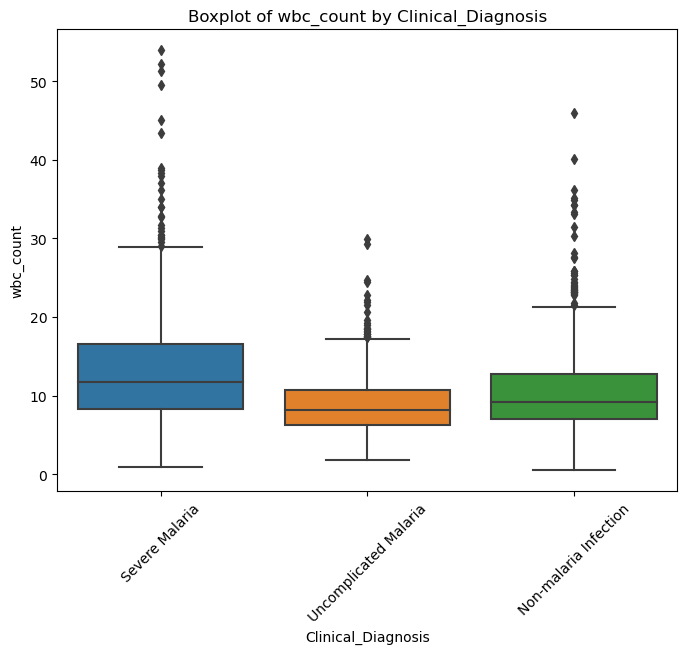

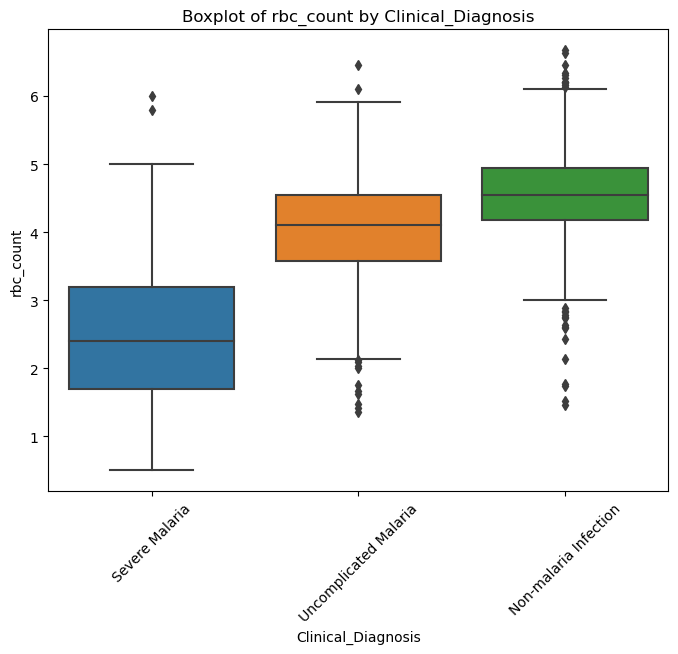

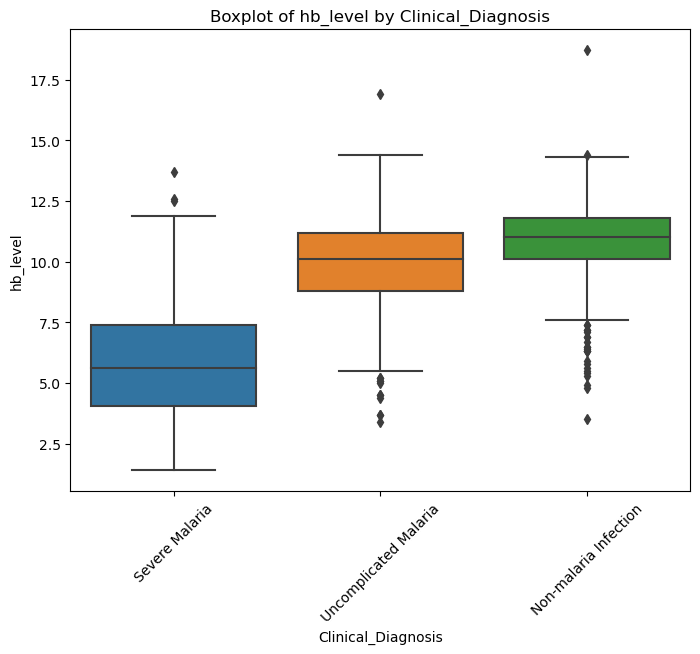

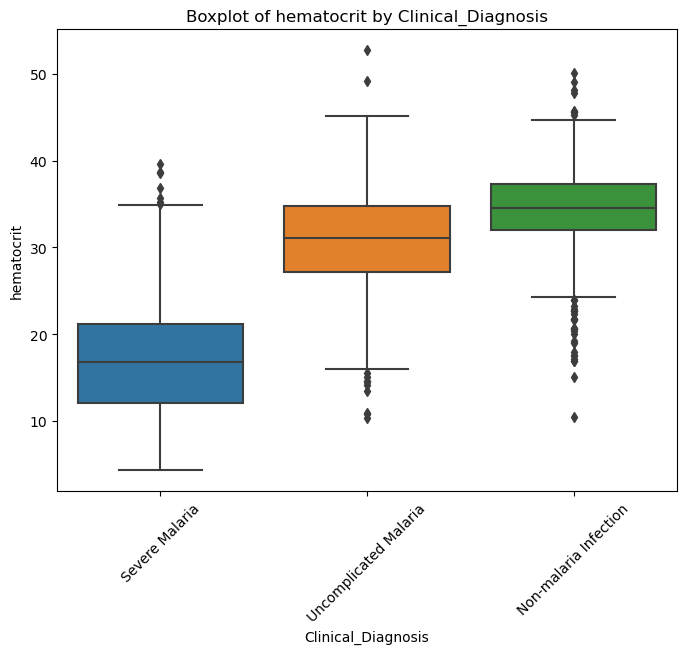

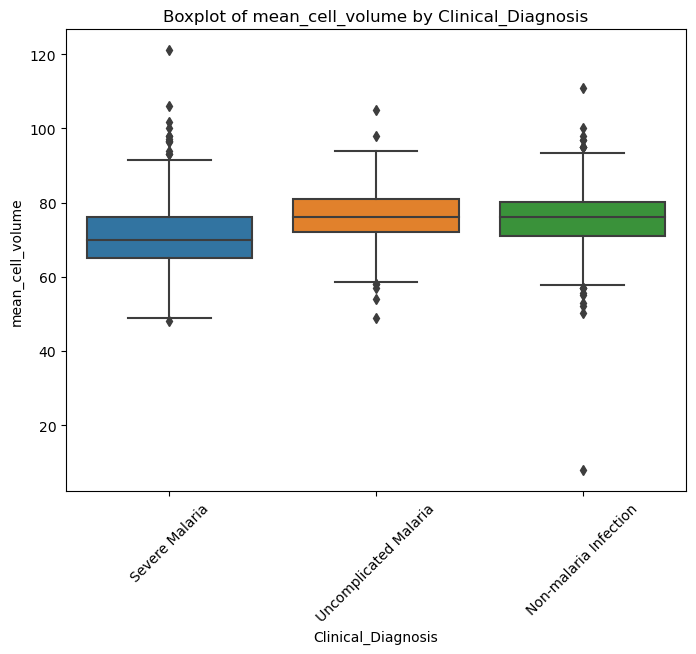

...

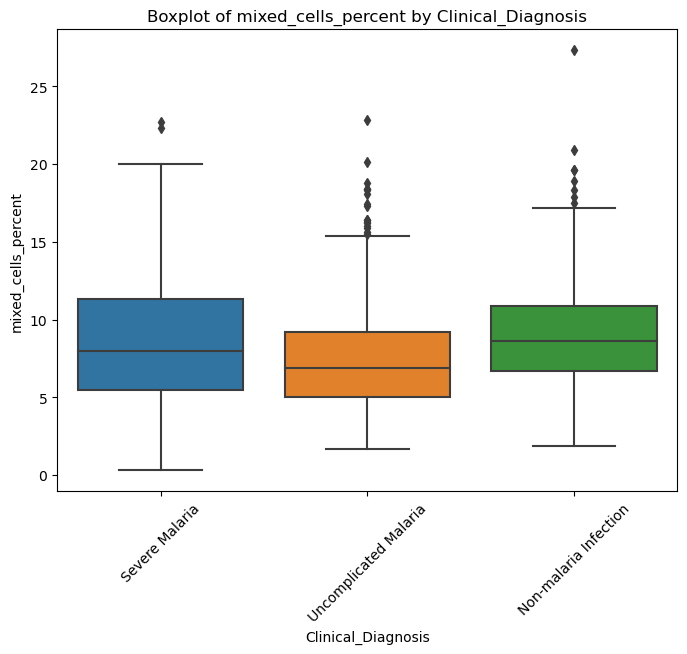

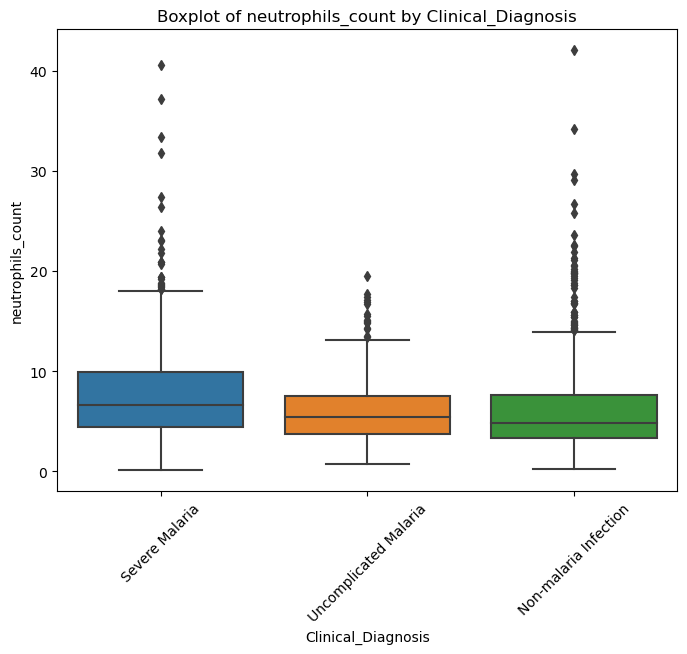

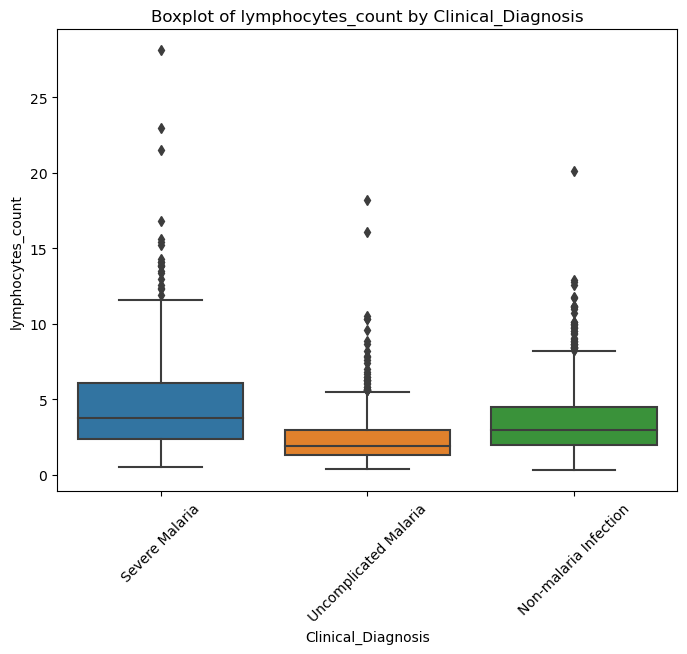

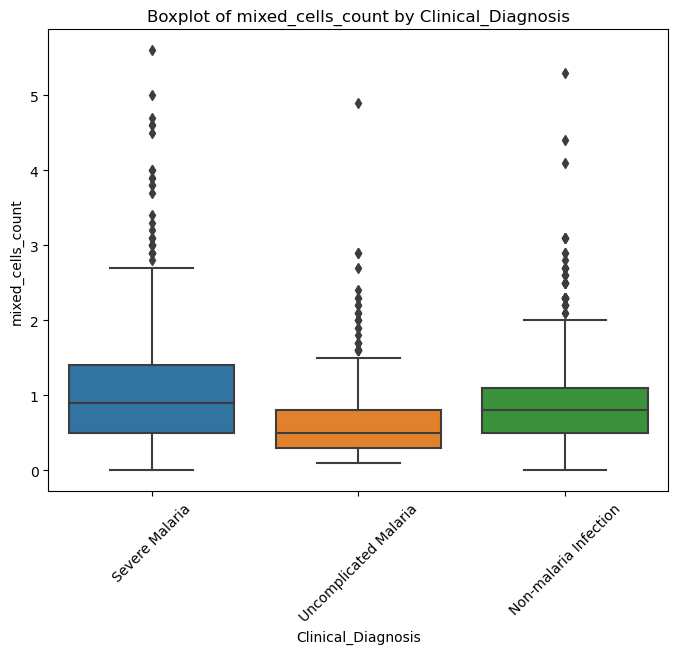

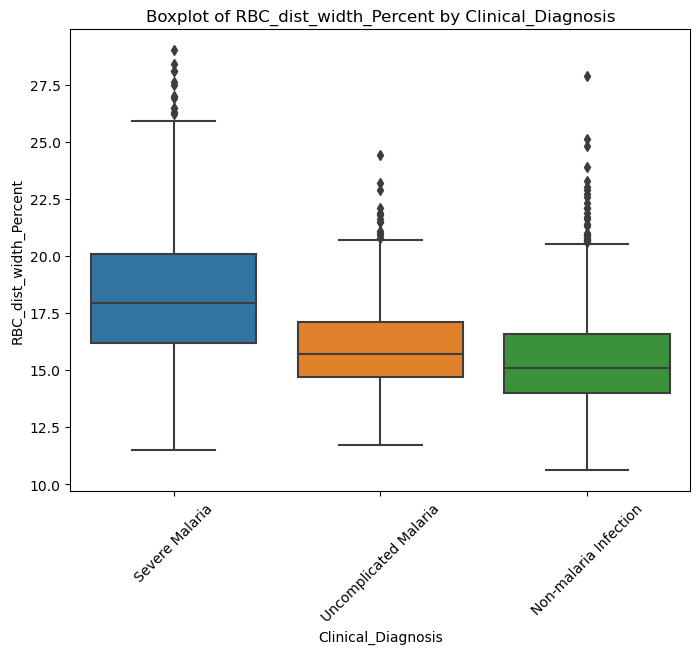

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of numerical columns
numericals_cols = ['wbc_count', 'rbc_count', 'hb_level', 'hematocrit',
                   'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
                   'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
                   'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
                   'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
                   'RBC_dist_width_Percent']

# Visualize each numerical column against the target variable
for col in numericals_cols:
    plt.figure(figsize=(8, 6))
    sns.boxplot(data=subset, x='Clinical_Diagnosis', y=col)
    plt.title(f'Boxplot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()


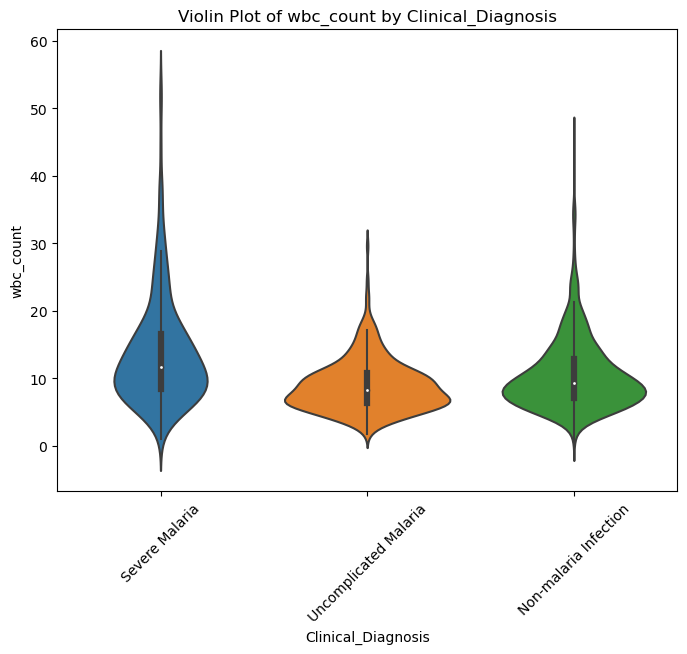

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


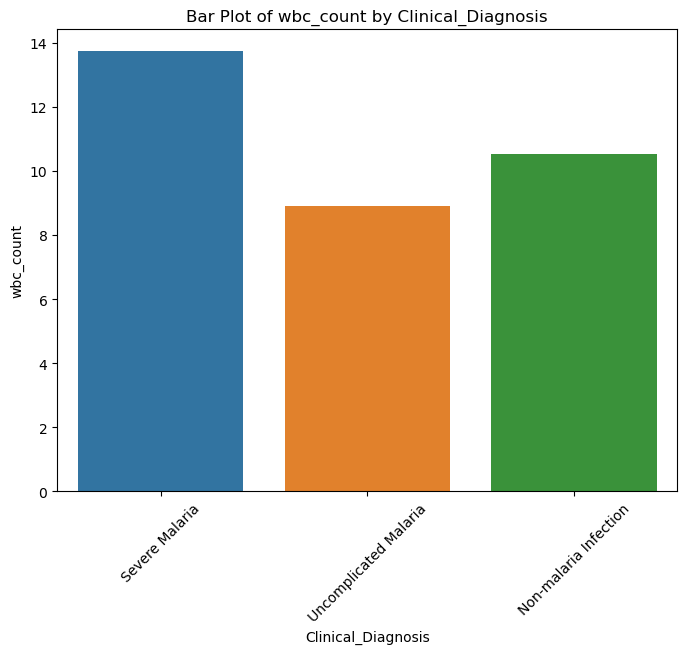

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 37.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 41.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 12.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 49.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 52.7% of the points cannot be placed; you may want to decrease the size of the marke

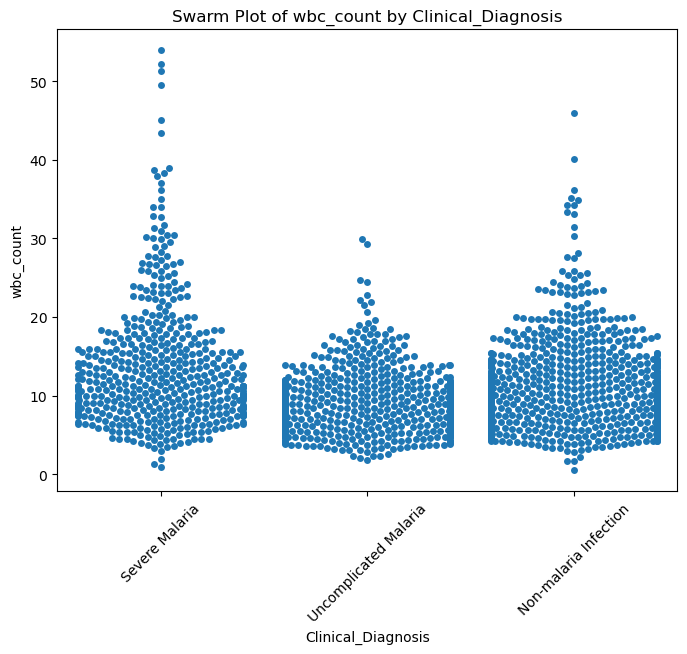

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


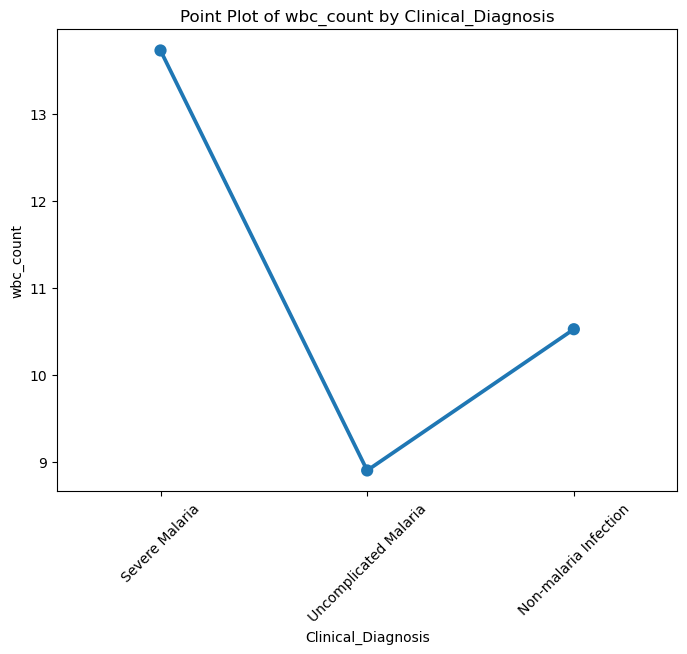

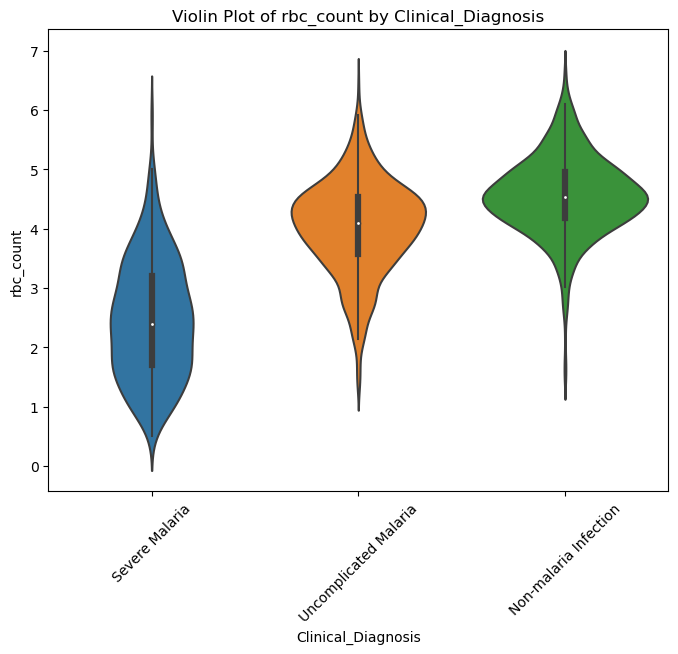

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


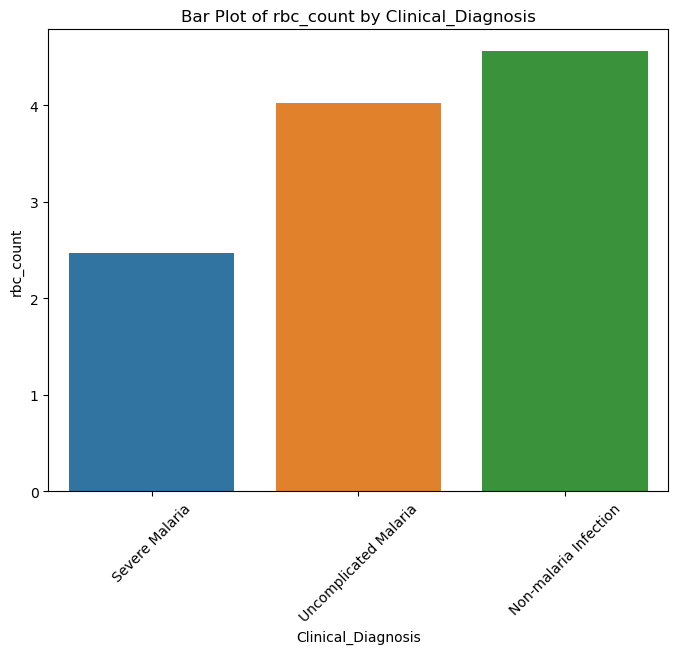

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 12.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 30.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 23.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 42.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


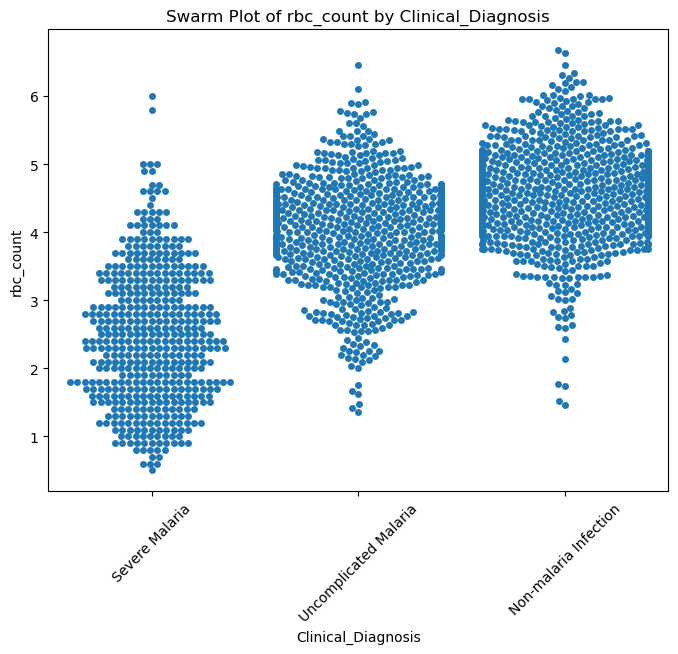

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


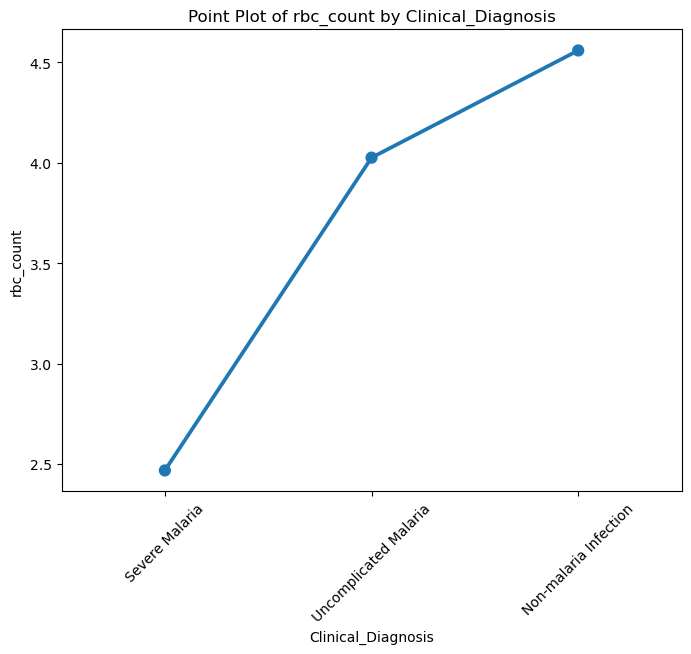

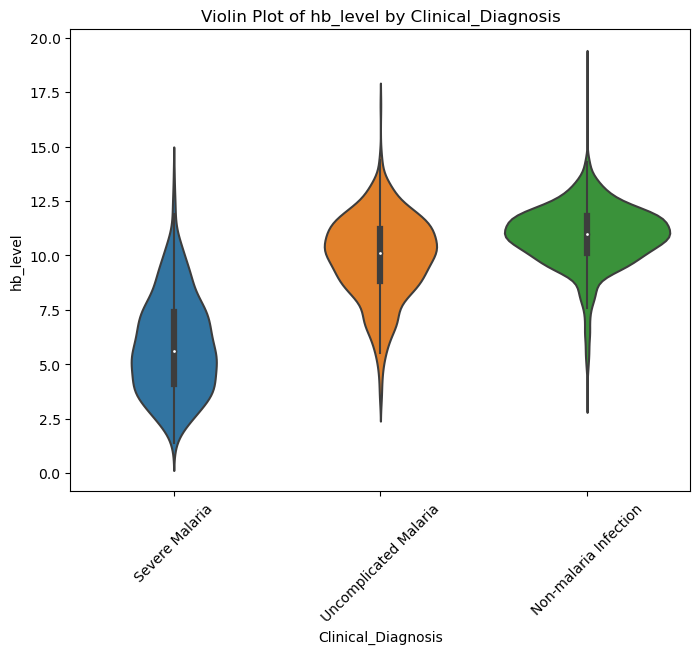

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


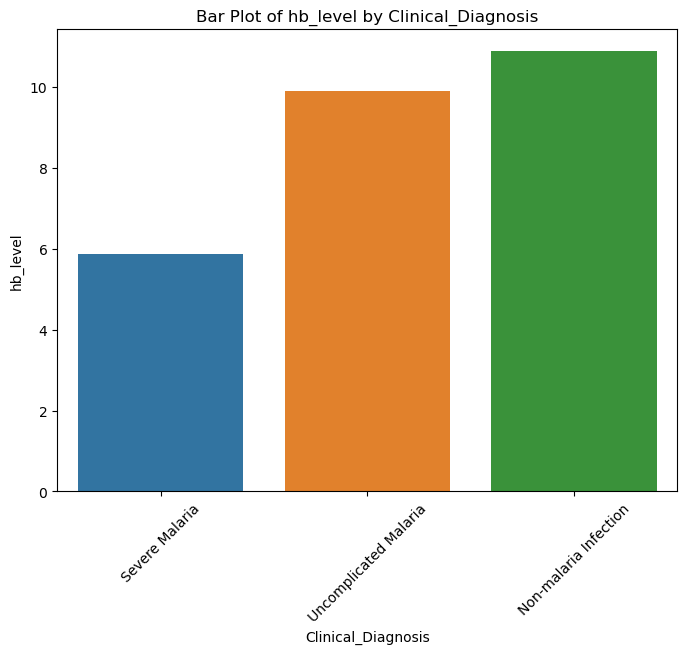

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 17.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 48.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 5.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 31.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 57.8% of the points cannot be placed; you may want to decrease the size of the marker

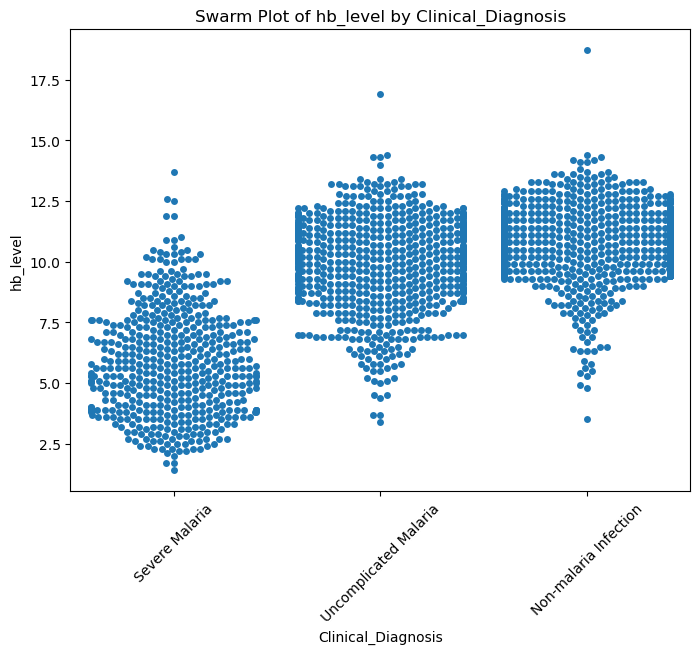

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


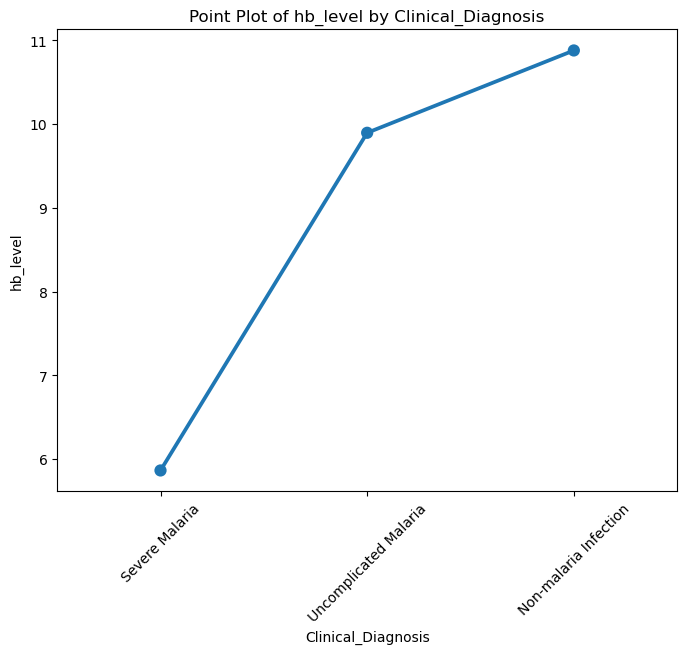

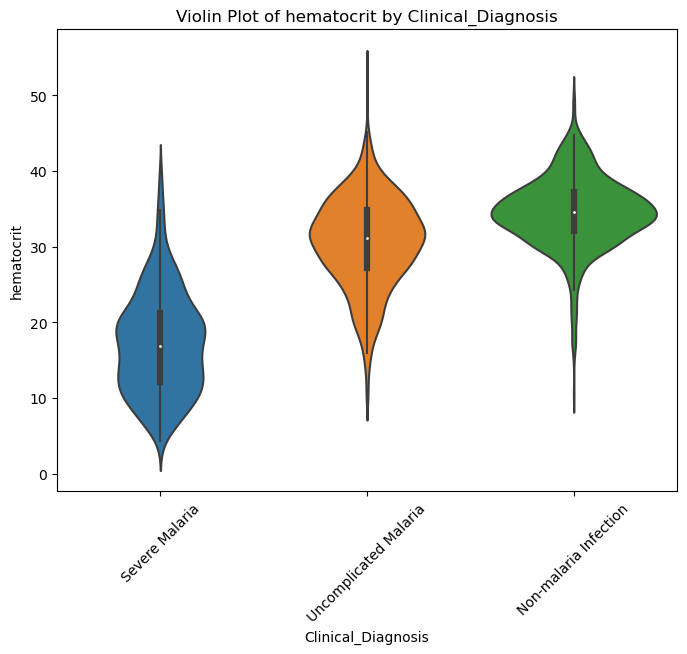

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


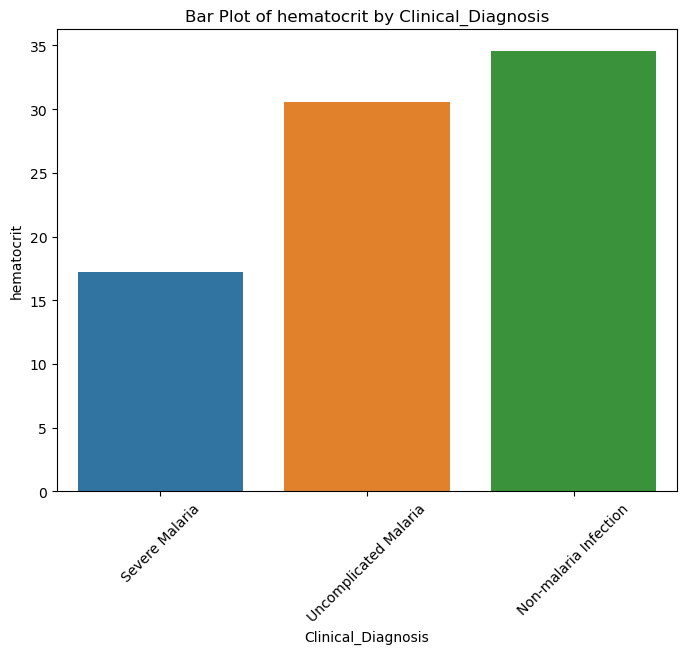

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 9.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 36.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 23.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 46.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


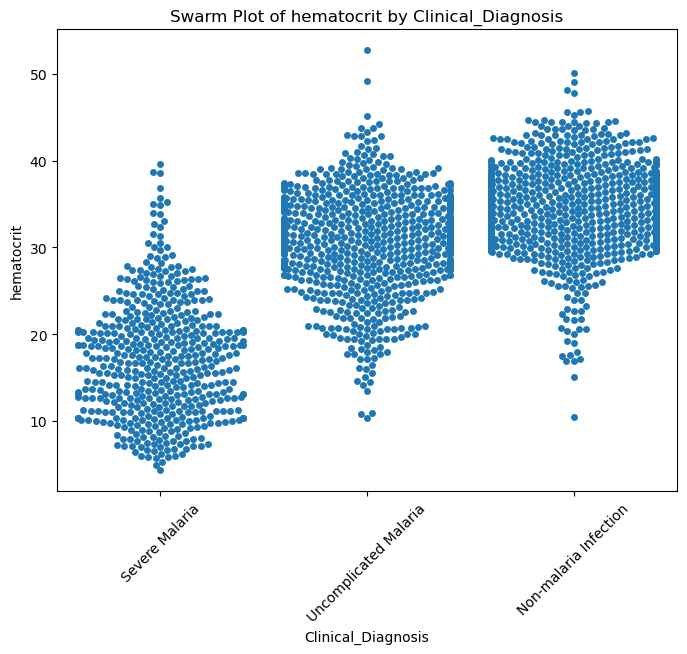

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


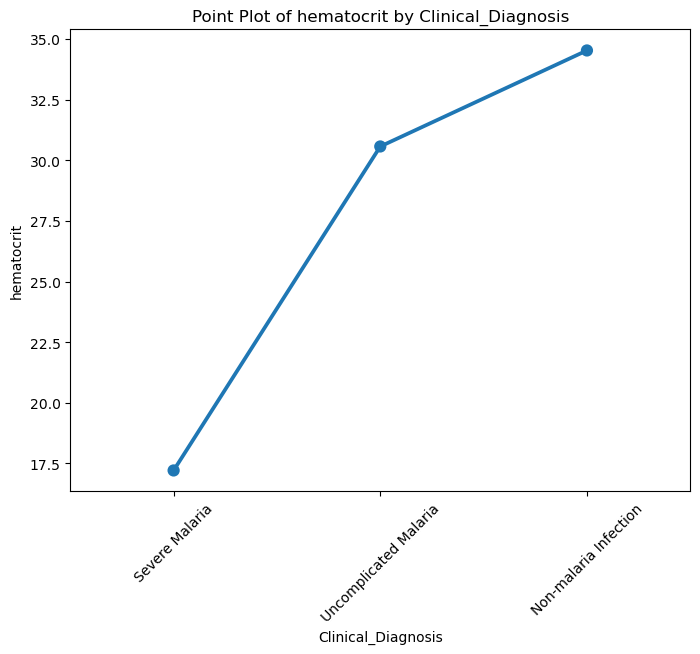

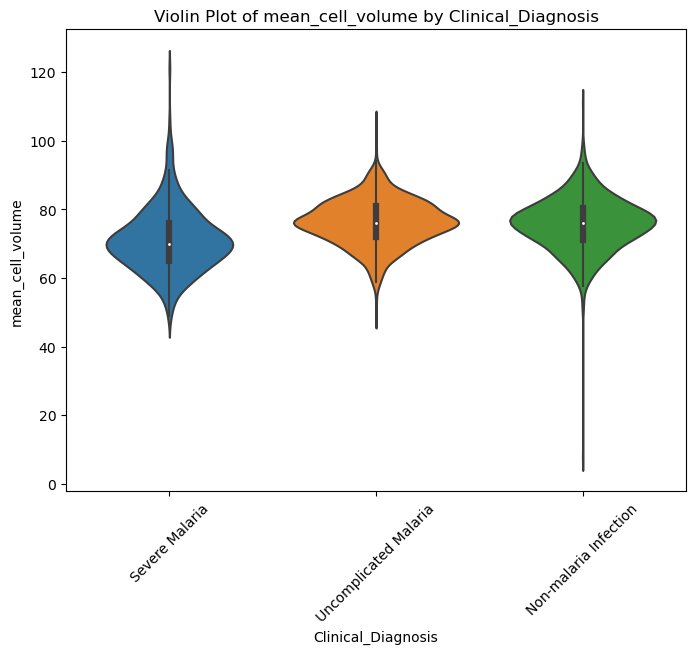

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


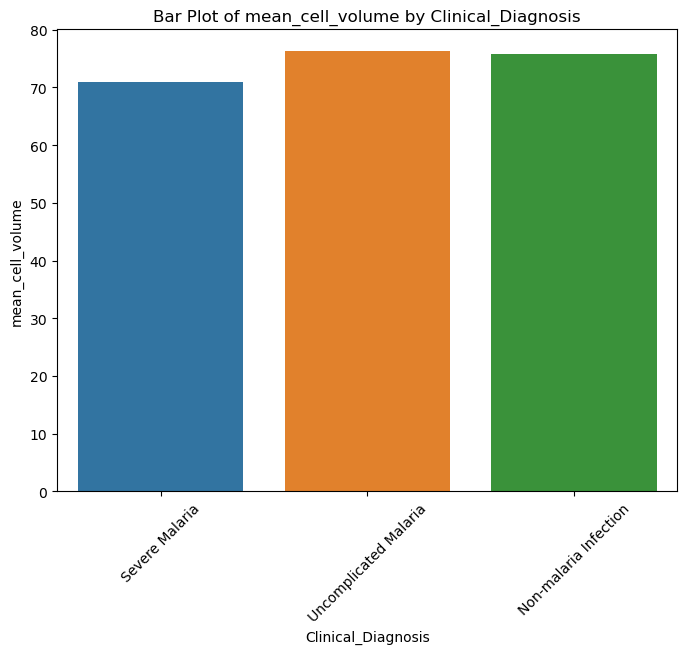

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 18.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 43.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 47.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 31.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 54.6% of the points cannot be placed; you may want to decrease the size of the marke

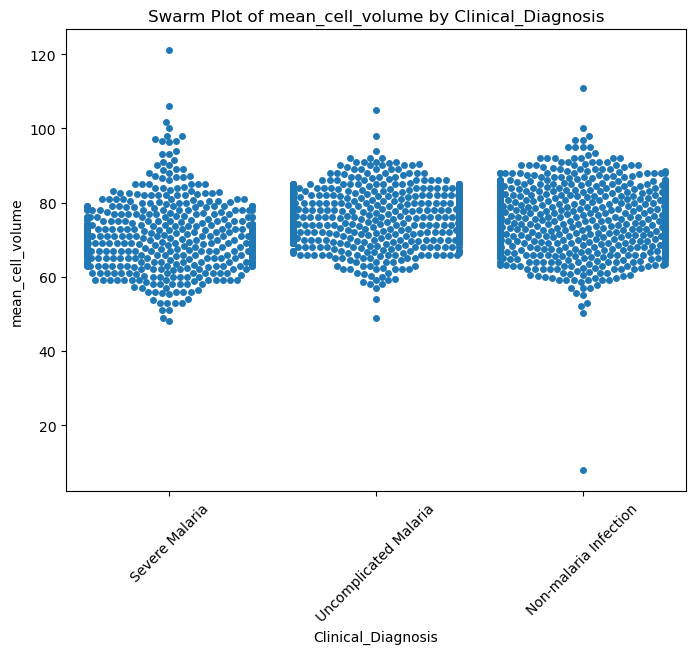

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


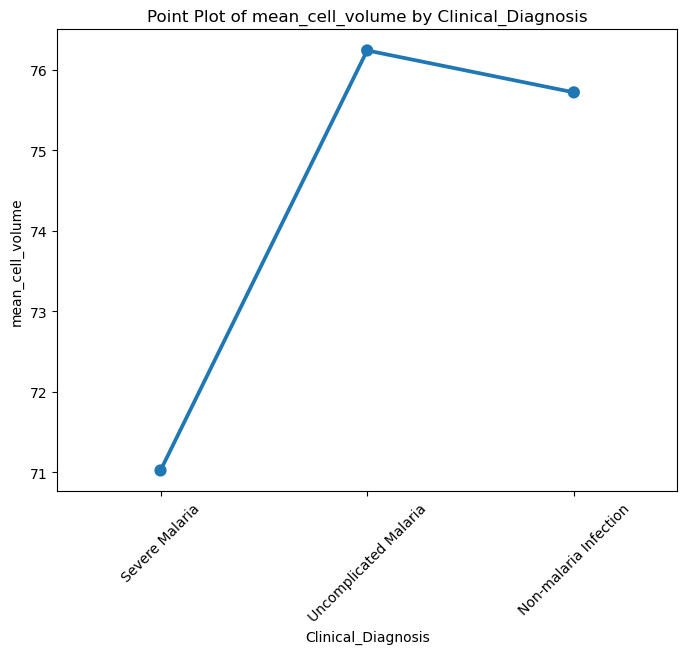

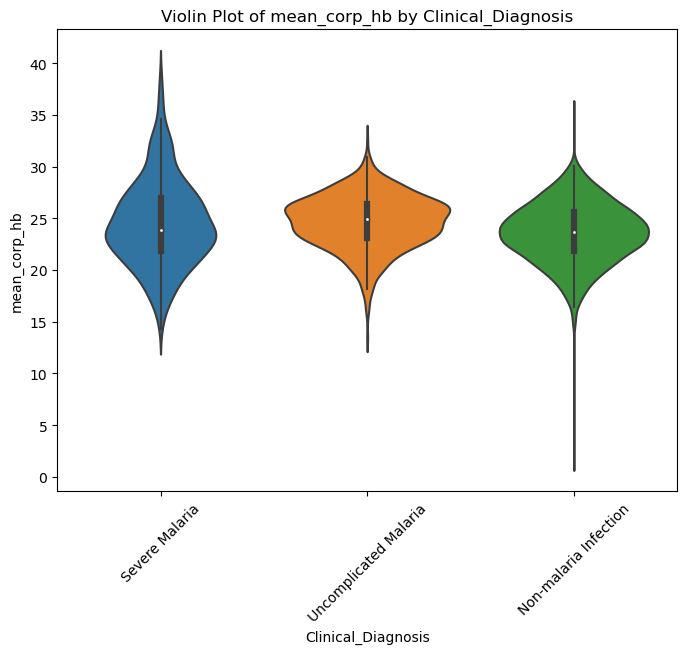

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


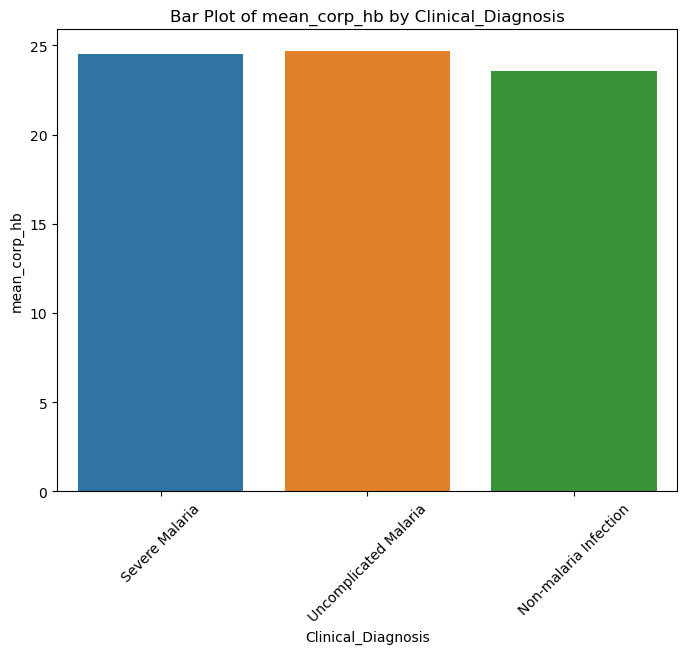

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 32.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 40.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 12.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 45.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 52.4% of the points cannot be placed; you may want to decrease the size of the marke

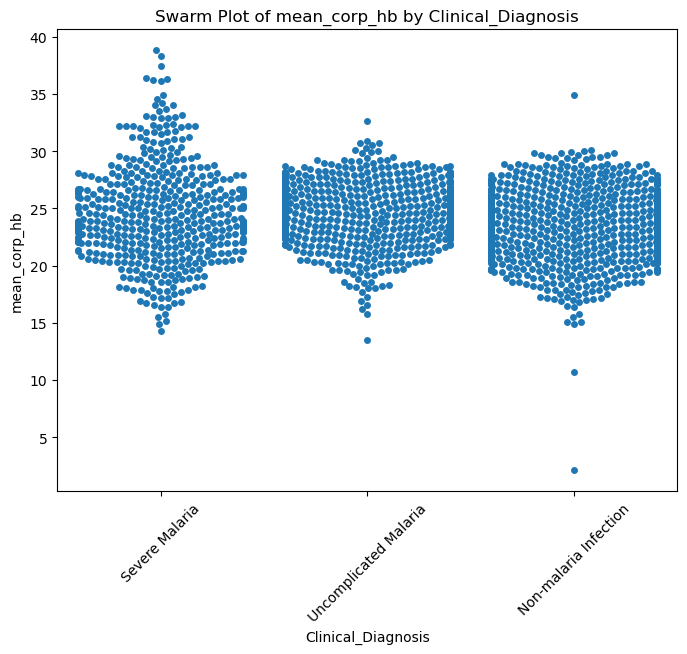

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


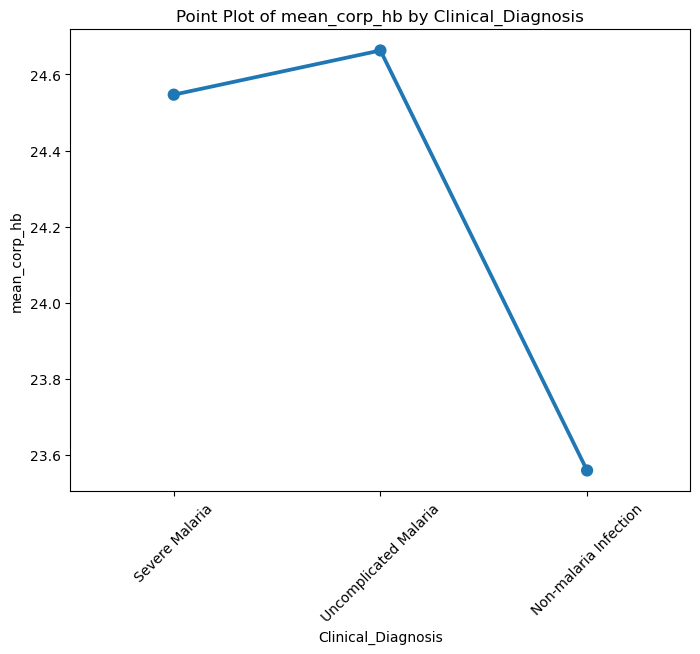

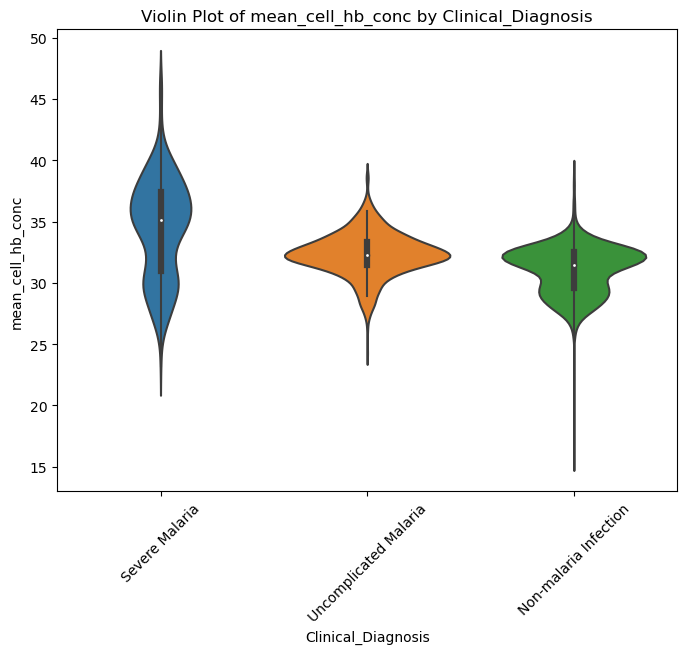

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


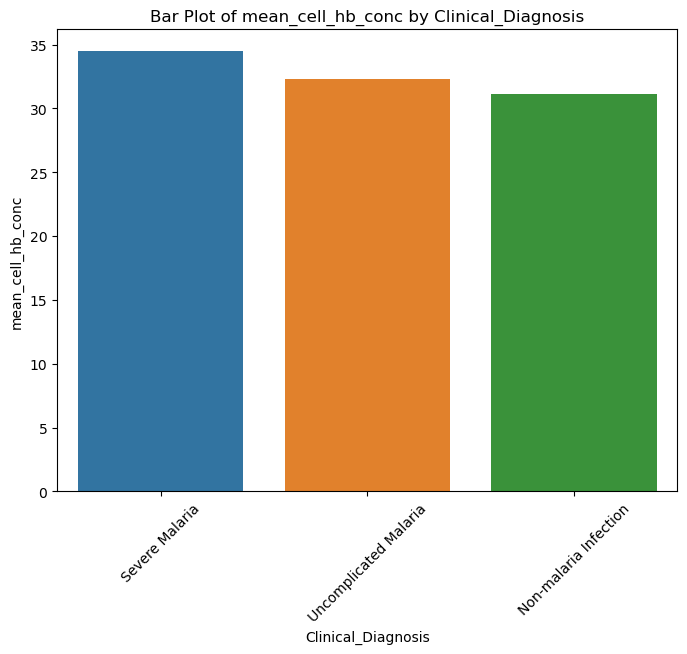

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 43.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 52.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 9.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 52.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 62.9% of the points cannot be placed; you may want to decrease the size of the marker

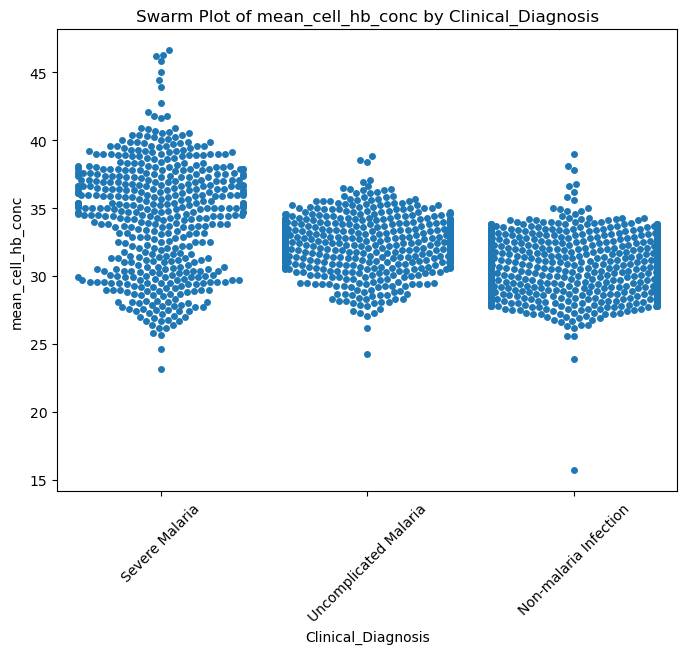

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


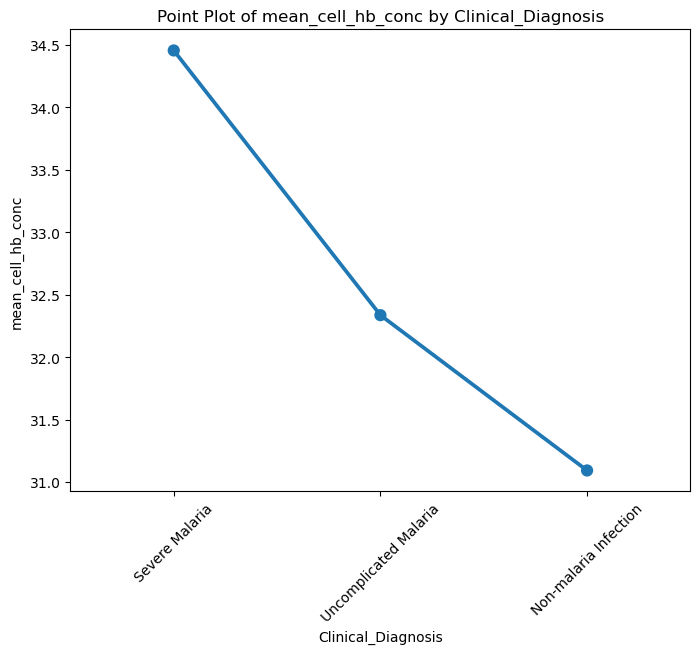

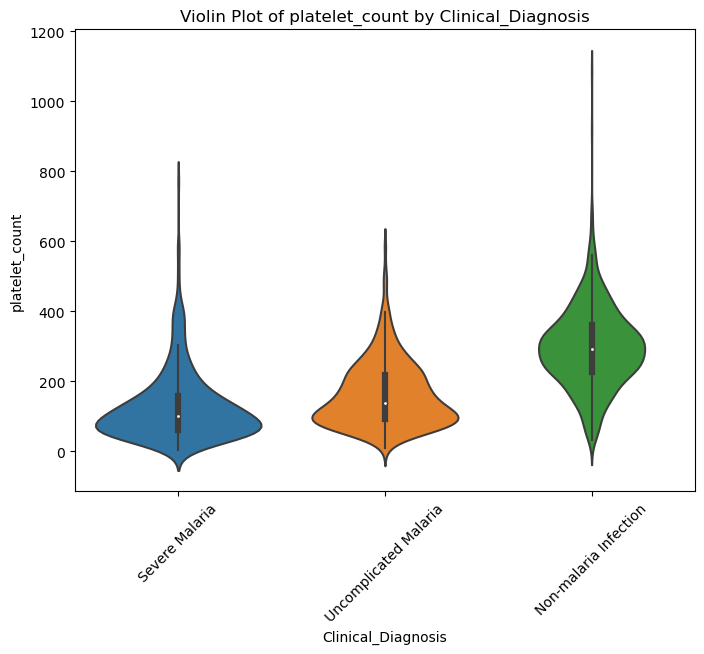

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


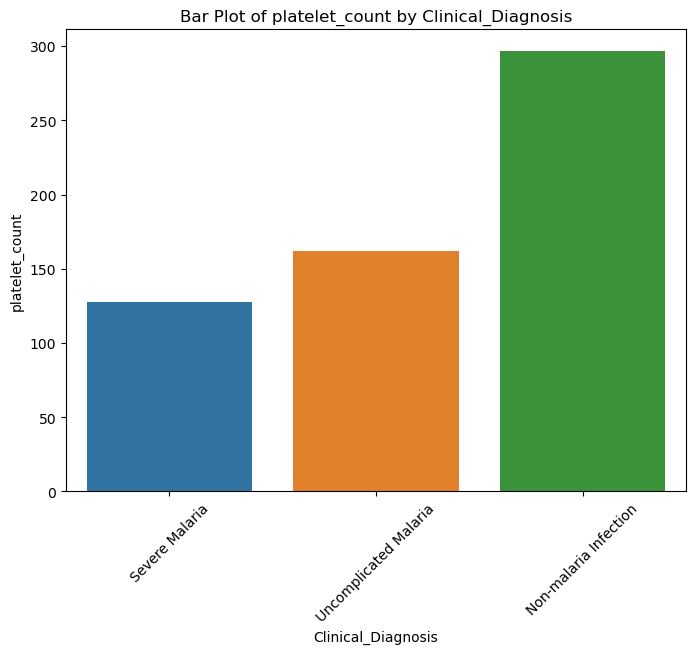

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 23.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 29.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 29.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 34.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 43.2% of the points cannot be placed; you may want to decrease the size of the marke

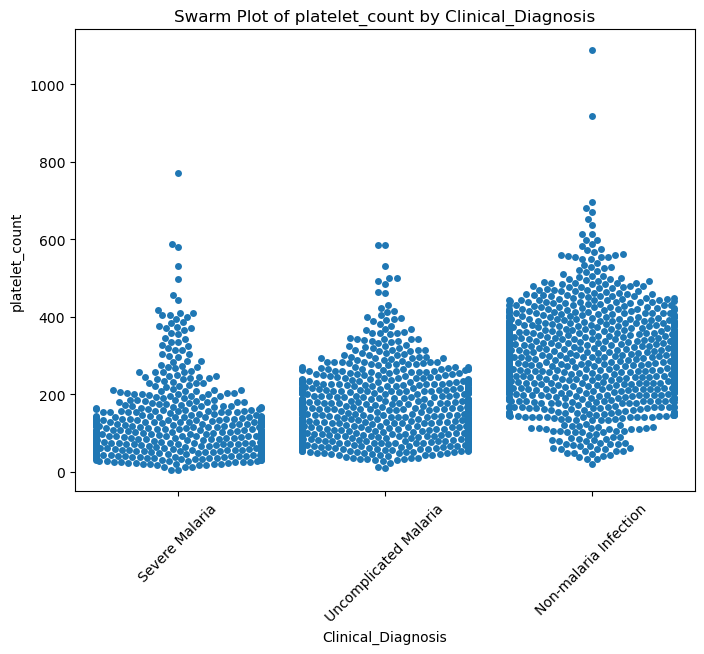

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


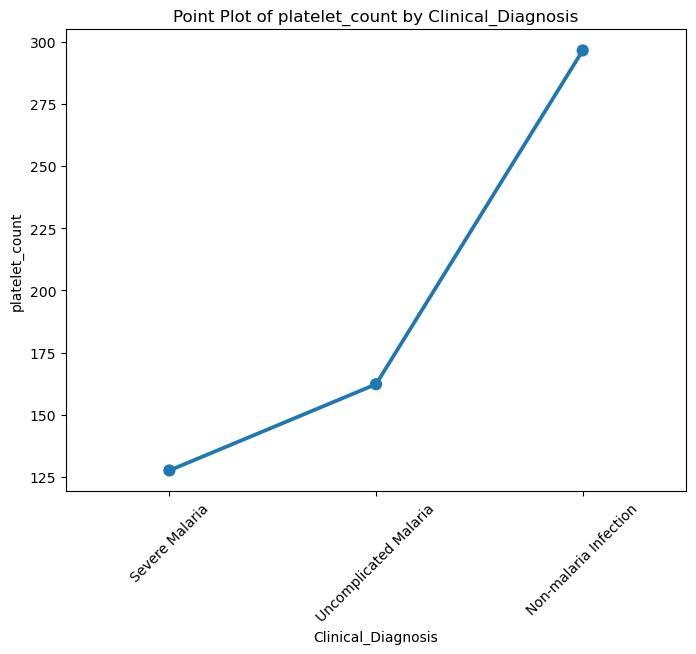

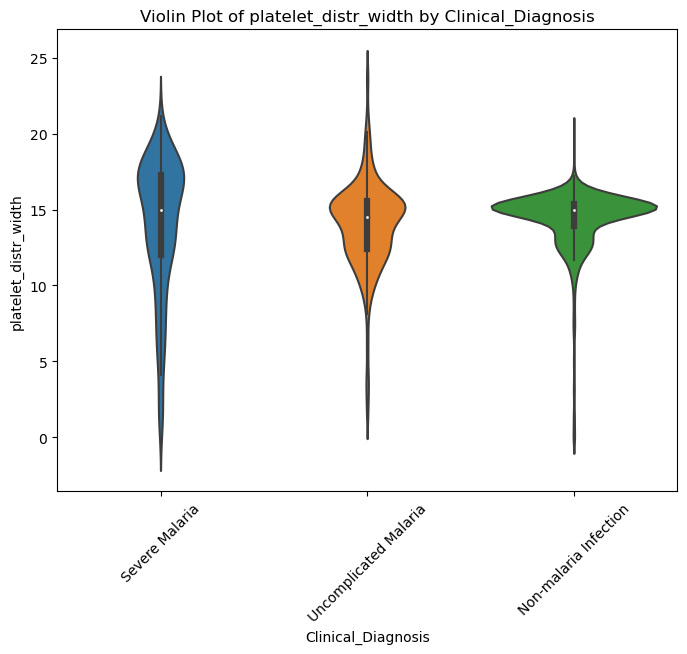

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


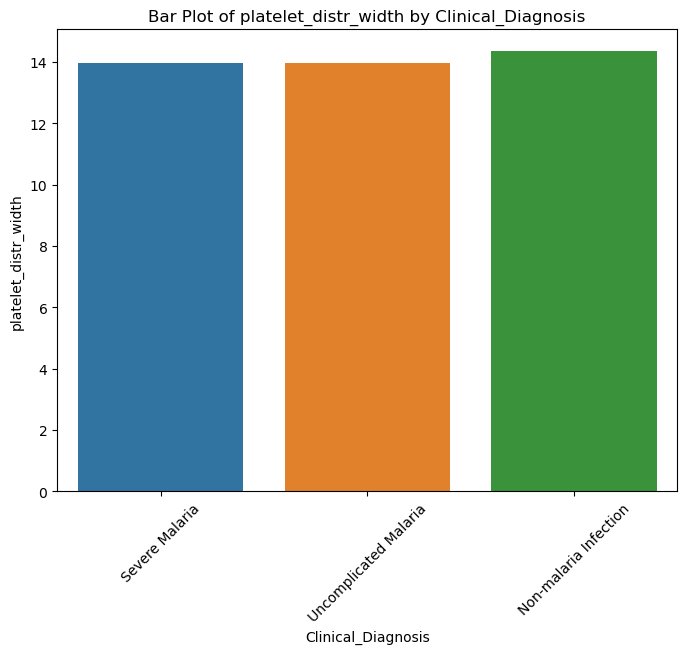

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 20.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 56.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 9.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 33.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 63.9% of the points cannot be placed; you may want to decrease the size of the marker

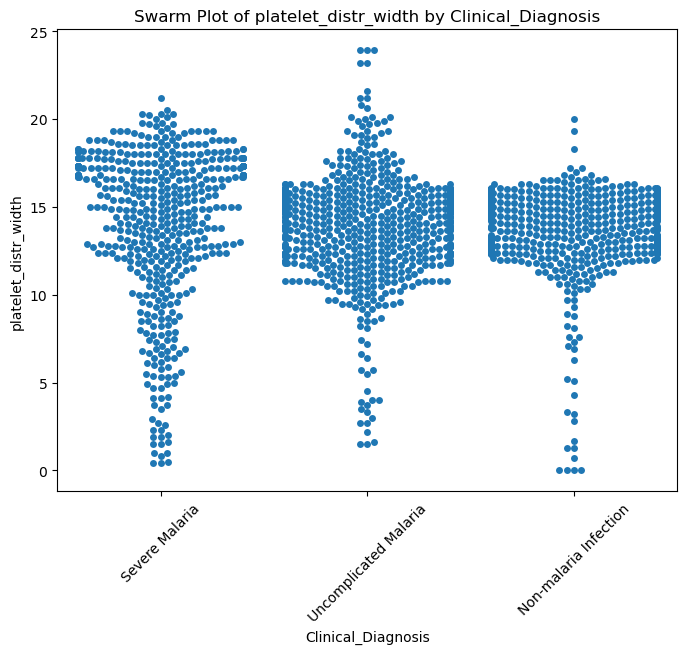

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


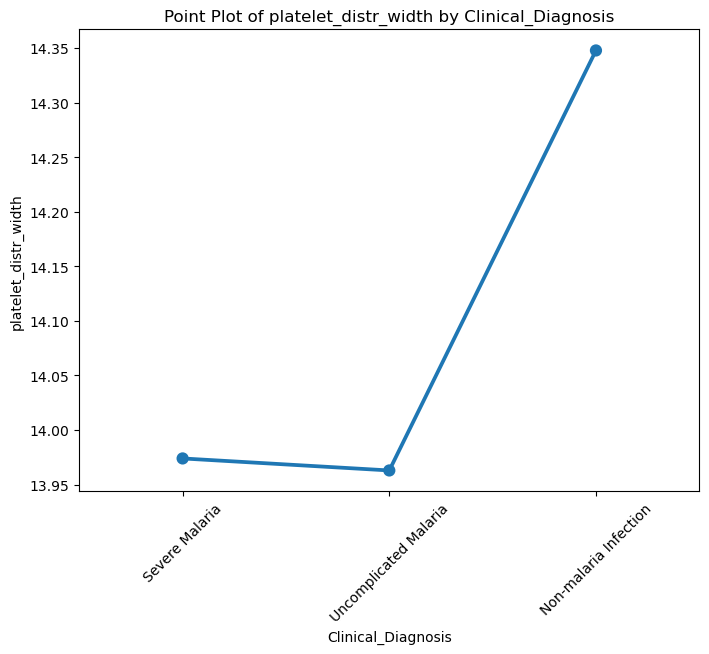

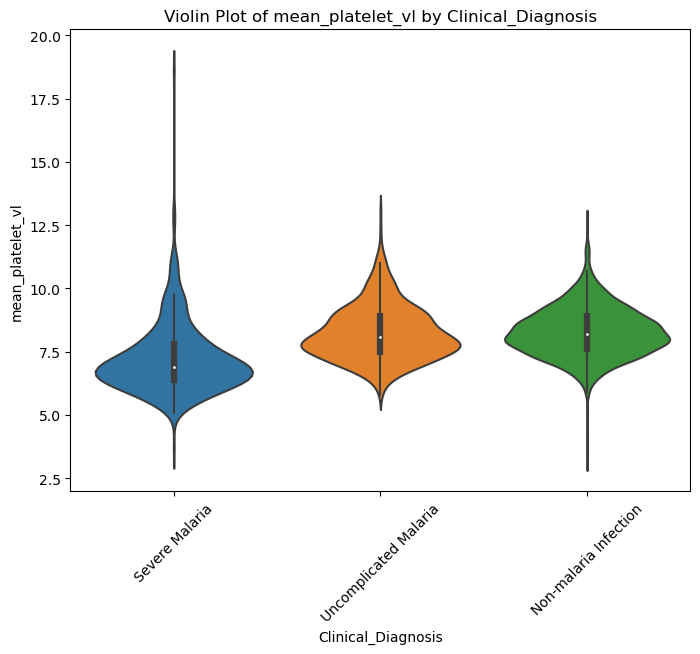

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


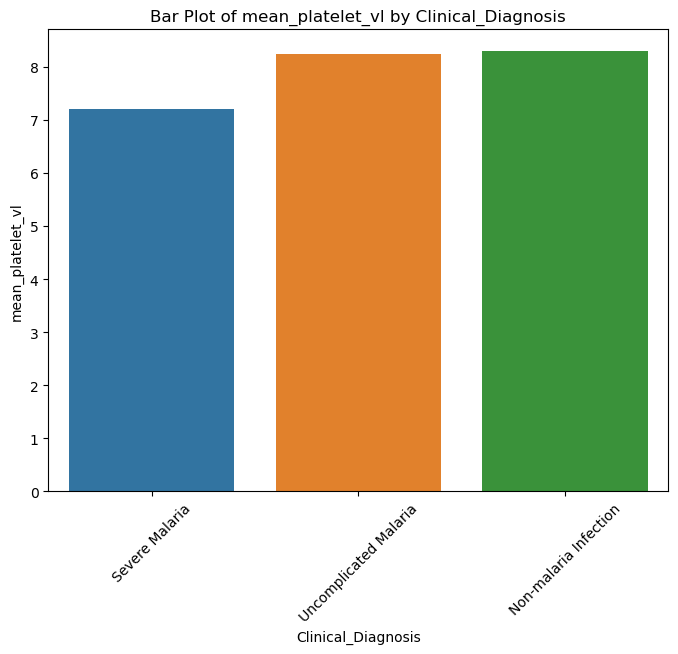

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 40.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 55.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 38.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 53.0% of the points cannot be placed; you may want to decrease the size of the marke

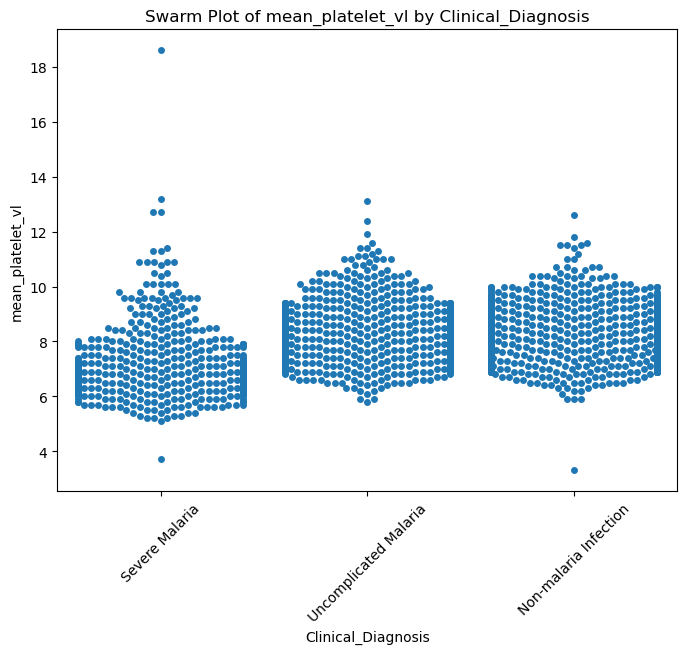

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


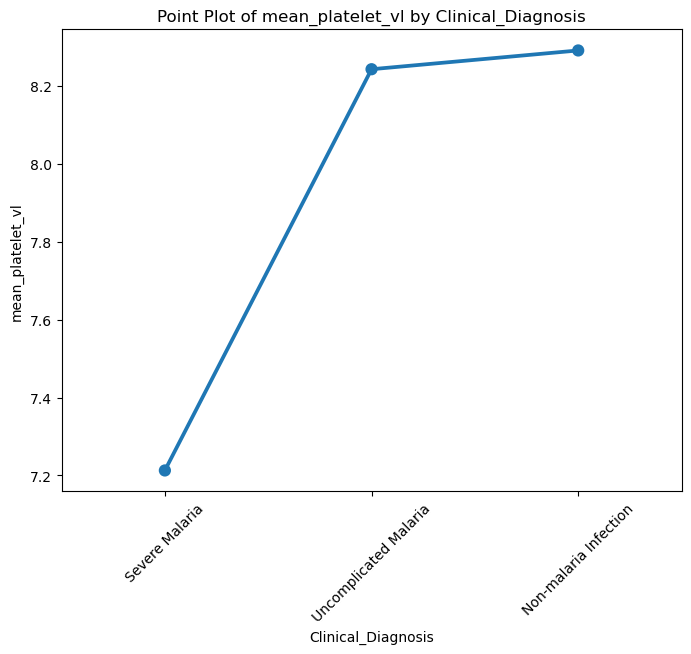

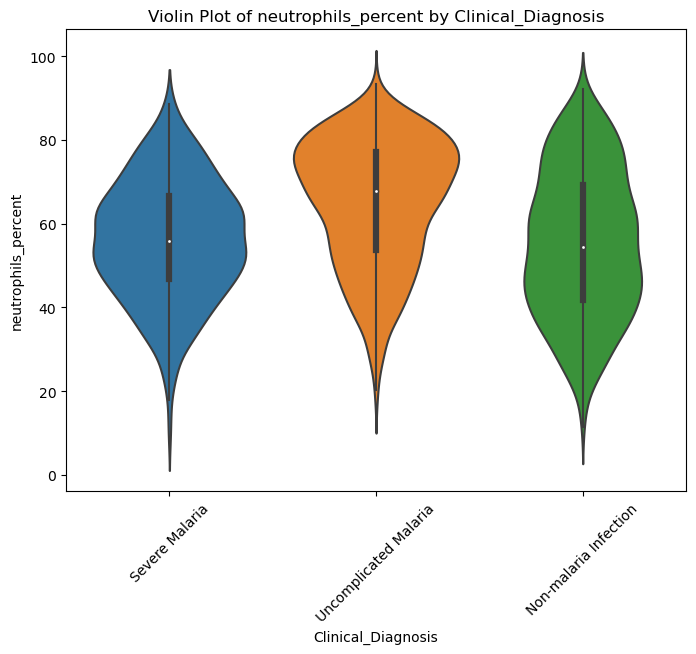

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


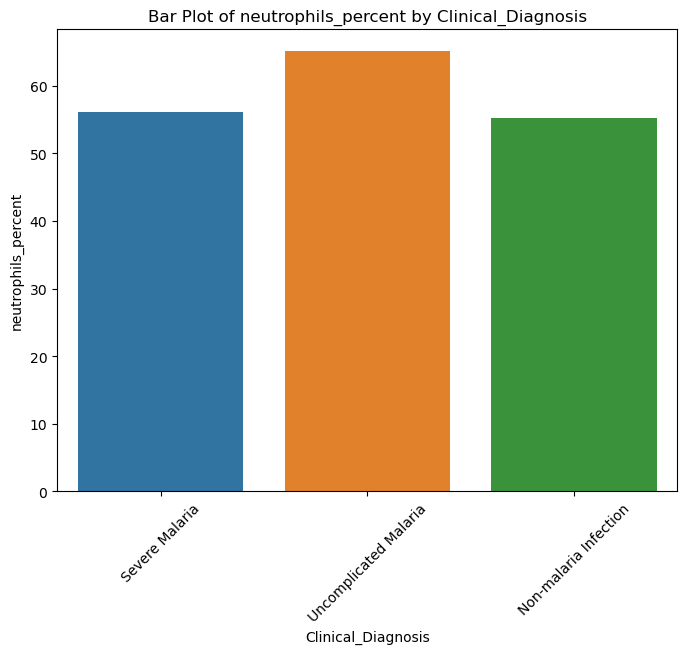

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 8.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 9.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


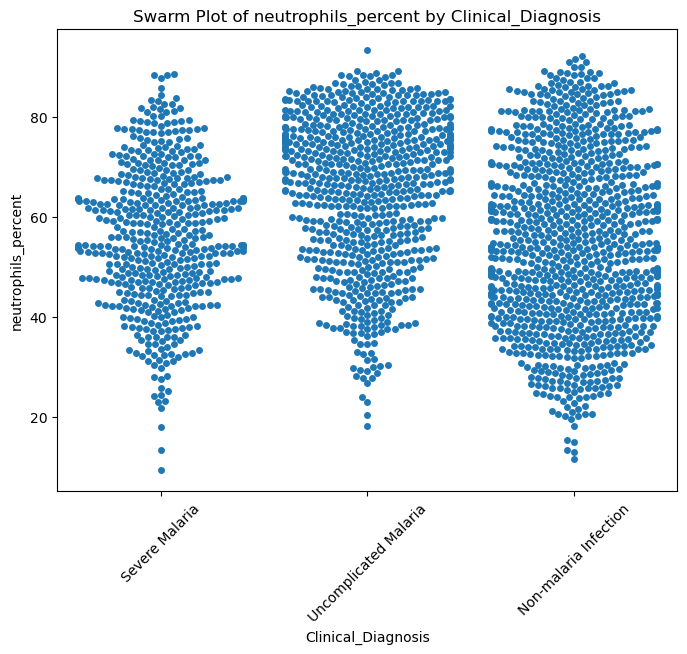

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


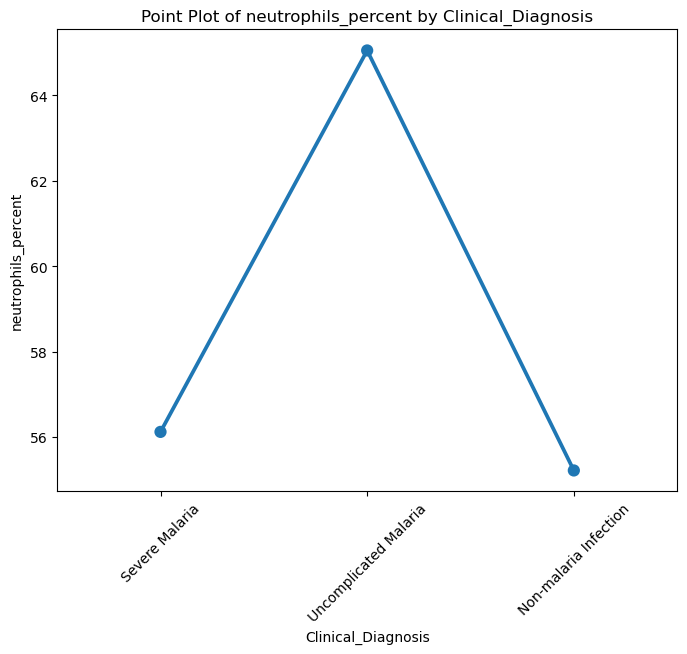

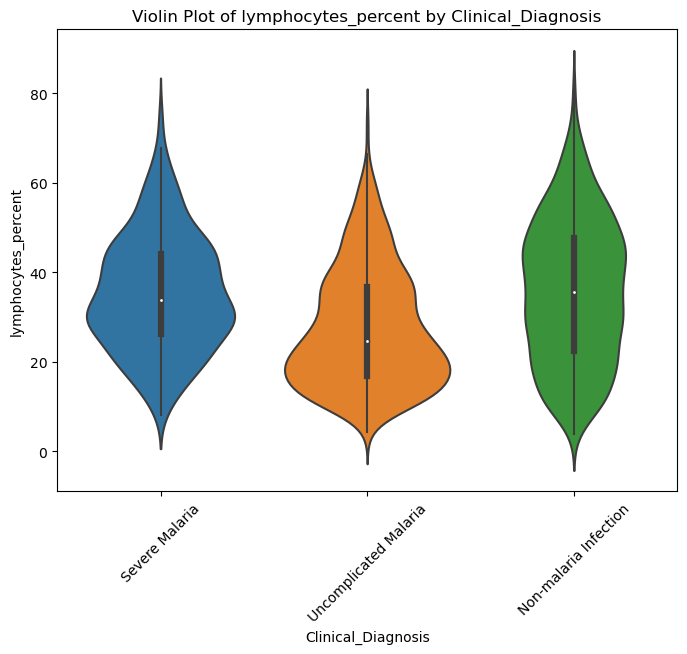

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


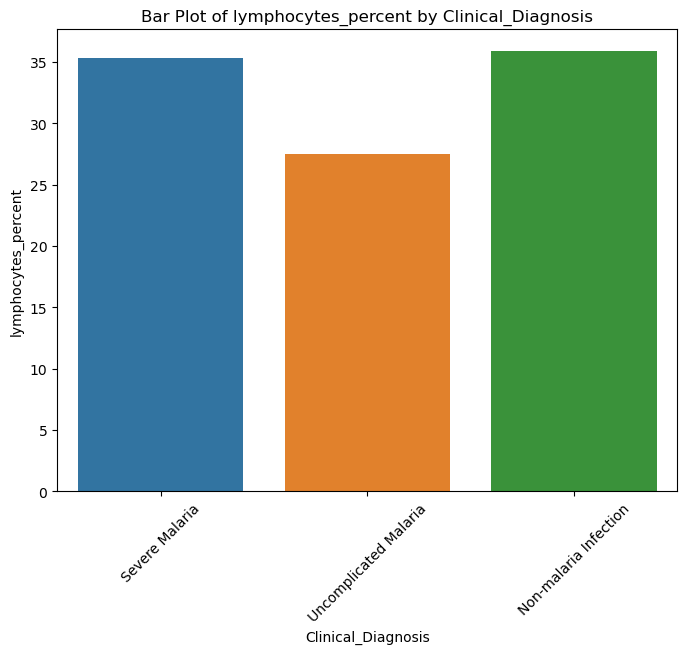

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 11.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 10.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


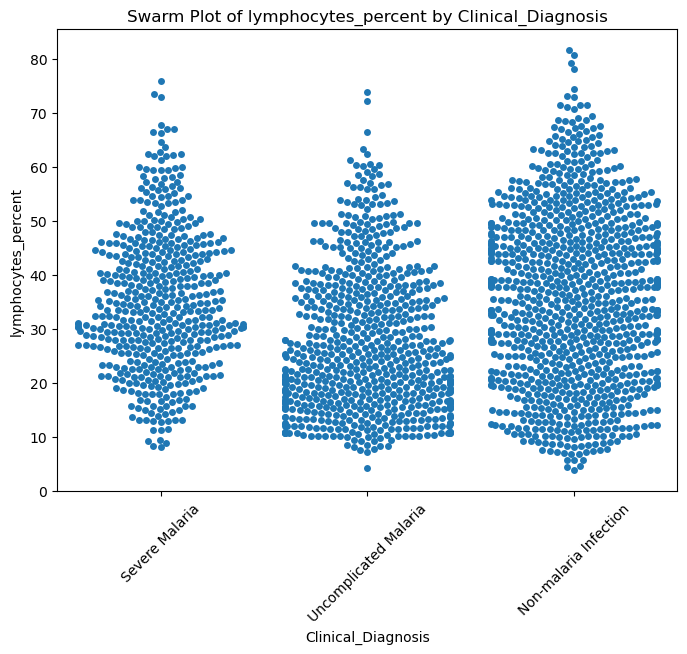

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


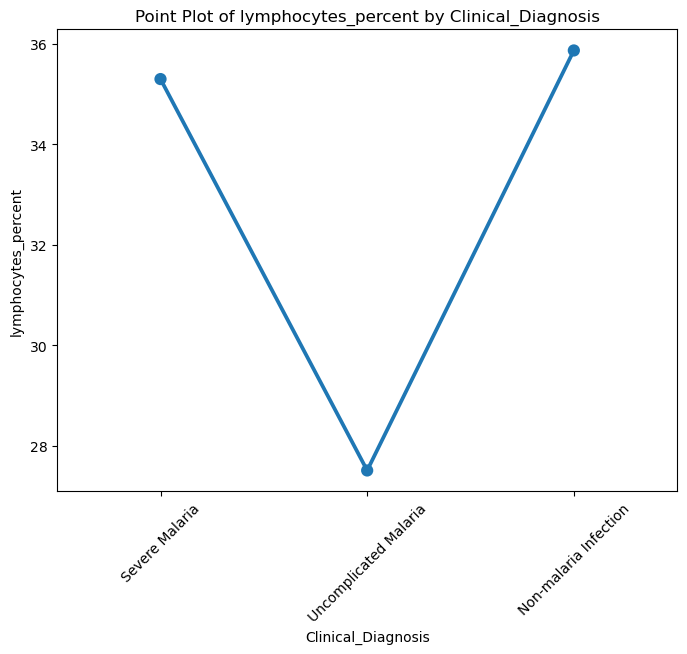

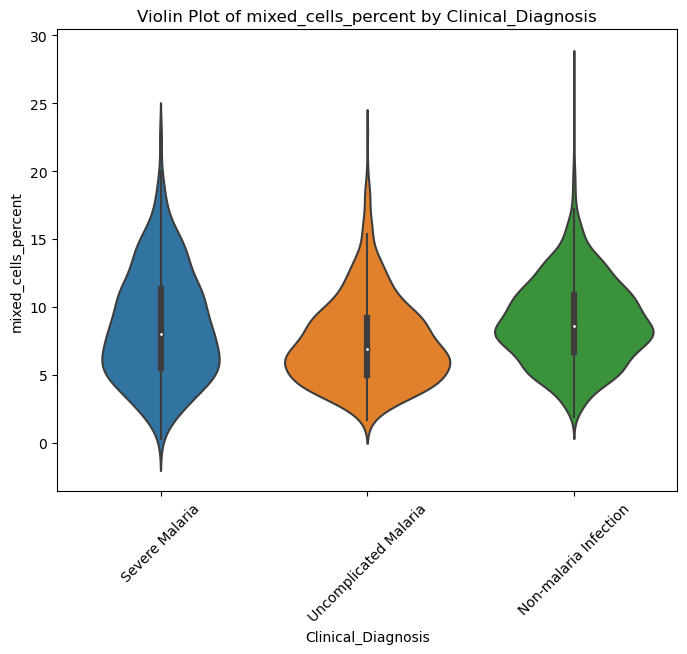

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


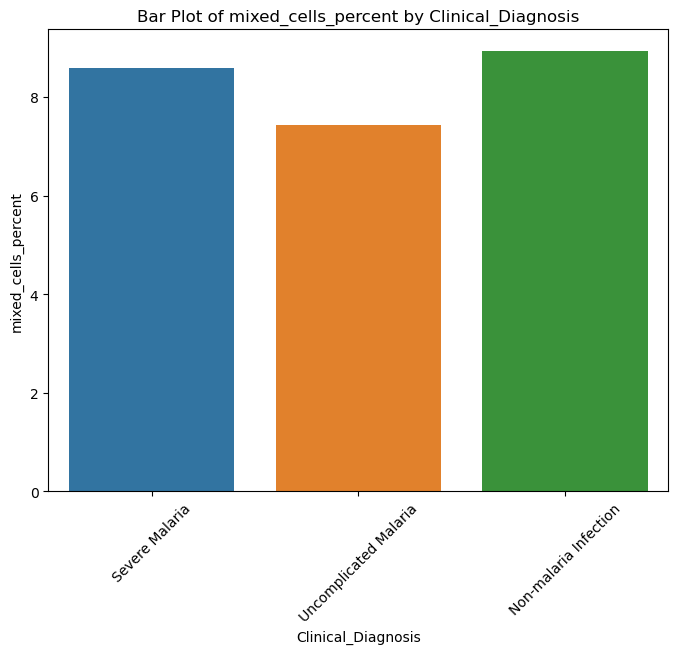

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 15.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 24.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 29.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 39.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


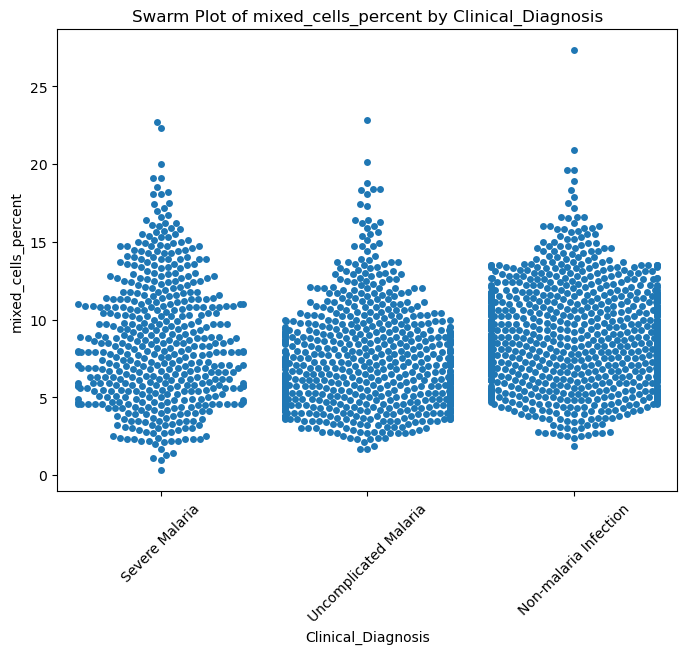

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


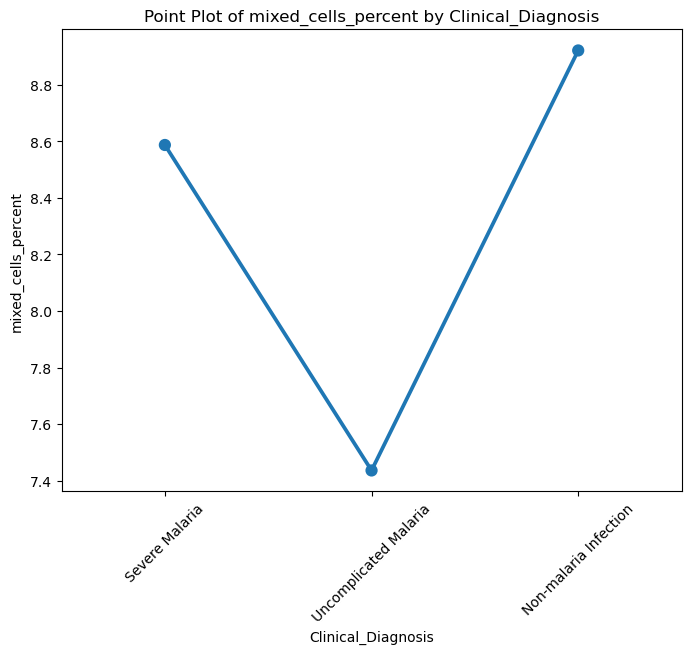

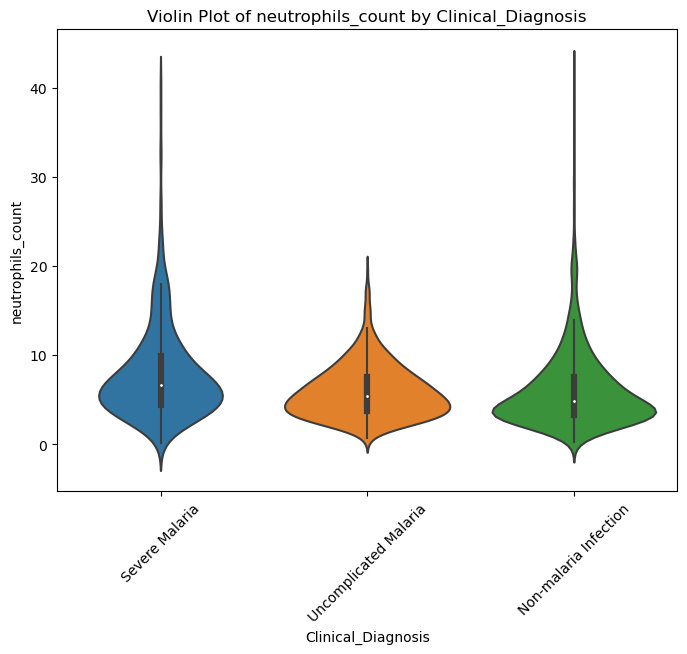

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


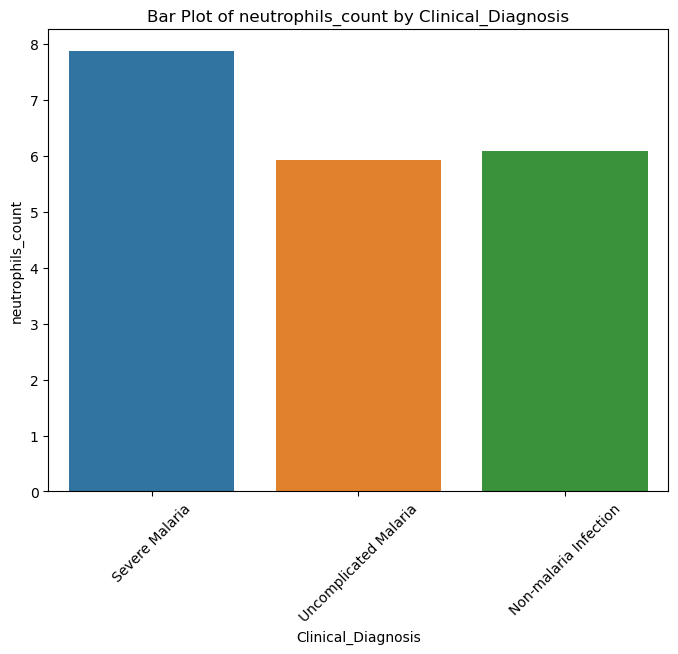

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 10.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 36.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 44.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 23.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 50.1% of the points cannot be placed; you may want to decrease the size of the marke

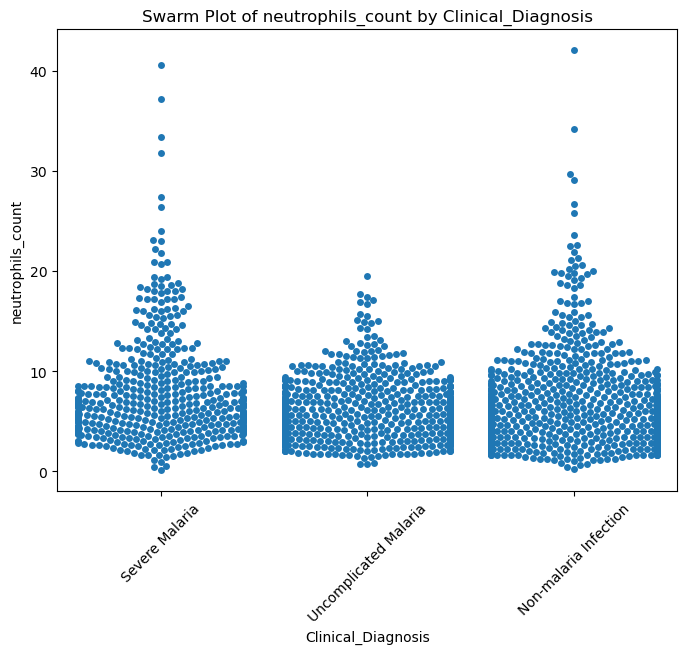

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


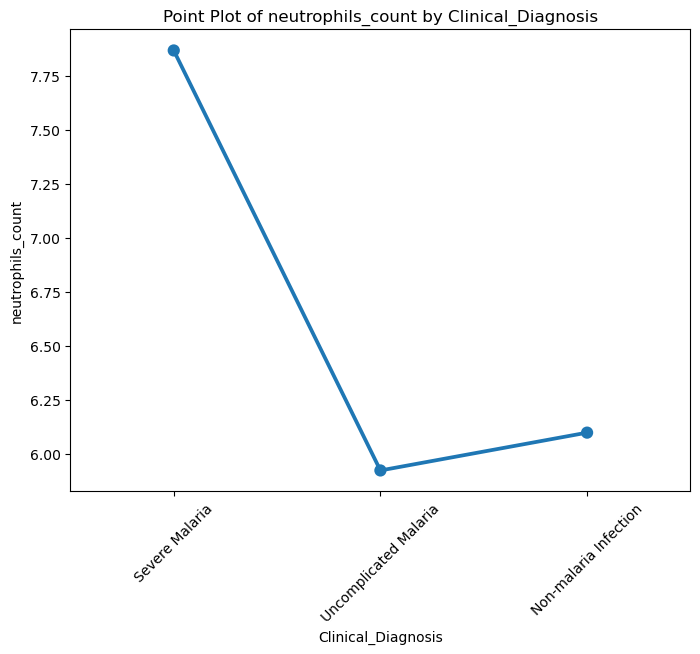

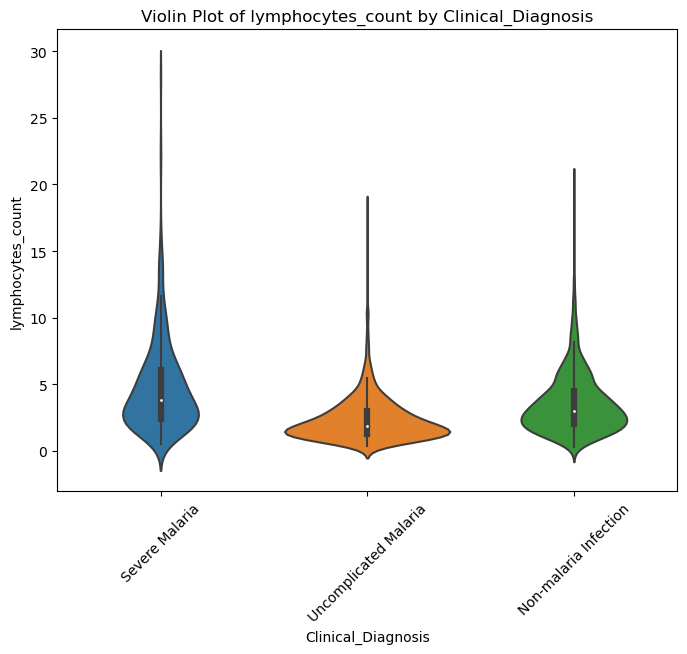

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


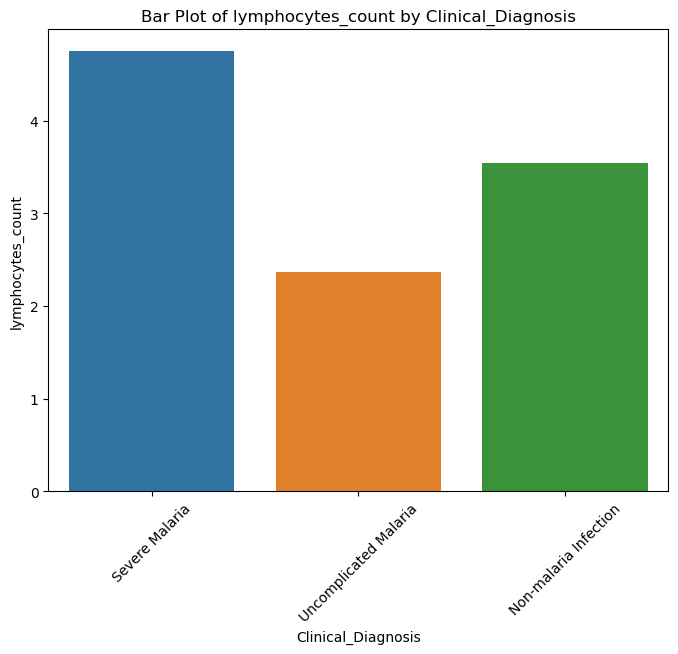

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 11.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 50.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 48.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 24.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 61.7% of the points cannot be placed; you may want to decrease the size of the marke

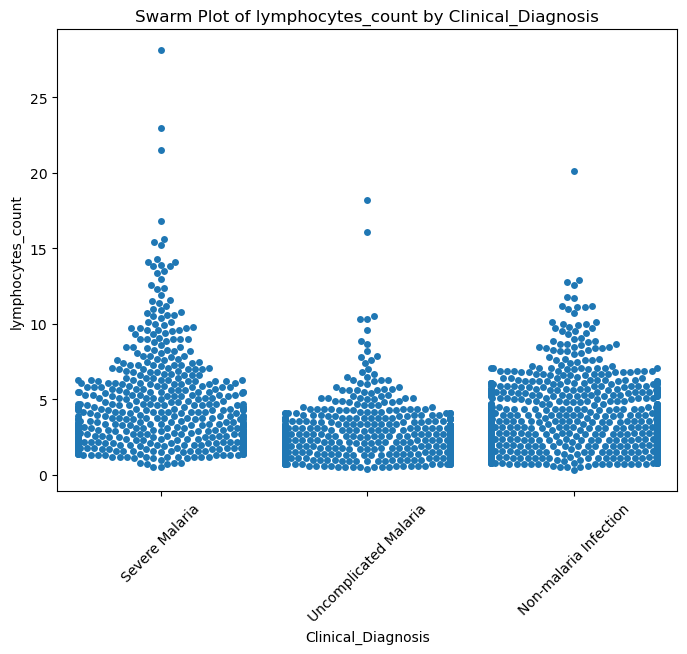

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


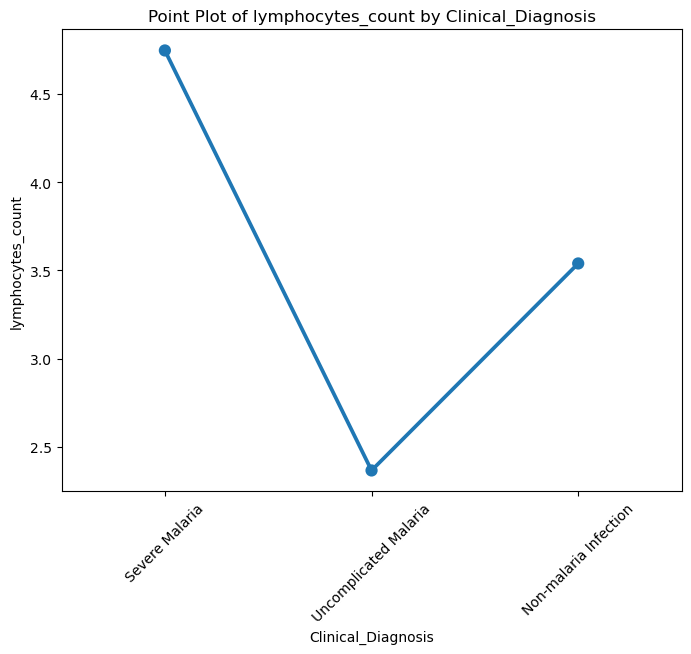

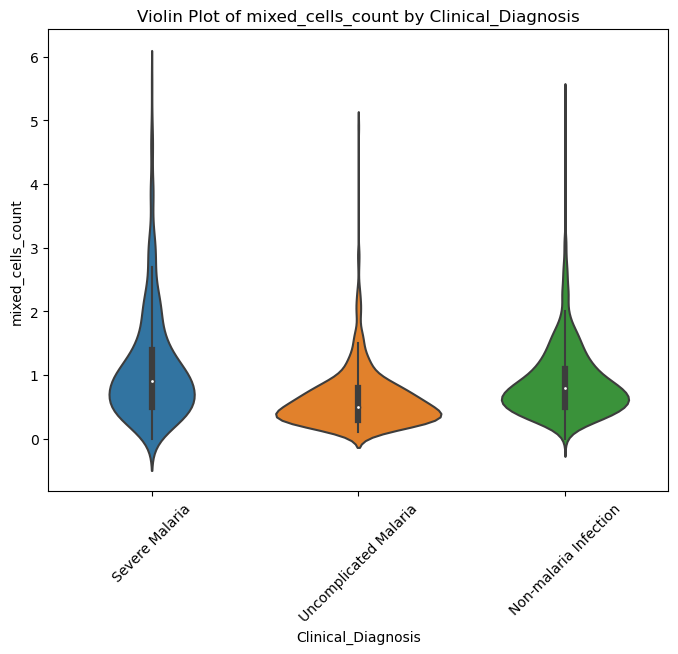

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


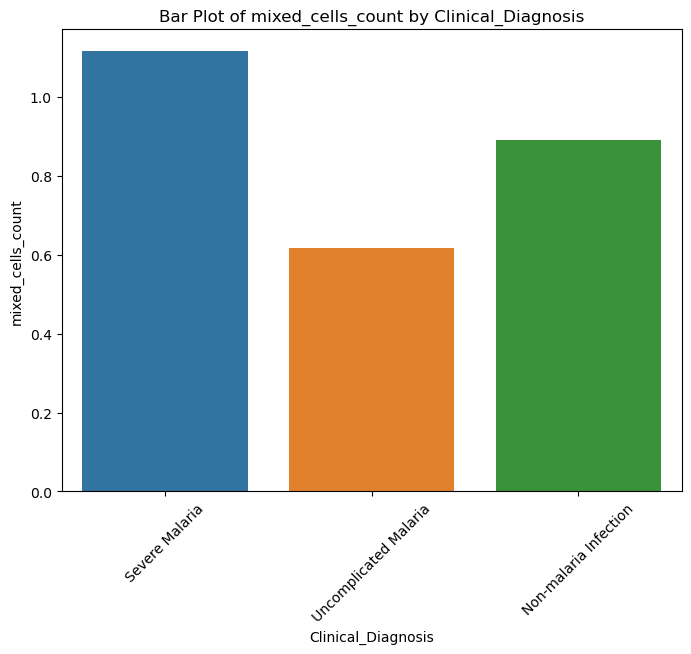

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 6.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 48.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 45.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 19.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 57.1% of the points cannot be placed; you may want to decrease the size of the marker

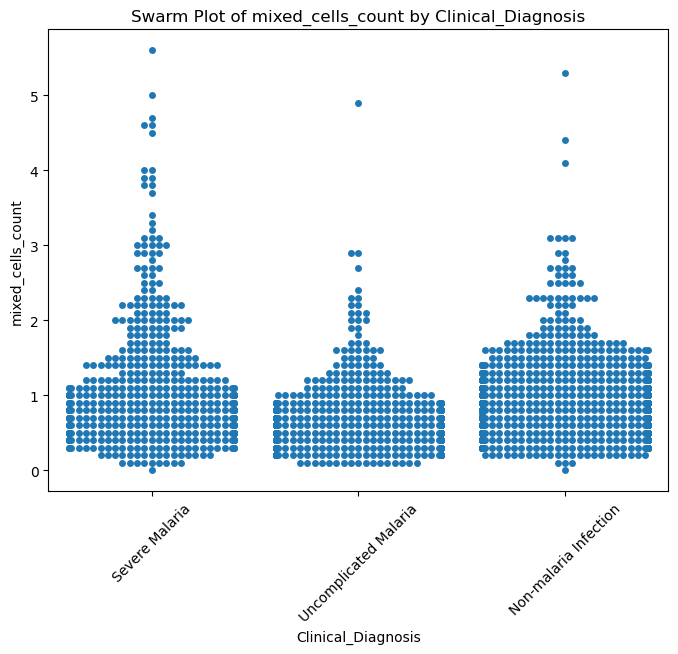

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


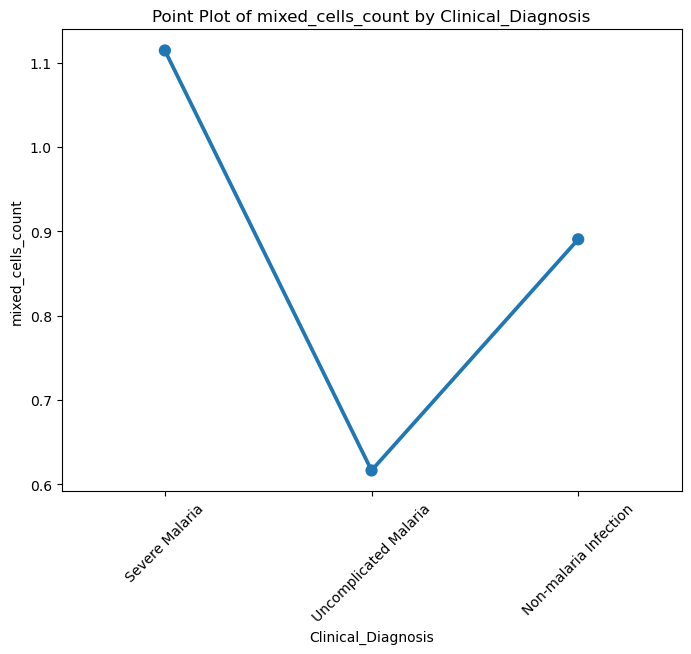

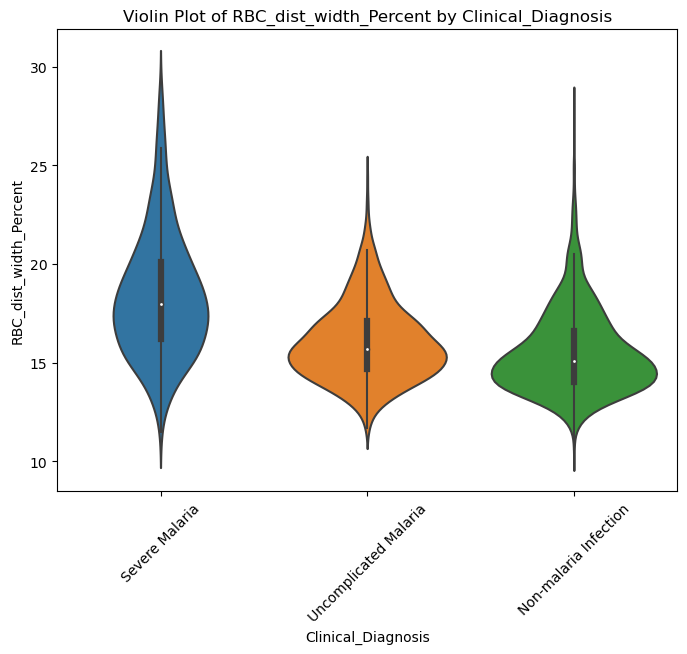

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


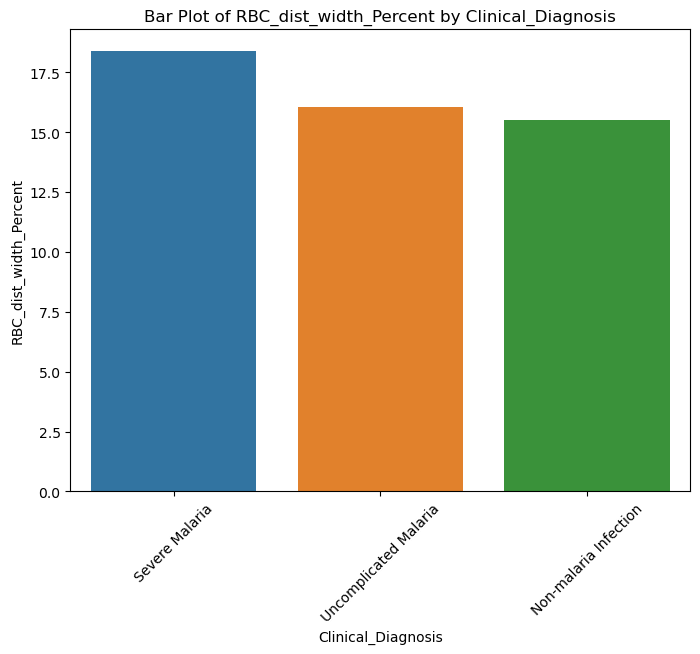

D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 16.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 30.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 30.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 43.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
D:\Anaconda\Lib\site-packages\seaborn\categorical.py:3544: UserWarning: 29.5% of the points cannot be placed; you may want to decrease the size of the marke

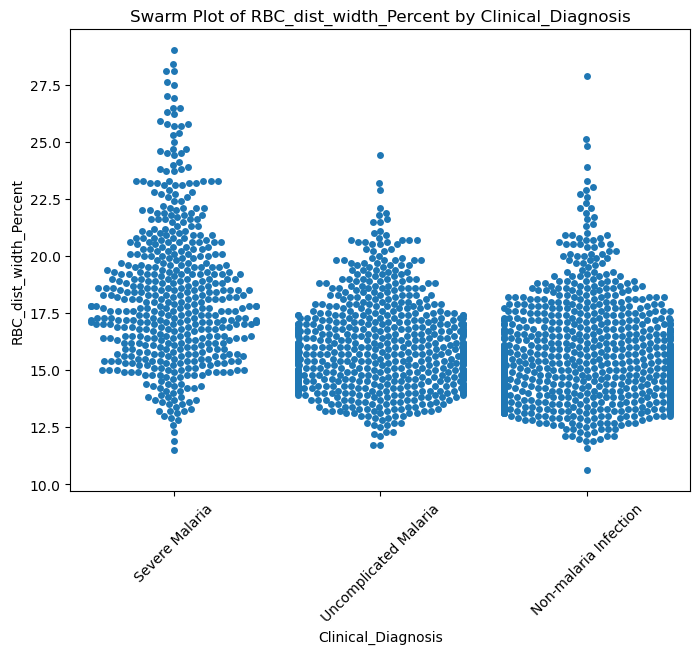

C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\1964835812.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars


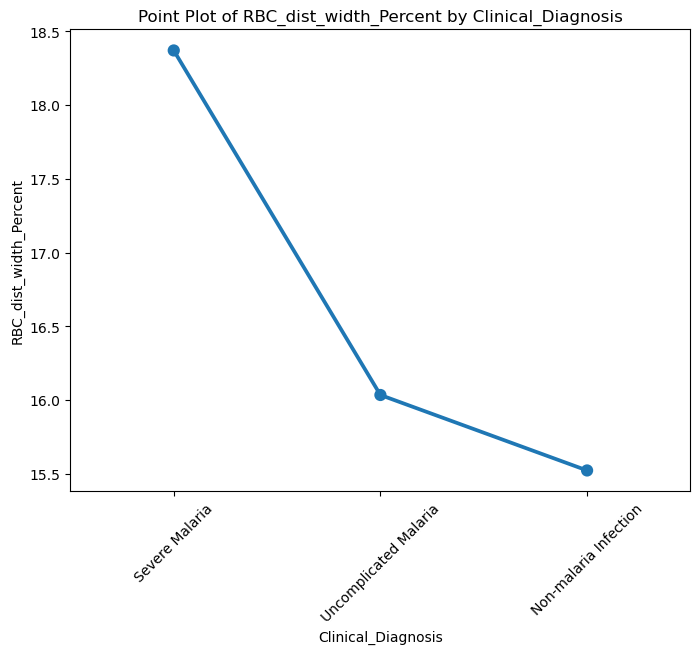

In [34]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of numerical columns
numericals_cols = ['wbc_count', 'rbc_count', 'hb_level', 'hematocrit',
                   'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
                   'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
                   'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
                   'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
                   'RBC_dist_width_Percent']

# Visualize each numerical column against the target variable
for col in numericals_cols:
    plt.figure(figsize=(8, 6))
    
    # Example 1: Violin Plot
    sns.violinplot(data=subset, x='Clinical_Diagnosis', y=col)
    plt.title(f'Violin Plot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()
    
    # Example 2: Bar Plot
    plt.figure(figsize=(8, 6))
    sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars
    plt.title(f'Bar Plot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()
    
    # Example 3: Swarm Plot
    plt.figure(figsize=(8, 6))
    sns.swarmplot(data=subset, x='Clinical_Diagnosis', y=col)
    plt.title(f'Swarm Plot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()
    
    # Example 4: Point Plot
    plt.figure(figsize=(8, 6))
    sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, ci=None)  # ci=None to remove error bars
    plt.title(f'Point Plot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()


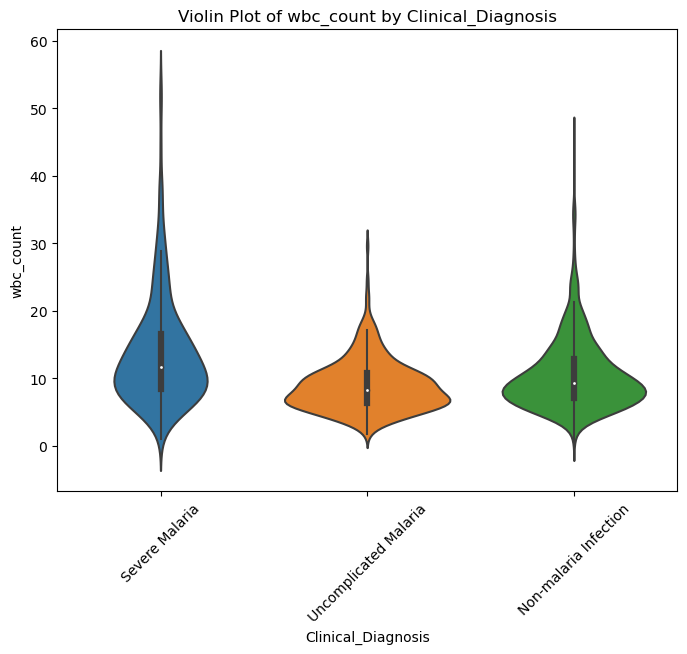

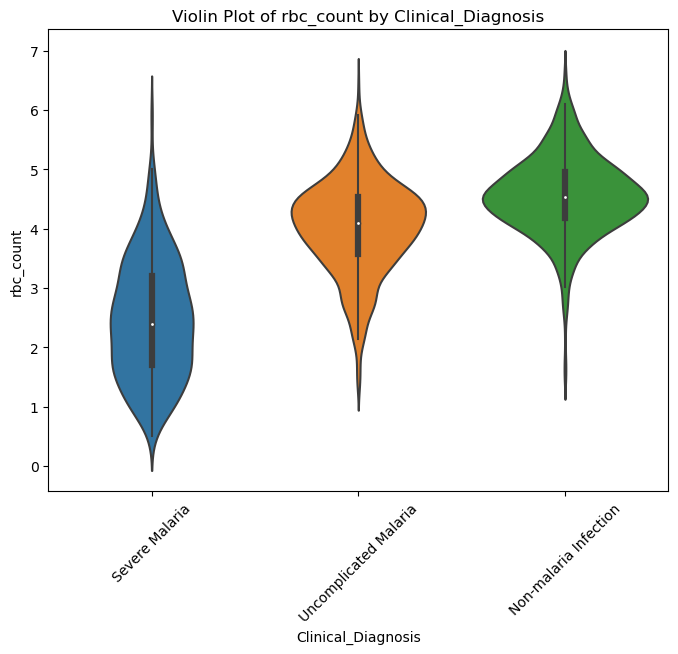

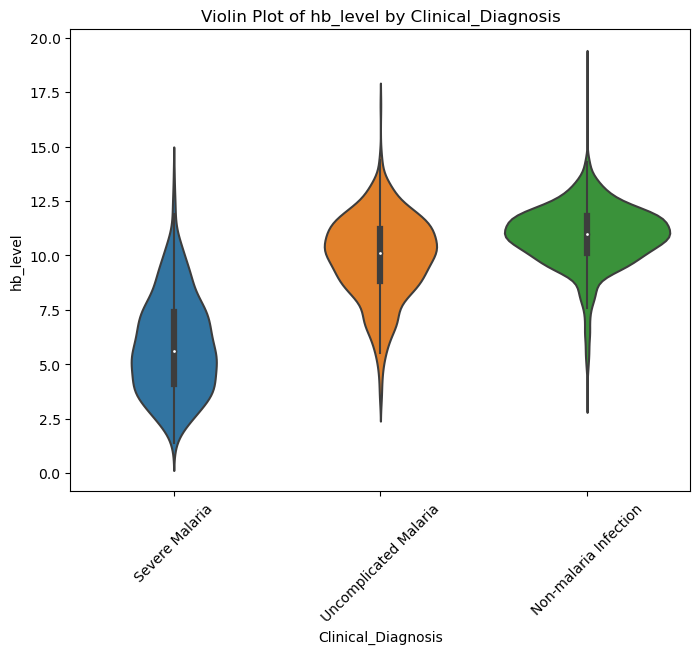

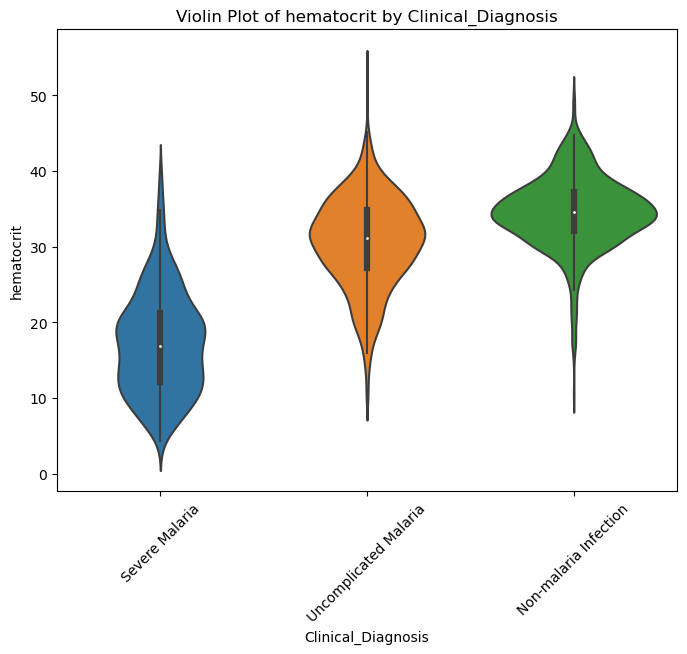

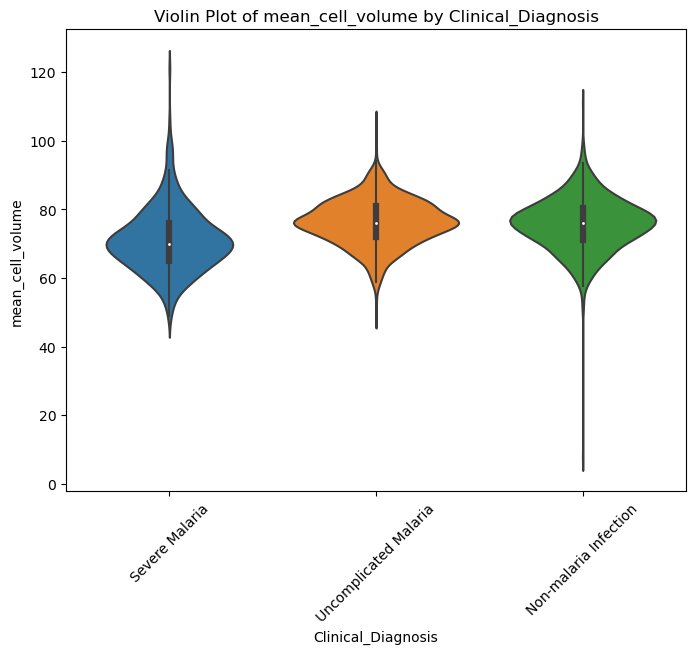

...

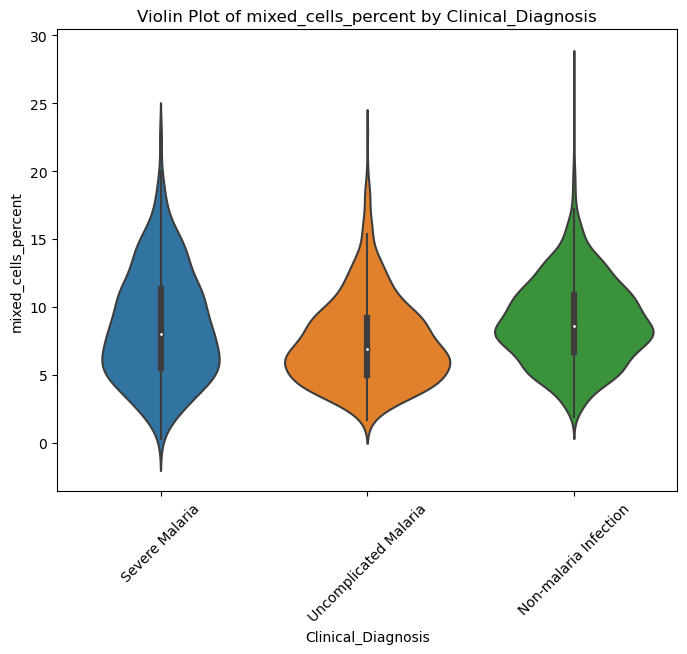

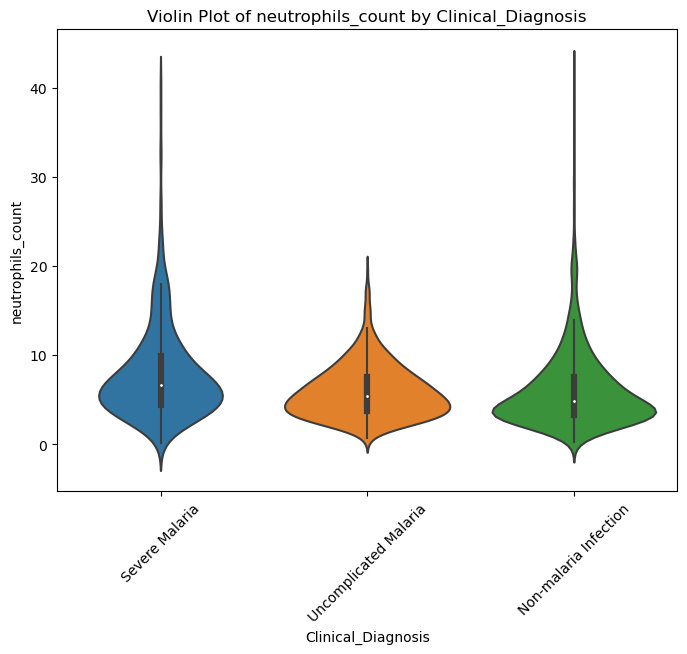

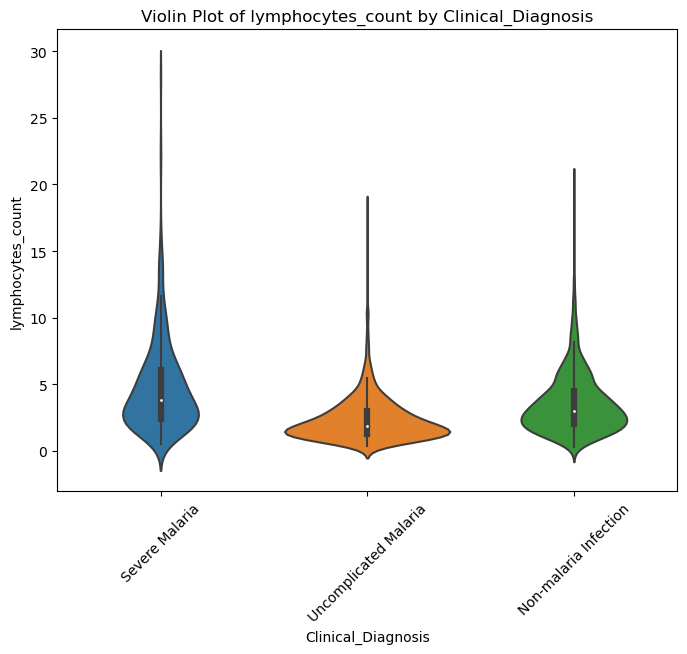

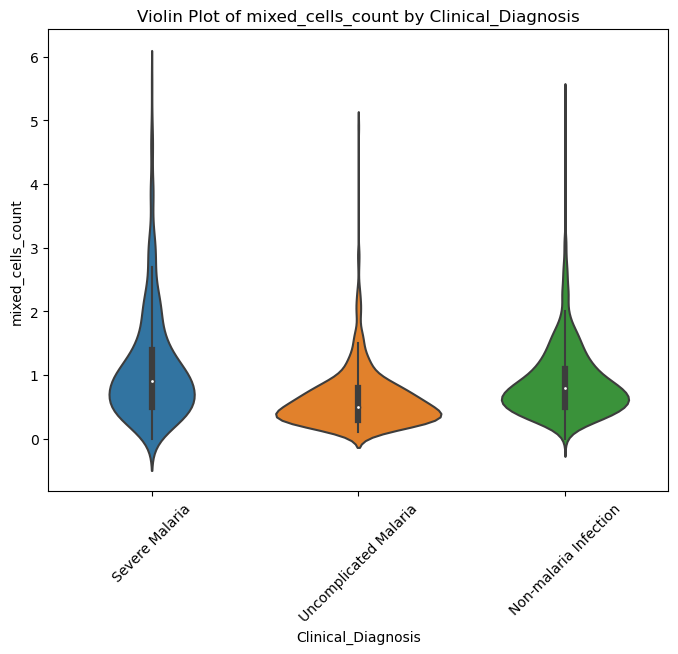

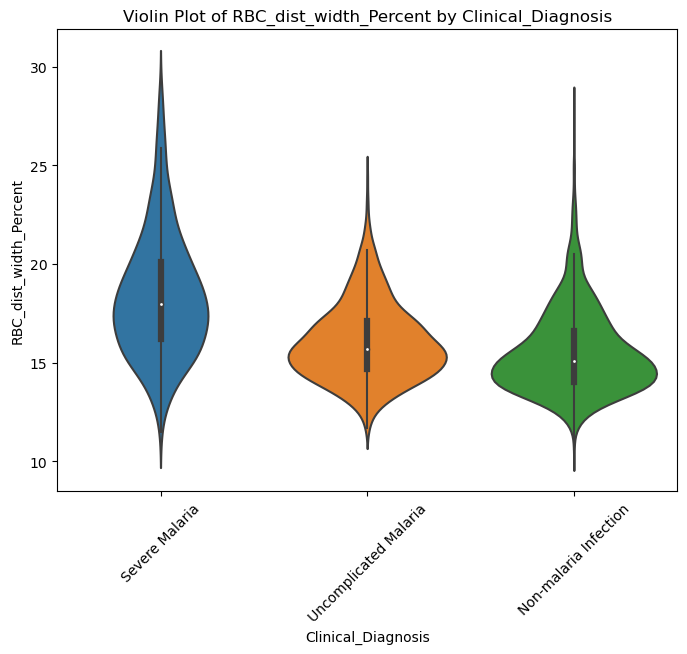

In [35]:

# Violin Plot

# List of numerical columns
numericals_cols = ['wbc_count', 'rbc_count', 'hb_level', 'hematocrit',
                   'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
                   'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
                   'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
                   'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
                   'RBC_dist_width_Percent']

# Visualize each numerical column against the target variable
for col in numericals_cols:
    plt.figure(figsize=(8, 6))
    
    sns.violinplot(data=subset, x='Clinical_Diagnosis', y=col)
    plt.title(f'Violin Plot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()
    
    

<Figure size 800x600 with 0 Axes>

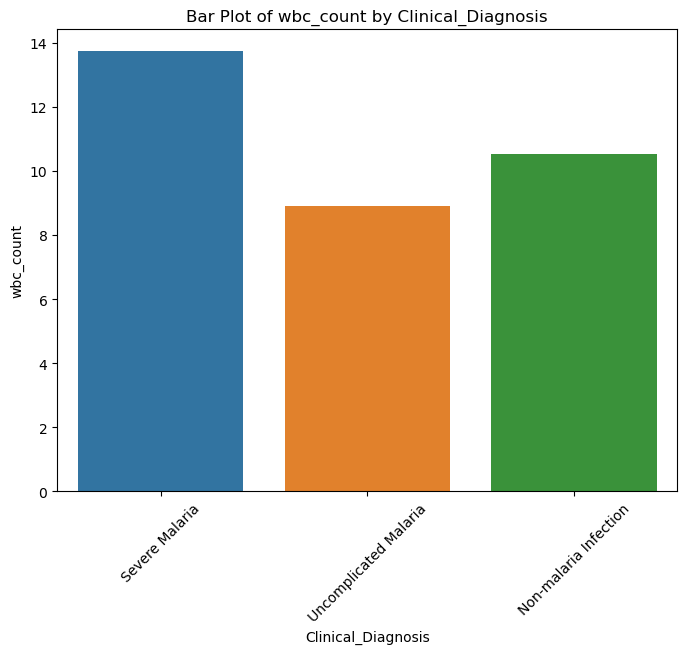

<Figure size 800x600 with 0 Axes>

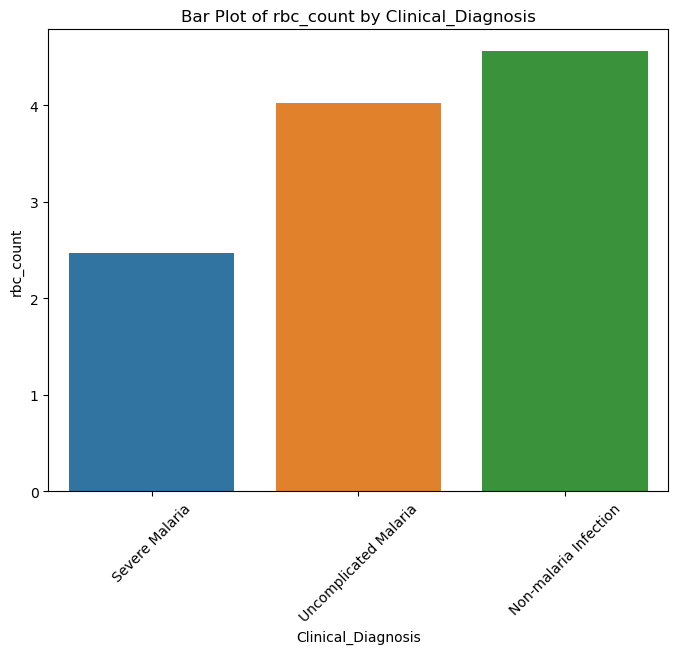

<Figure size 800x600 with 0 Axes>

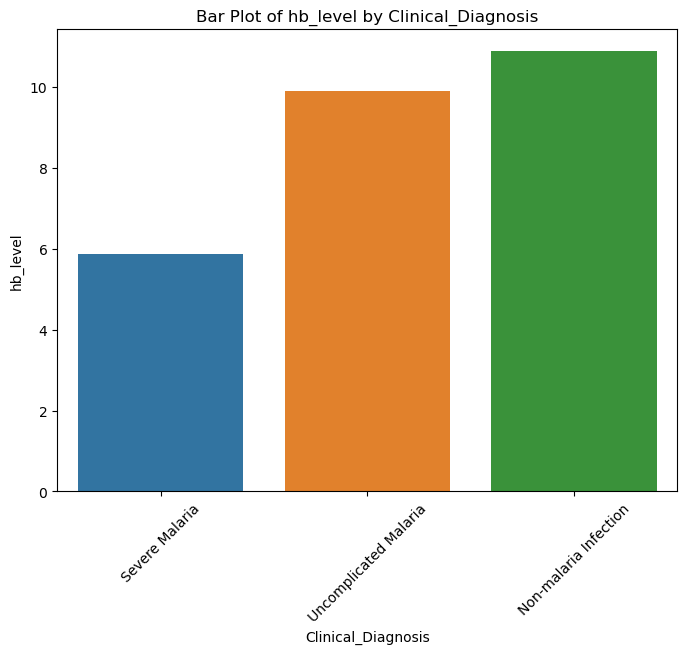

<Figure size 800x600 with 0 Axes>

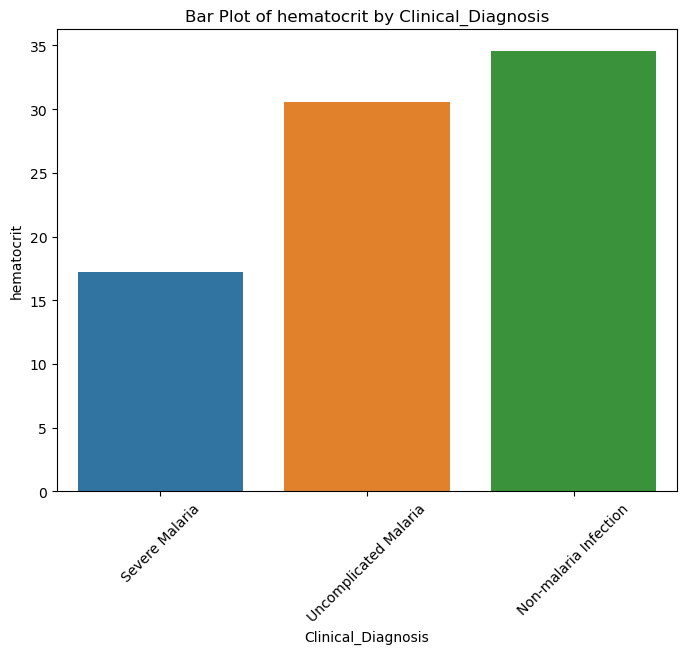

<Figure size 800x600 with 0 Axes>

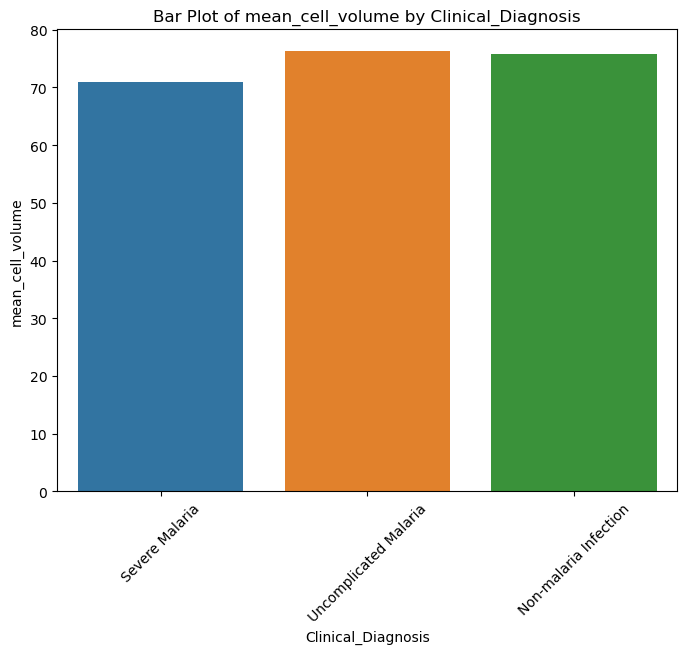

<Figure size 800x600 with 0 Axes>

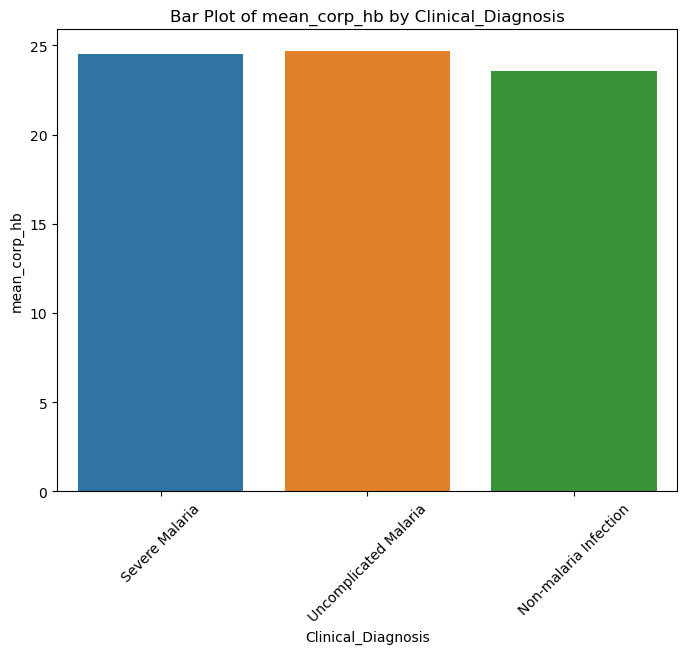

<Figure size 800x600 with 0 Axes>

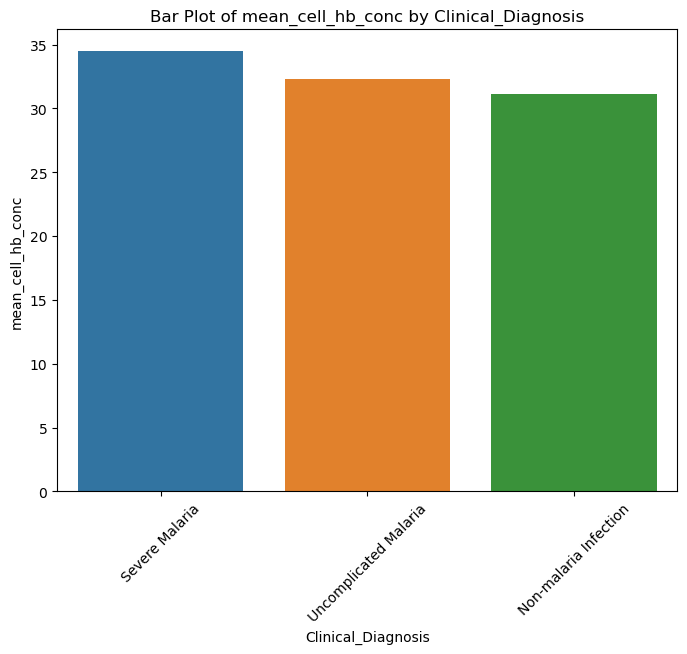

<Figure size 800x600 with 0 Axes>

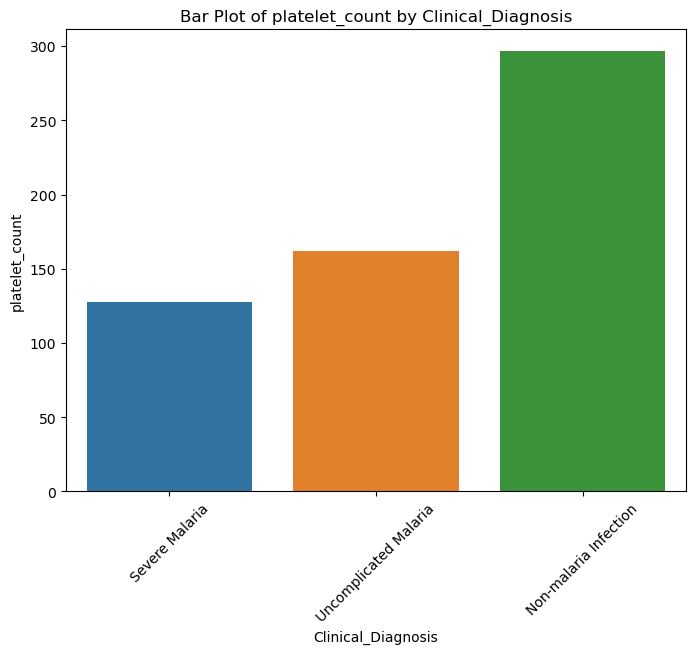

<Figure size 800x600 with 0 Axes>

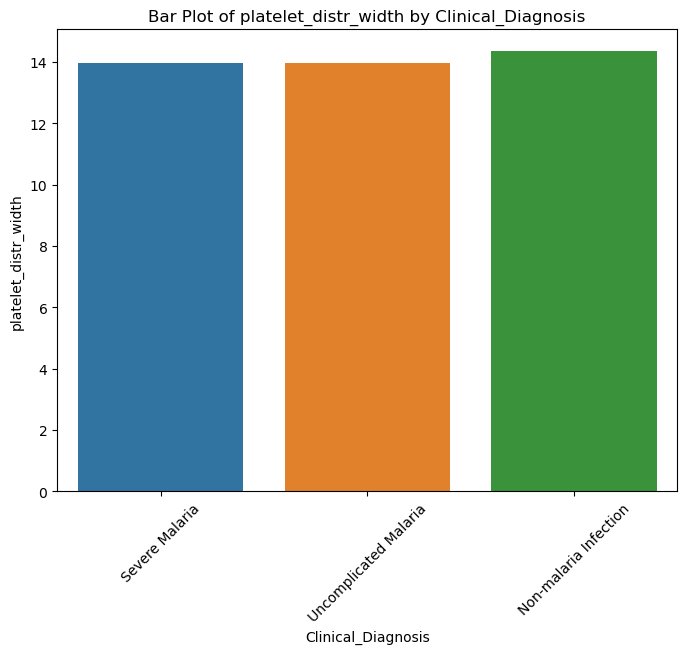

<Figure size 800x600 with 0 Axes>

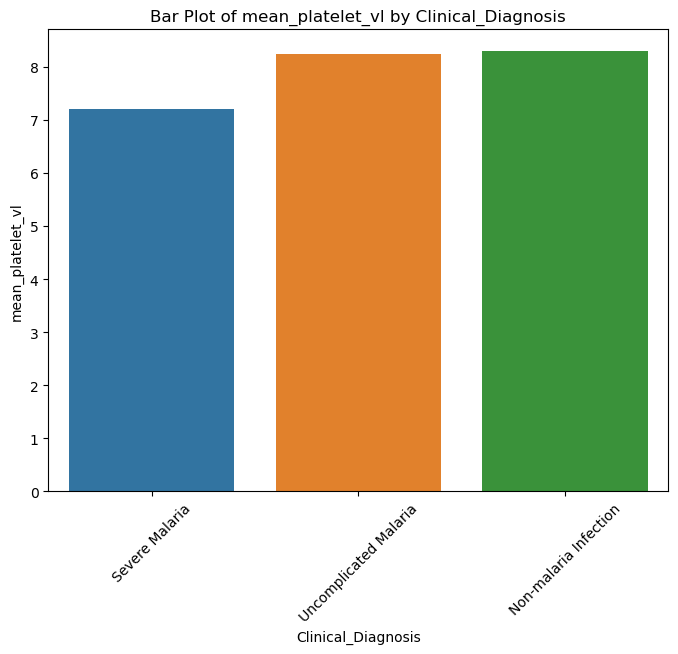

<Figure size 800x600 with 0 Axes>

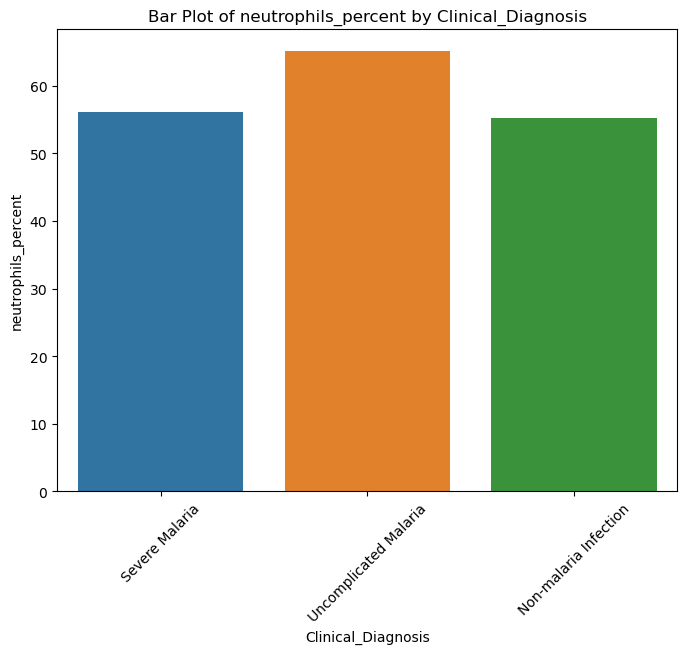

<Figure size 800x600 with 0 Axes>

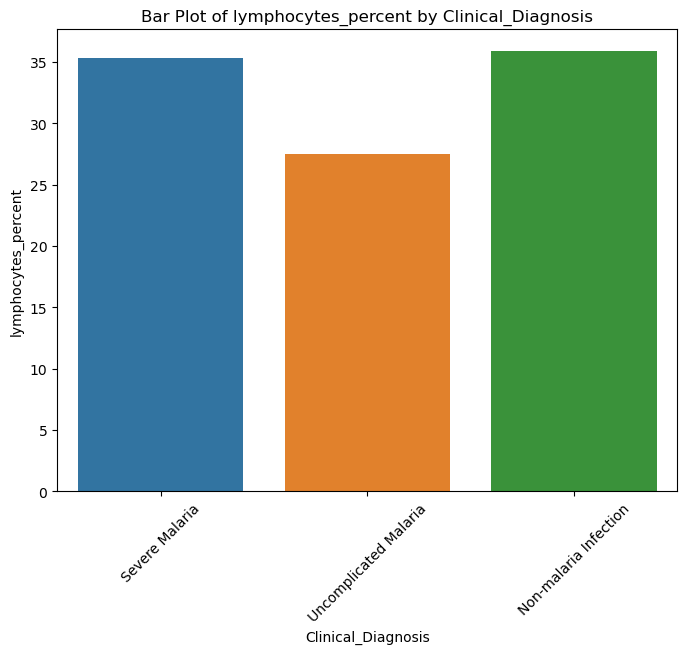

<Figure size 800x600 with 0 Axes>

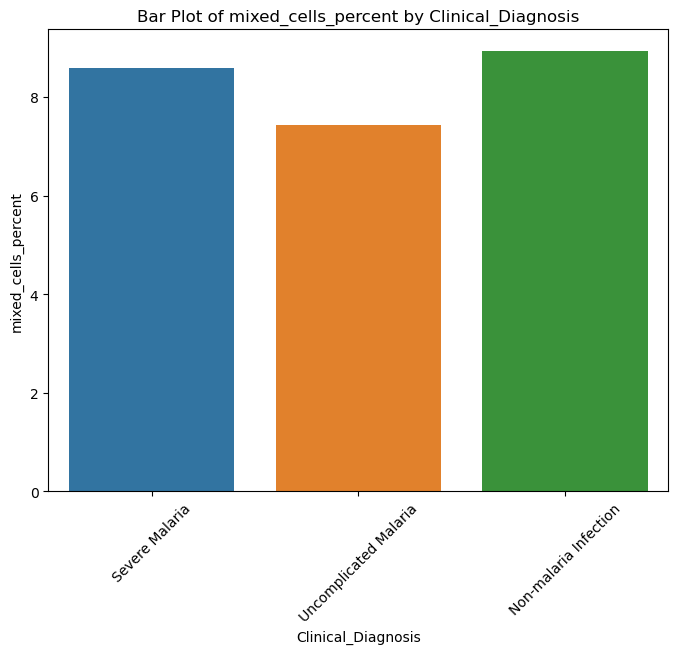

<Figure size 800x600 with 0 Axes>

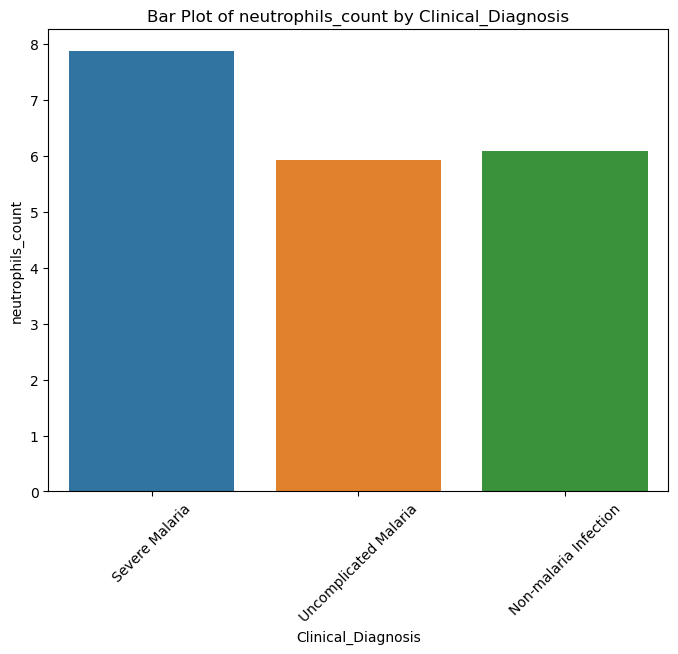

<Figure size 800x600 with 0 Axes>

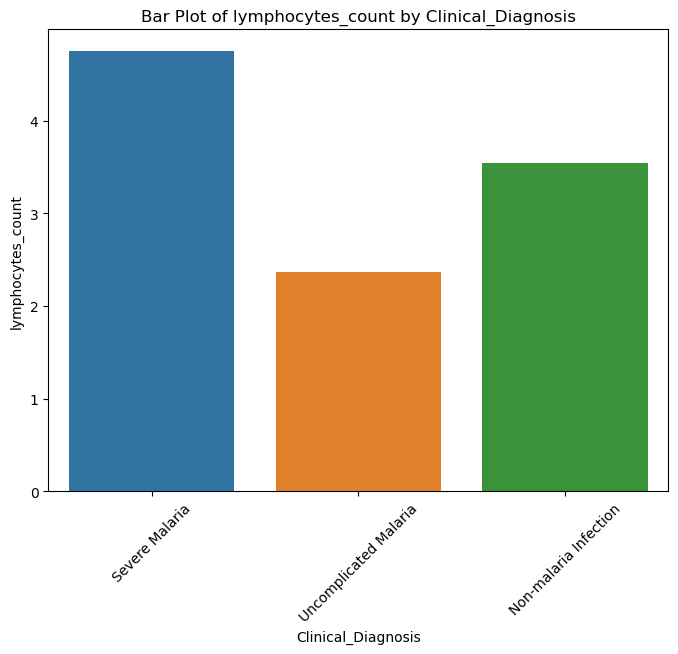

<Figure size 800x600 with 0 Axes>

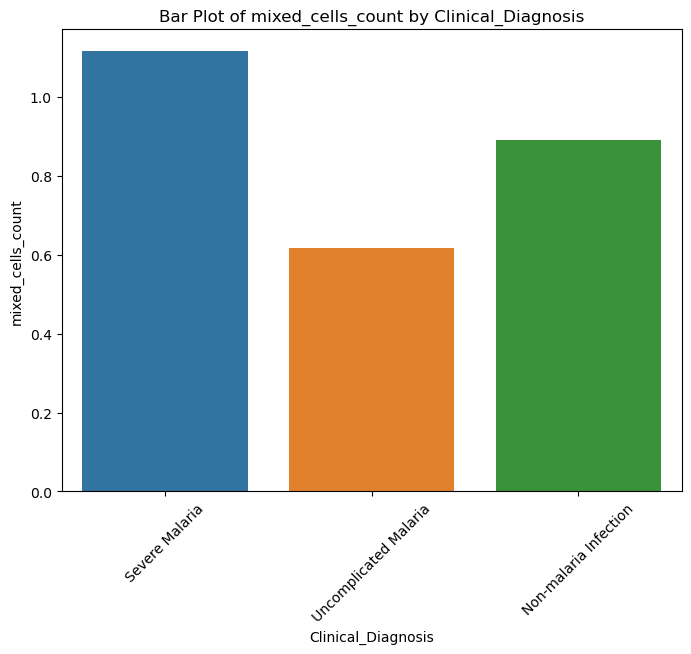

<Figure size 800x600 with 0 Axes>

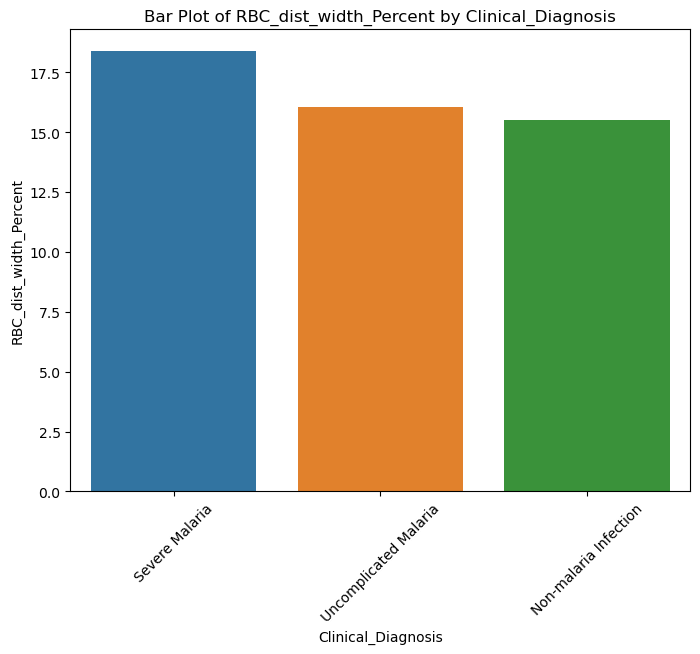

In [37]:
#  Bar Plot

# List of numerical columns
numericals_cols = ['wbc_count', 'rbc_count', 'hb_level', 'hematocrit',
                   'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
                   'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
                   'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
                   'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
                   'RBC_dist_width_Percent']

# Visualize each numerical column against the target variable
for col in numericals_cols:
    plt.figure(figsize=(8, 6))
    
   
    
    plt.figure(figsize=(8, 6))
    sns.barplot(data=subset, x='Clinical_Diagnosis', y=col, errorbar=None)  # ci=None to remove error bars
    plt.title(f'Bar Plot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()
    


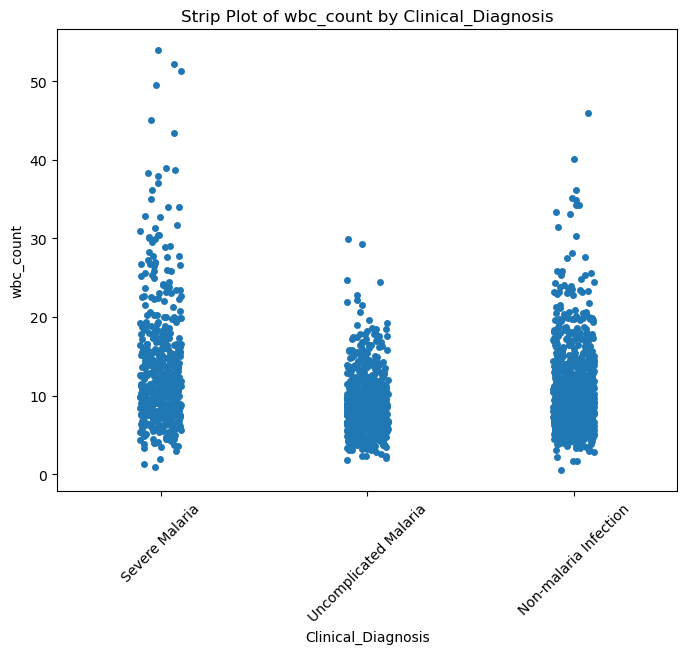

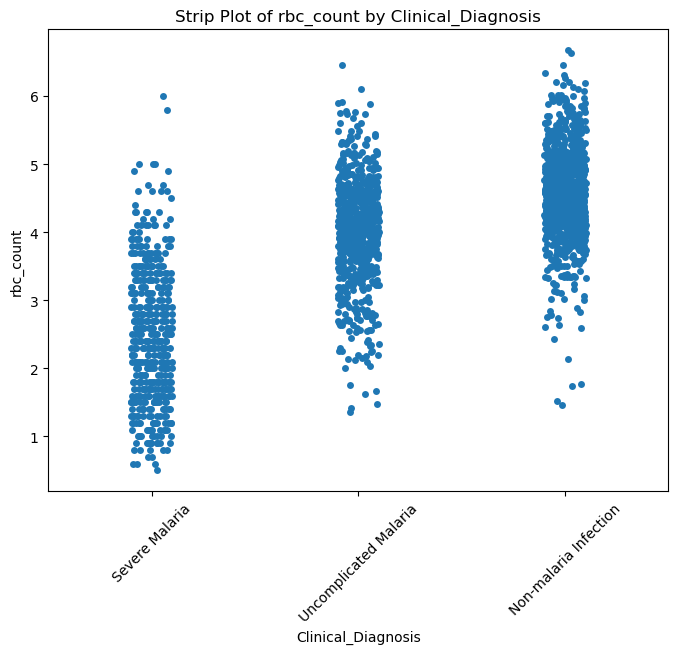

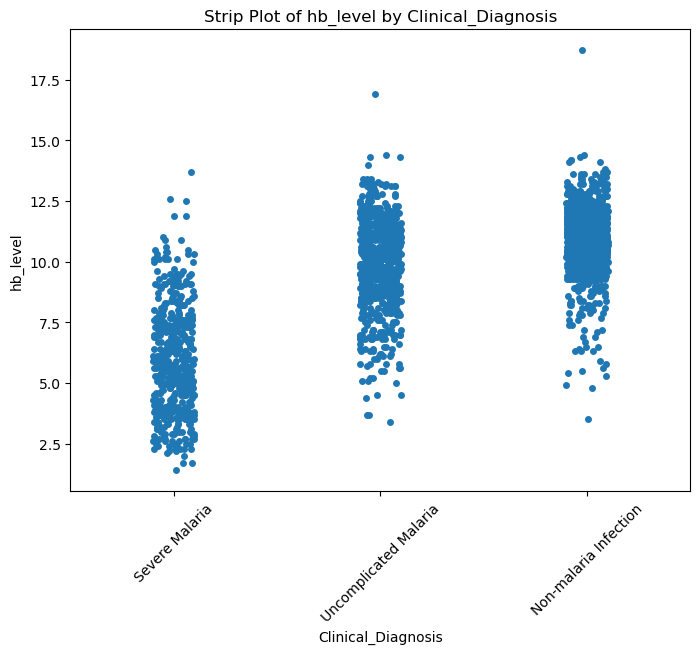

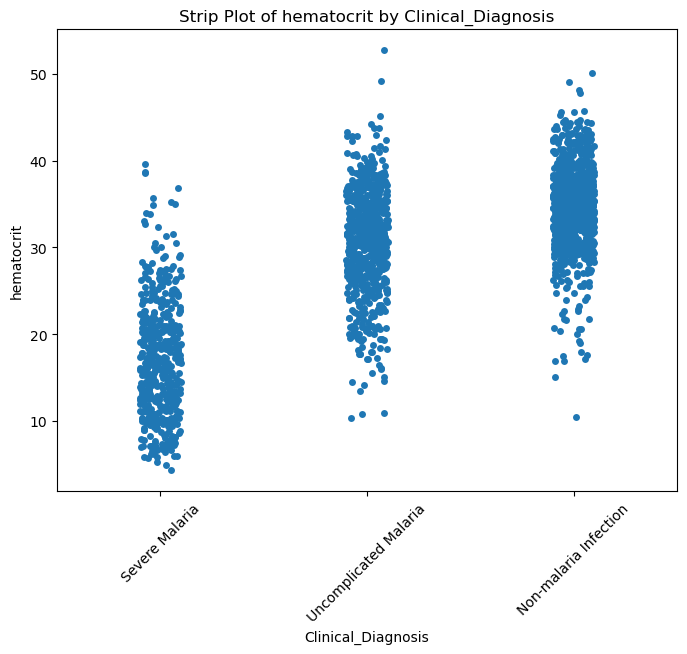

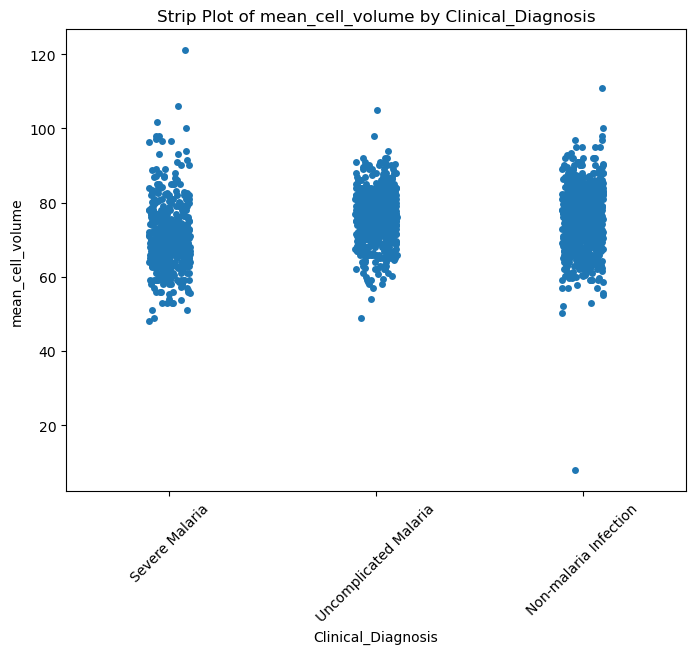

...

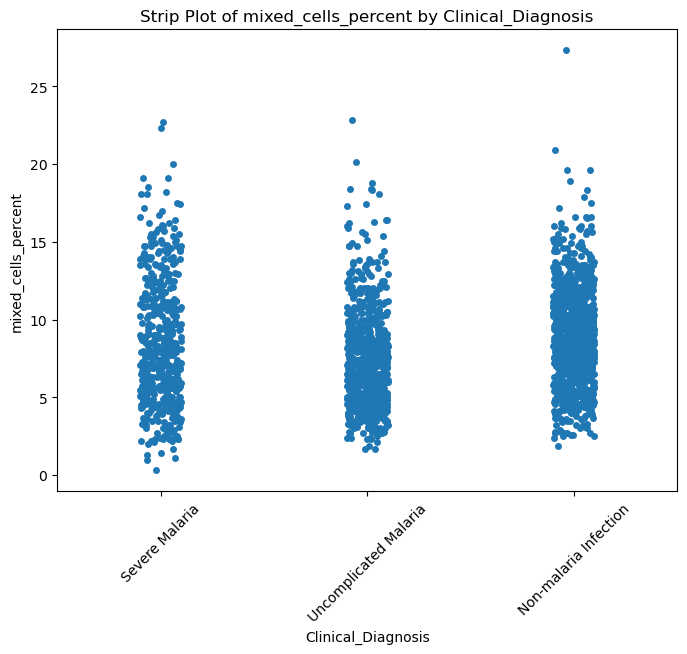

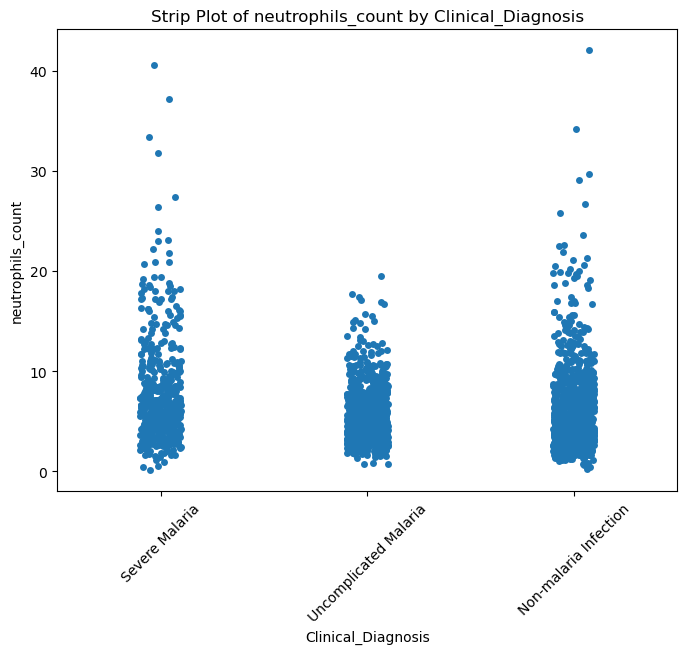

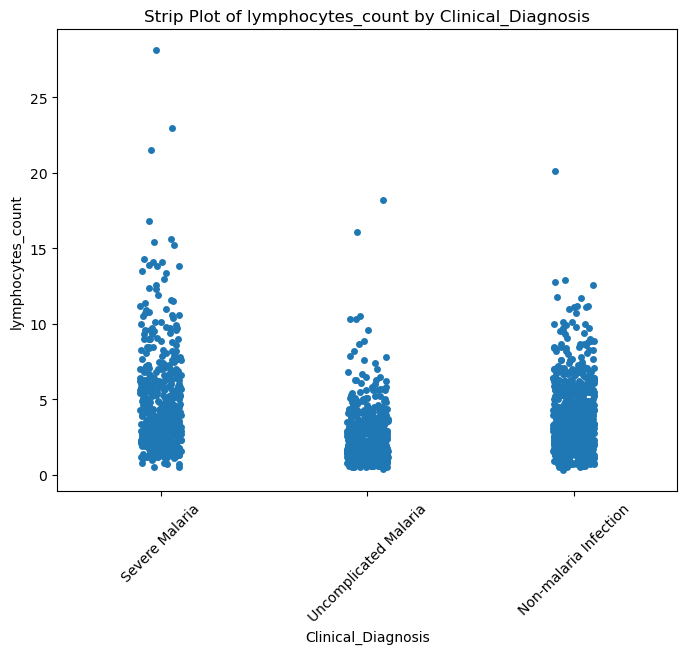

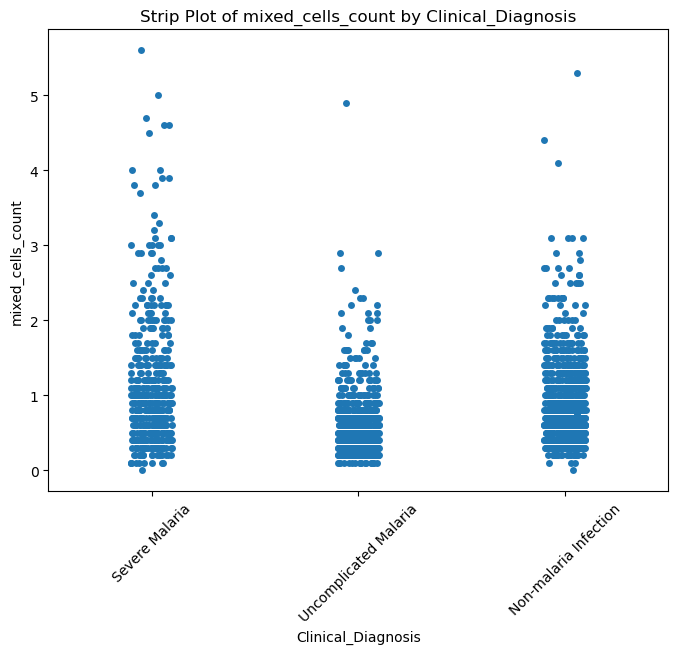

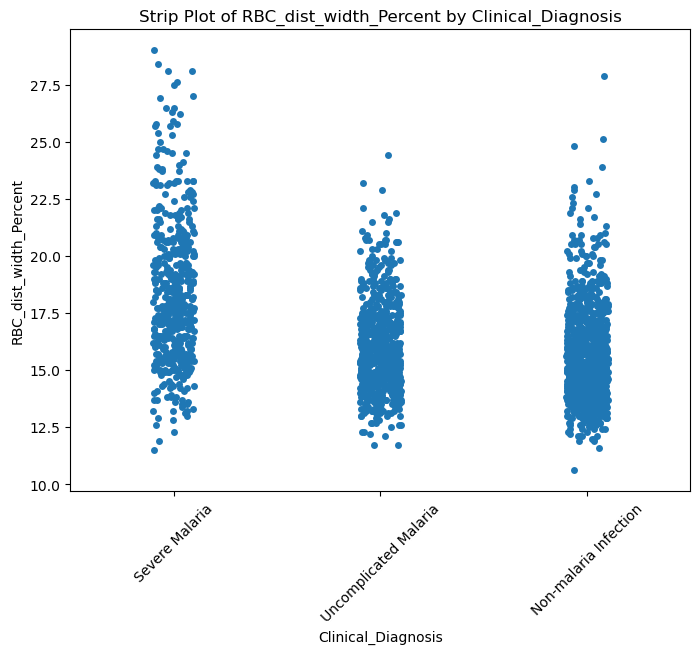

In [39]:

# List of numerical columns
numericals_cols = ['wbc_count', 'rbc_count', 'hb_level', 'hematocrit',
                   'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
                   'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
                   'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
                   'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
                   'RBC_dist_width_Percent']

# Visualize each numerical column against the target variable
for col in numericals_cols:
    plt.figure(figsize=(8, 6))
    sns.stripplot(data=subset, x='Clinical_Diagnosis', y=col, jitter=True)
    plt.title(f'Strip Plot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()
    
    


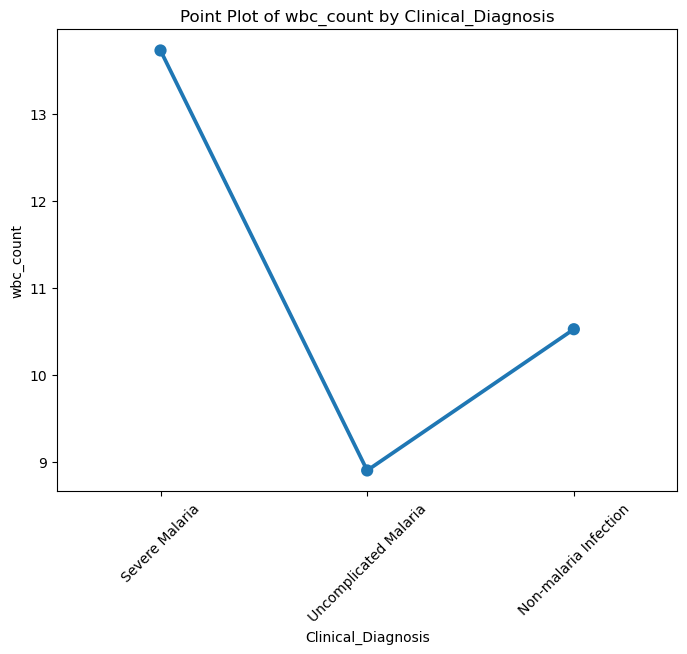

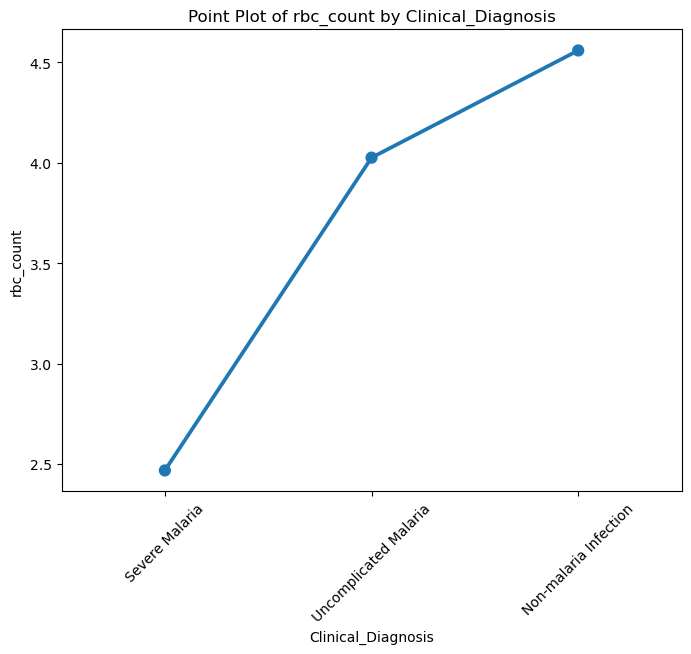

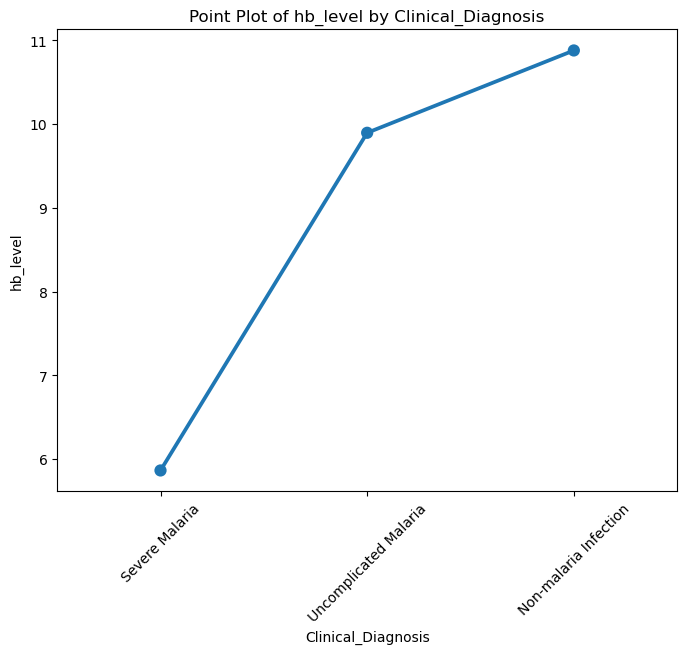

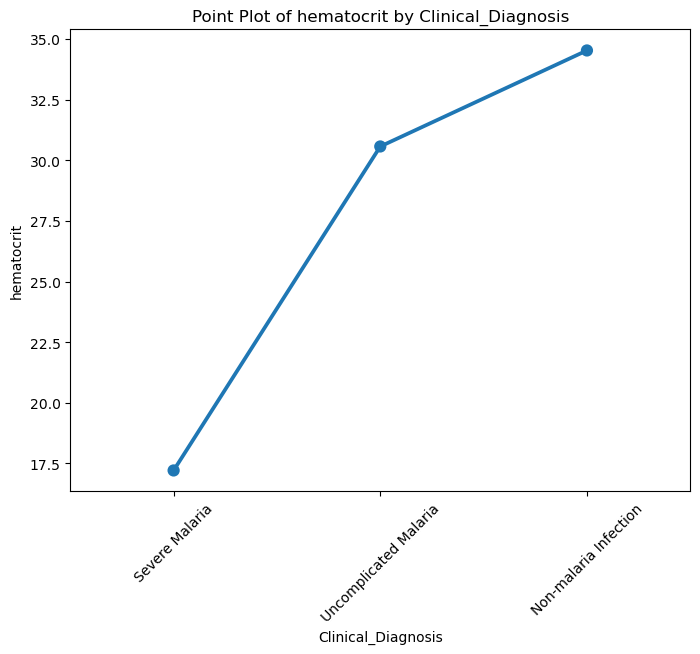

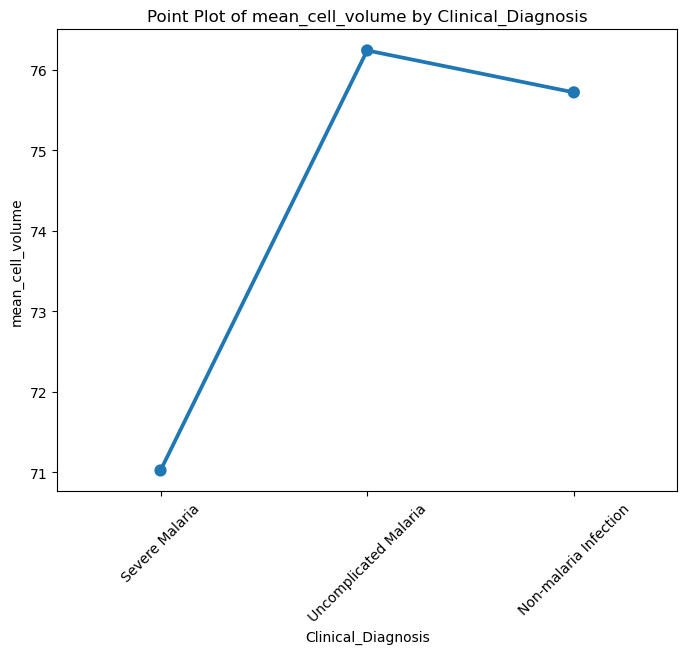

...

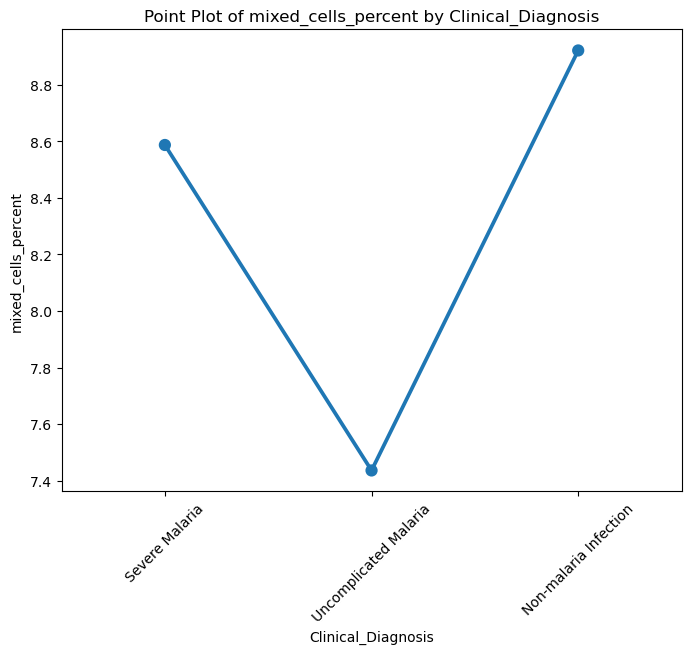

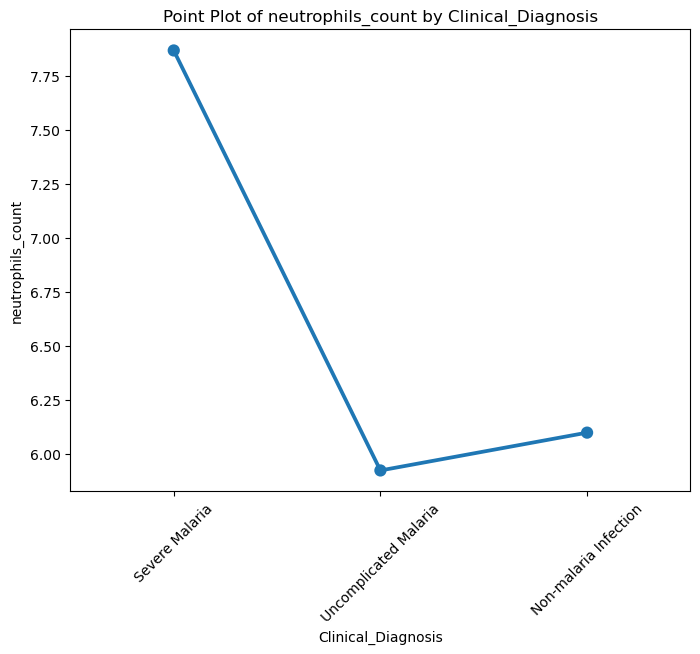

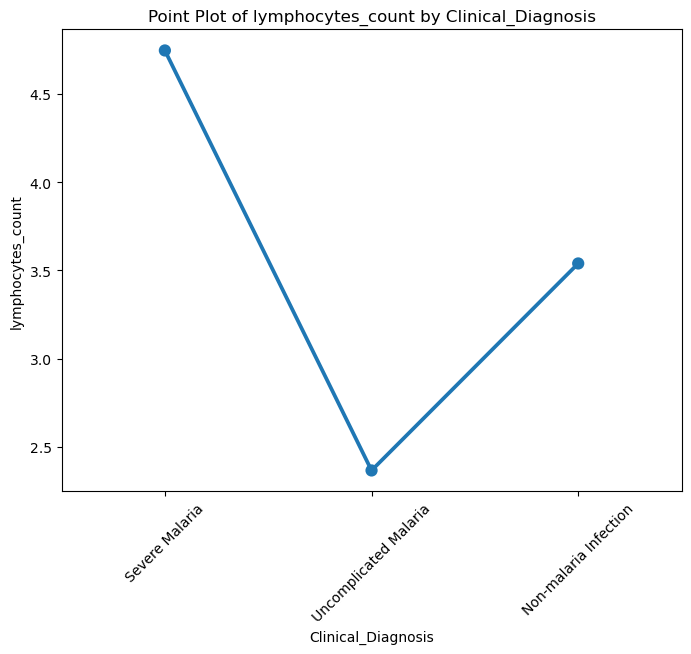

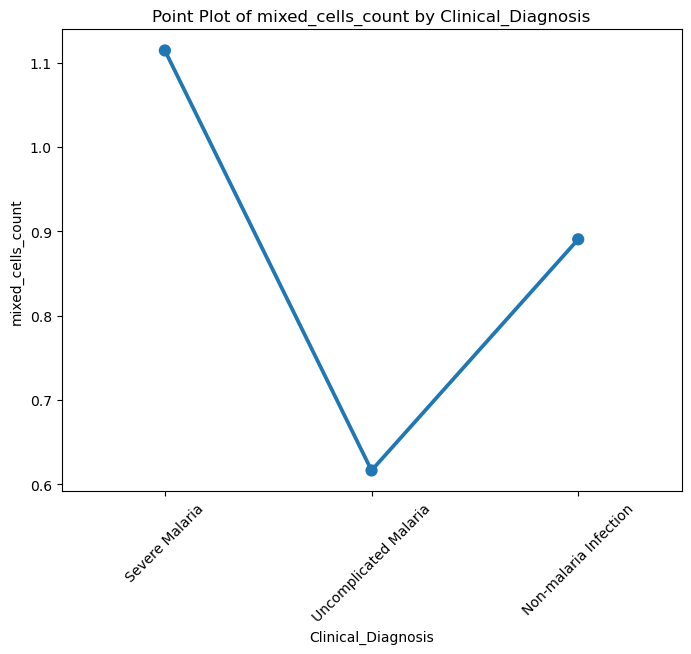

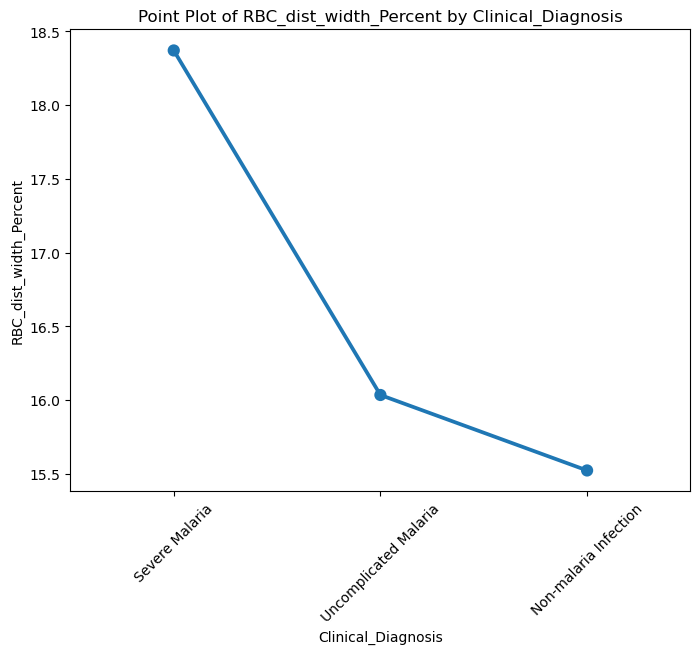

In [41]:
# Point Plot

# List of numerical columns
numericals_cols = ['wbc_count', 'rbc_count', 'hb_level', 'hematocrit',
                   'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
                   'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
                   'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
                   'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
                   'RBC_dist_width_Percent']

# Visualize each numerical column against the target variable
for col in numericals_cols:
    
    
   
    plt.figure(figsize=(8, 6))
    sns.pointplot(data=subset, x='Clinical_Diagnosis', y=col, errorbar=None)  
    plt.title(f'Point Plot of {col} by Clinical_Diagnosis')
    plt.xlabel('Clinical_Diagnosis')
    plt.ylabel(col)
    plt.xticks(rotation=45)
    plt.show()


D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

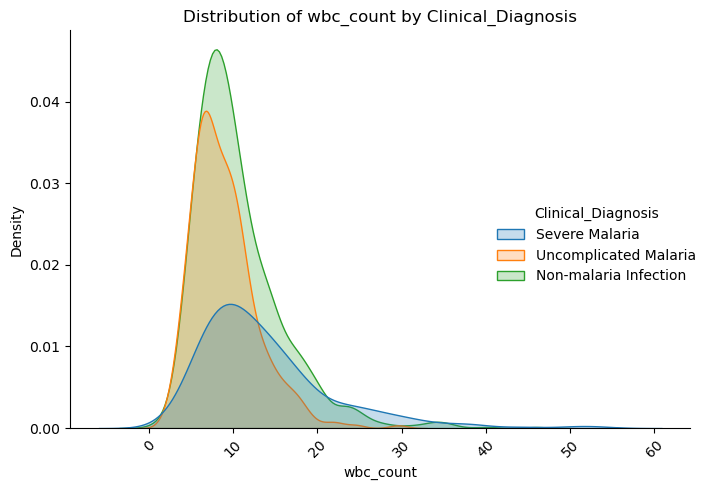

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

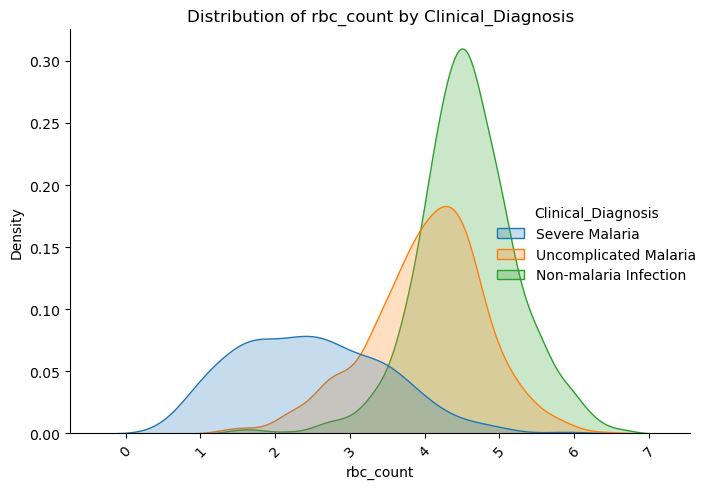

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

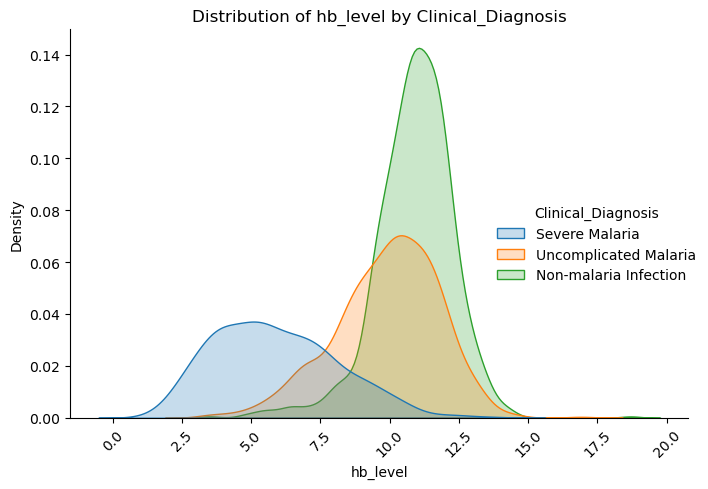

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

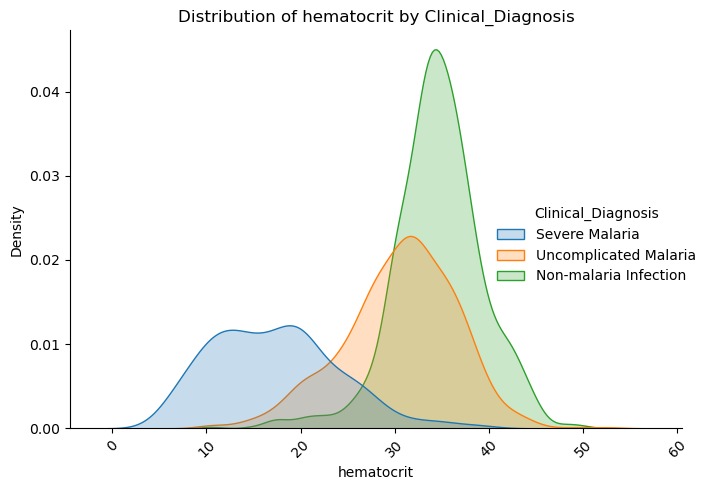

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

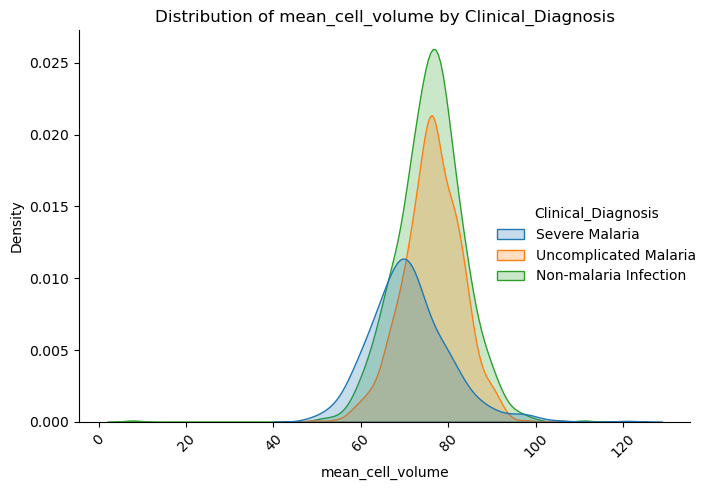

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

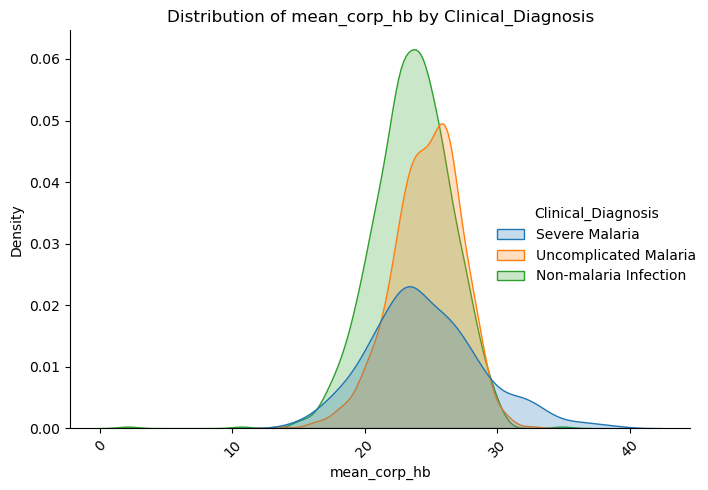

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

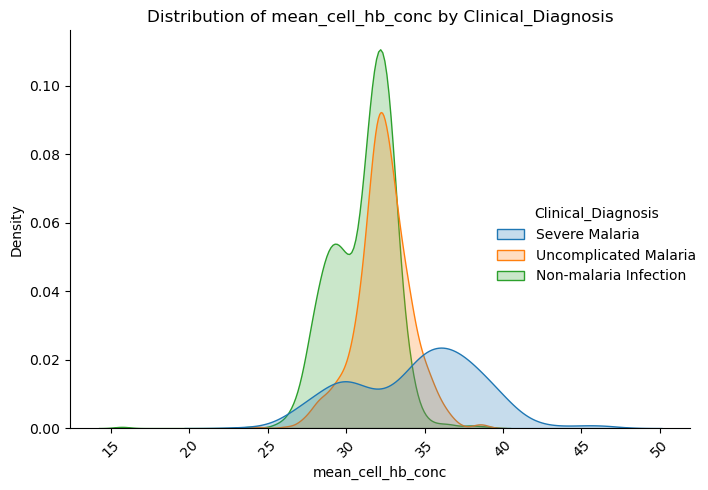

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

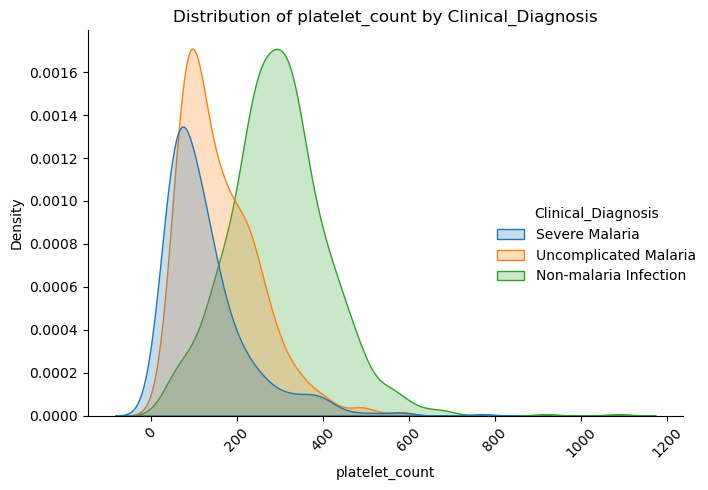

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

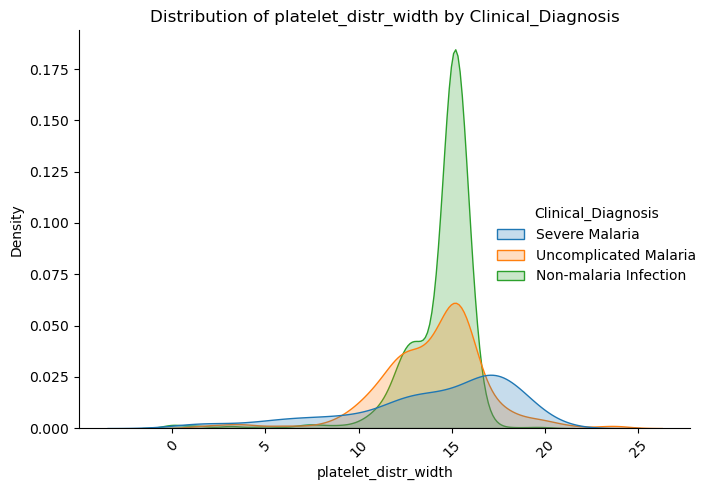

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

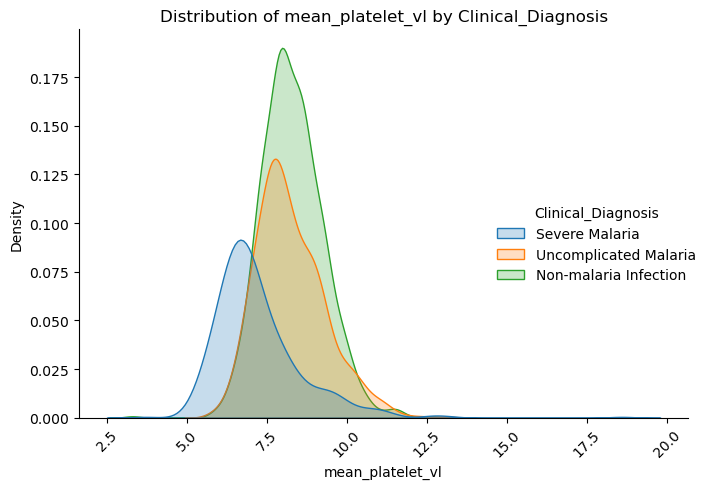

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

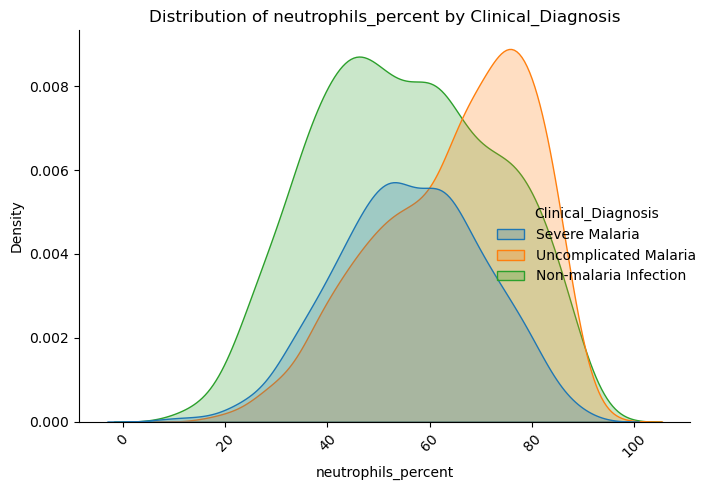

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

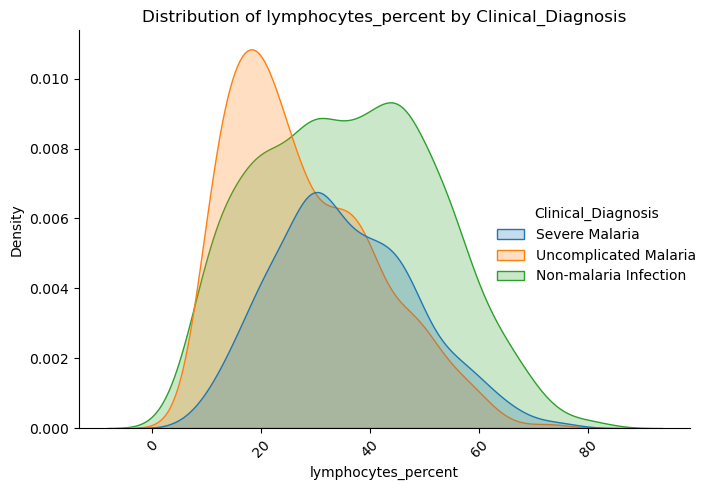

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

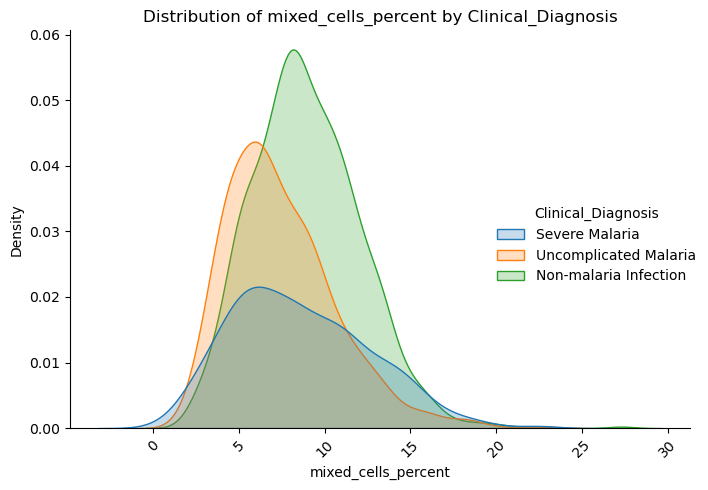

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

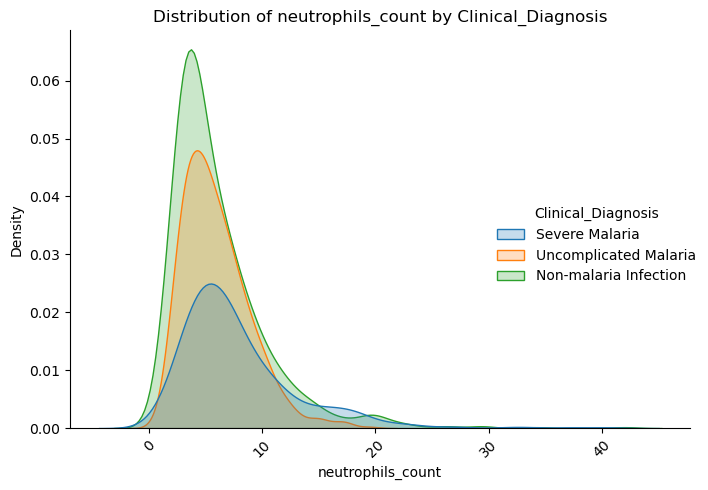

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

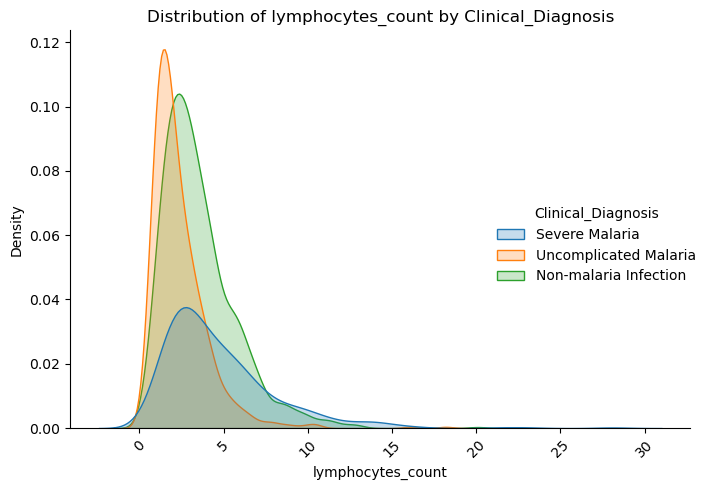

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

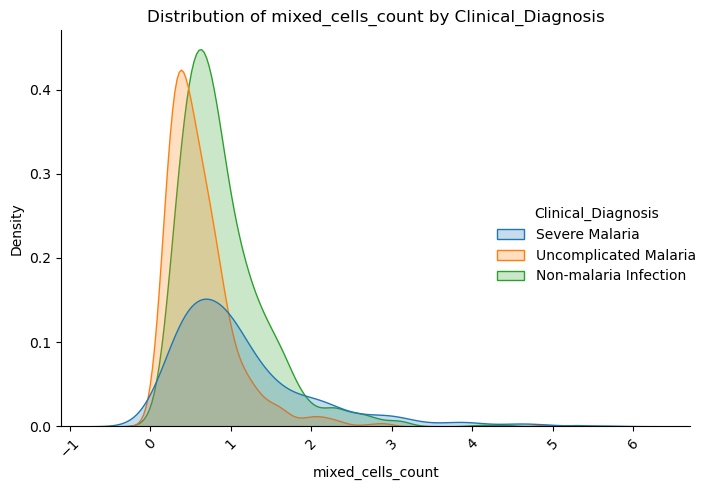

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
C:\Users\Hind\AppData\Local\Temp\ipykernel_8096\2000926029.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()  # Adjust the layout automatically


<Figure size 800x600 with 0 Axes>

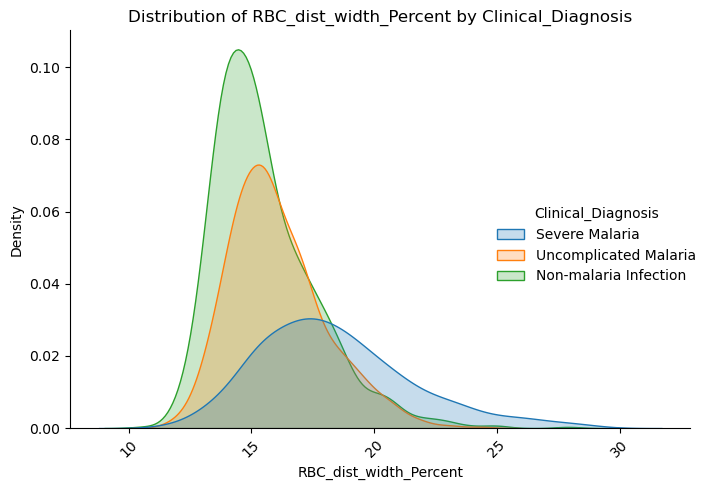

In [44]:


# List of numerical columns
numericals_cols = ['wbc_count', 'rbc_count', 'hb_level', 'hematocrit',
                   'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
                   'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
                   'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
                   'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
                   'RBC_dist_width_Percent']

# Visualize each numerical column against the target variable
for col in numericals_cols:
    plt.figure(figsize=(8, 6))
    sns.displot(data=subset, x=col, hue='Clinical_Diagnosis', kind='kde', fill=True)
    plt.title(f'Distribution of {col} by Clinical_Diagnosis')
    plt.xlabel(col)
    plt.ylabel('Density')
    plt.xticks(rotation=45)
    plt.tight_layout()  # Adjust the layout automatically

    plt.show()

## Observations:

- **Mean Cell Hemoglobin Concentration (mean_cell_hb_conc):** 
  - In severe malaria cases, there is a significant concentration observed between 35-40. No instances are found in this range for non-malaria infections.

- **Hematocrit:**
  - Hematocrit levels in severe malaria cases are consistently below 40.

- **Hemoglobin Level (hb_level):**
  - Hemoglobin levels in severe malaria cases are below 10.

- **Red Blood Cell Count (rbc_count):**
  - In severe malaria cases, the red blood cell count is consistently below 5. Additionally, no instances are observed in the range [0, 2] for non-malaria infections.


# Visualization of Relationship Between Variables in Numerical Columns


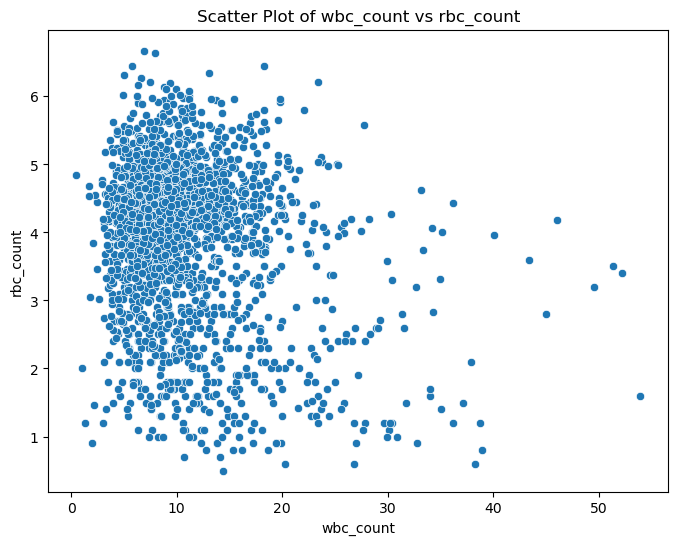

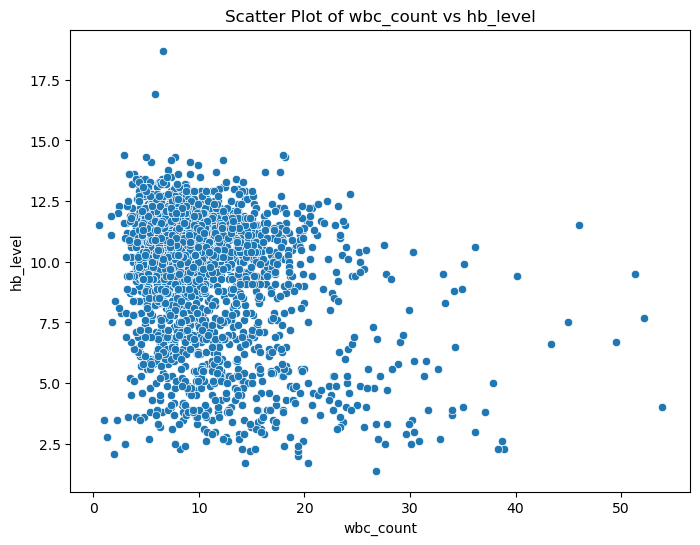

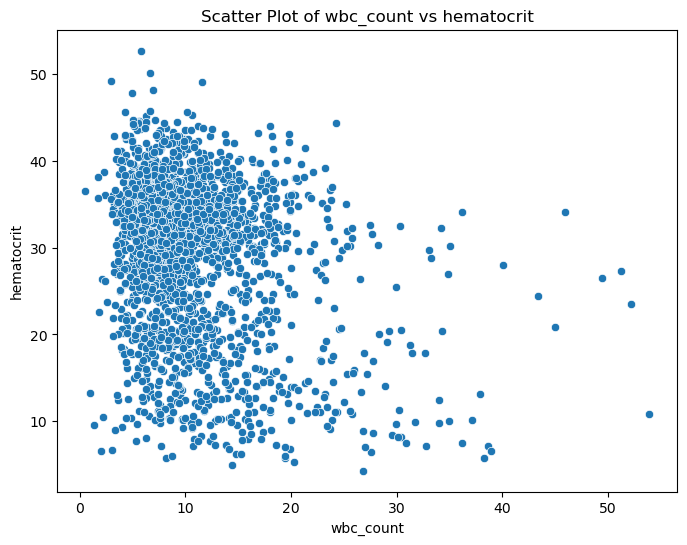

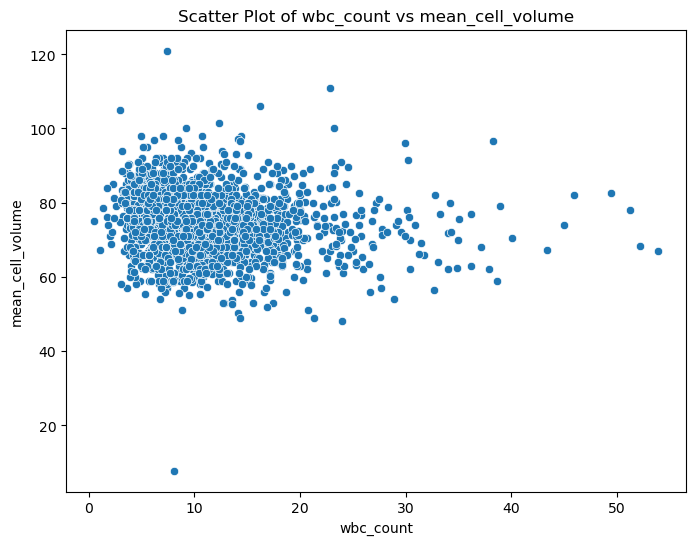

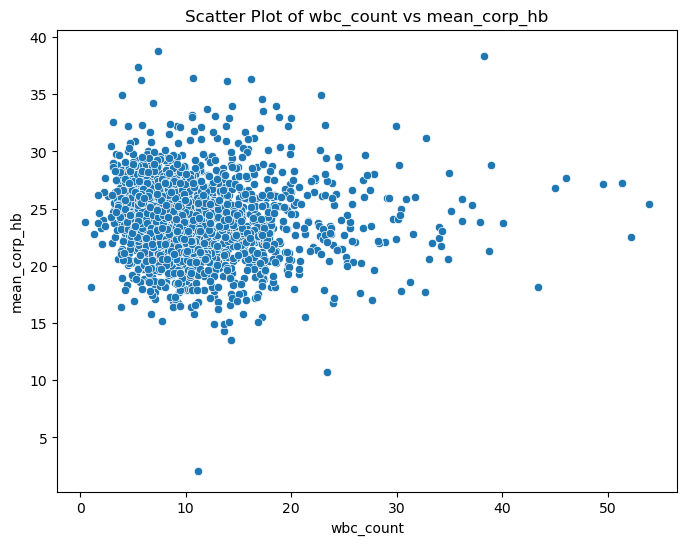

...

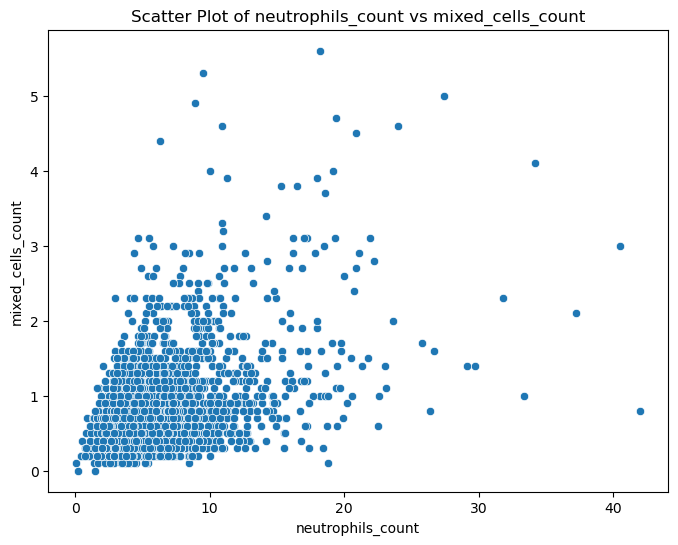

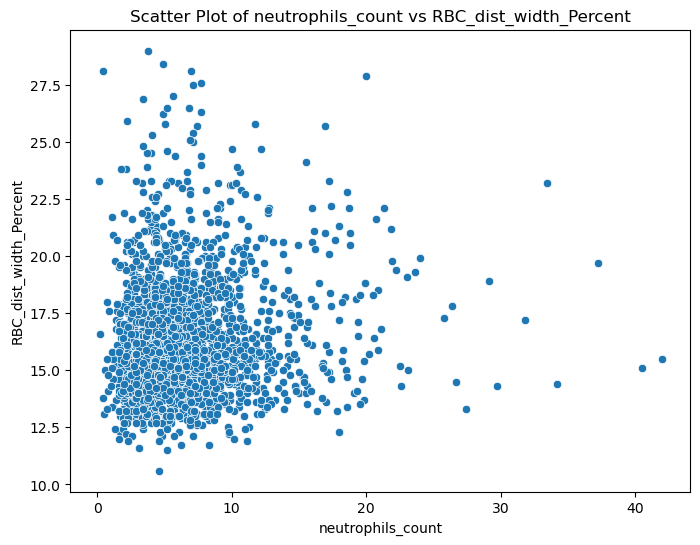

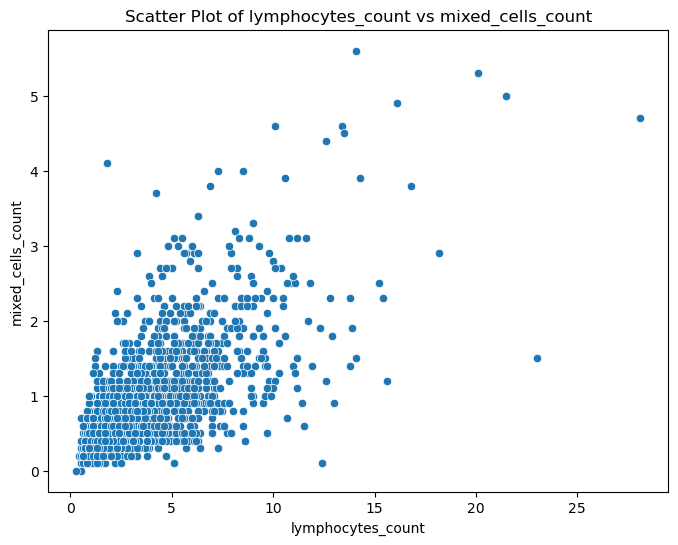

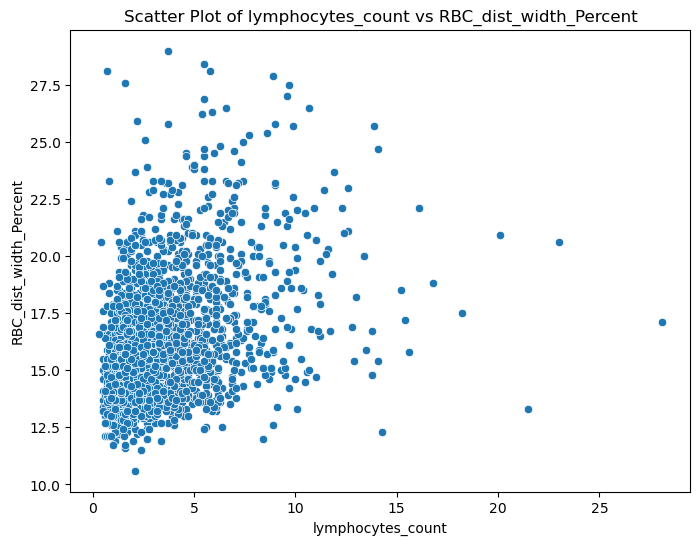

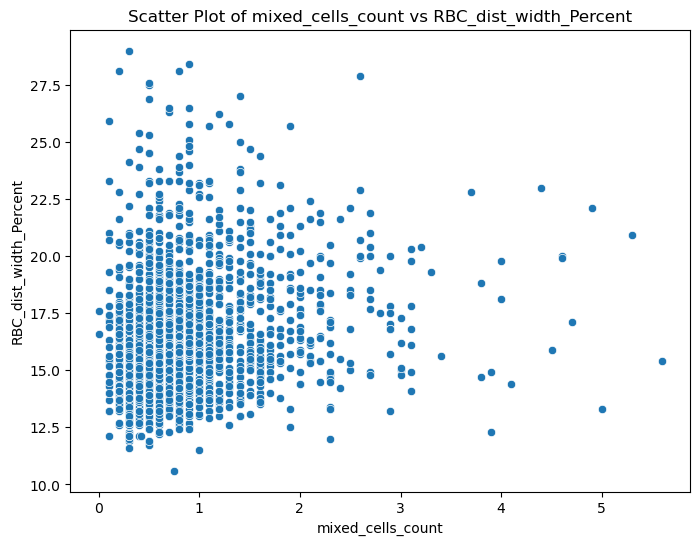

In [48]:
# List of numerical columns
numericals_cols = ['wbc_count', 'rbc_count', 'hb_level', 'hematocrit',
                   'mean_cell_volume', 'mean_corp_hb', 'mean_cell_hb_conc',
                   'platelet_count', 'platelet_distr_width', 'mean_platelet_vl',
                   'neutrophils_percent', 'lymphocytes_percent', 'mixed_cells_percent',
                   'neutrophils_count', 'lymphocytes_count', 'mixed_cells_count',
                   'RBC_dist_width_Percent']

subset_no_target = subset.drop(columns=['Clinical_Diagnosis'])
for i, col1 in enumerate(numericals_cols):
    for j, col2 in enumerate(numericals_cols):
        if i < j:
            plt.figure(figsize=(8, 6))
            sns.scatterplot(data=subset_no_target, x=col1, y=col2)
            plt.title(f'Scatter Plot of {col1} vs {col2}')
            plt.xlabel(col1)
            plt.ylabel(col2)
           
            plt.show()



## Observations on Correlation Between Columns

### Overview
In this analysis, we observe scatter plots between different numerical variables in the dataset.

### Correlation Analysis
- There is a strong positive correlation between 'hb_level' and 'hematocrit'.
- 'rbc_count' and 'hb_level' exhibit a strong positive correlation.
- 'neutrophils_count' and 'wbc_count' show a strong positive correlation.
- 'neutrophils_percent' and 'lymphocytes_percent' demonstrate a negative correlation (r < 0).

### Possible Explanations
Differences in correlation strengths may be attributed to the nature of the variables and their underlying relationships.


In [34]:
#descriptive statistics on the data
subset.iloc[:,1:].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
wbc_count,2156.0,10.723516,5.944994,0.5,6.80,9.30,12.900,53.90
rbc_count,2156.0,3.911679,1.132454,0.5,3.34,4.17,4.650,6.67
hb_level,2156.0,9.423010,2.650261,1.4,7.90,10.20,11.325,18.70
hematocrit,2156.0,29.320223,8.802975,4.3,24.20,31.70,35.500,52.70
mean_cell_volume,2156.0,74.828256,8.046383,7.8,70.00,75.00,80.000,121.00
mean_corp_hb,2156.0,24.142189,3.203595,2.1,22.20,24.10,26.200,38.80
mean_cell_hb_conc,2156.0,32.259318,2.864637,15.7,30.60,32.10,33.425,46.60
platelet_count,2156.0,214.545176,128.697718,3.0,105.00,201.00,300.250,1087.00
platelet_distr_width,2156.0,14.137894,3.064643,0.0,12.90,14.90,15.600,23.90
mean_platelet_vl,2156.0,8.031447,1.194886,3.3,7.20,7.90,8.800,18.60


<Axes: >

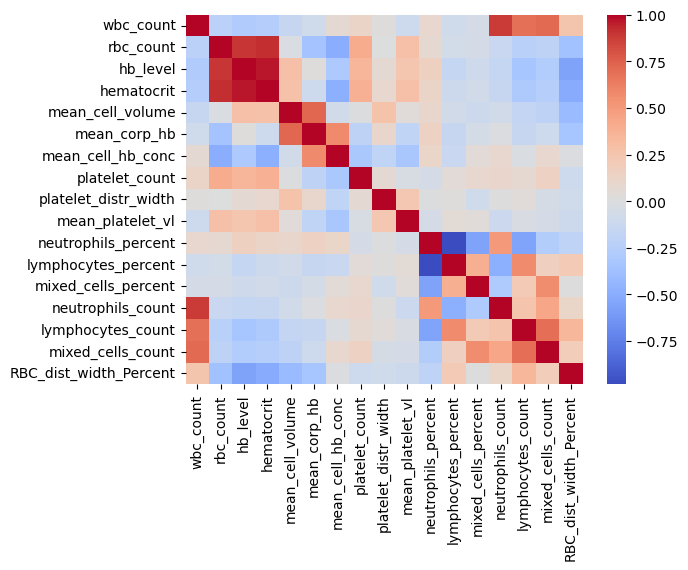

In [37]:
#visualize the correlation matrix using seaborn
sns.heatmap(subset.iloc[:,1:].corr(),cmap='coolwarm')

In [38]:
subset.iloc[:,1:].corr()

,wbc_count,rbc_count,hb_level,hematocrit,mean_cell_volume,mean_corp_hb,mean_cell_hb_conc,platelet_count,platelet_distr_width,mean_platelet_vl,neutrophils_percent,lymphocytes_percent,mixed_cells_percent,neutrophils_count,lymphocytes_count,mixed_cells_count,RBC_dist_width_Percent
wbc_count,1.000000,-0.217584,-0.283881,-0.261736,-0.150900,-0.084770,0.066981,0.122330,0.022260,-0.100716,0.093870,-0.090940,-0.057664,0.876999,0.689196,0.715568,0.252208
rbc_count,-0.217584,1.000000,0.896557,0.922294,-0.017848,-0.348335,-0.497615,0.409424,0.001756,0.284809,0.077574,-0.073216,-0.056070,-0.134216,-0.233978,-0.200859,-0.364396
hb_level,-0.283881,0.896557,1.000000,0.968644,0.286931,0.023659,-0.302304,0.353828,0.068770,0.248323,0.162289,-0.158665,-0.093352,-0.153907,-0.338160,-0.273327,-0.562710
hematocrit,-0.261736,0.922294,0.968644,1.000000,0.279029,-0.101461,-0.479766,0.387830,0.091718,0.285169,0.119252,-0.113198,-0.083365,-0.152236,-0.294044,-0.253324,-0.510445
mean_cell_volume,-0.150900,-0.017848,0.286931,0.279029,1.000000,0.722231,-0.077781,-0.002473,0.268485,0.038404,0.094697,-0.079596,-0.111013,-0.080385,-0.168477,-0.199845,-0.413033
mean_corp_hb,-0.084770,-0.348335,0.023659,-0.101461,0.722231,1.000000,0.576017,-0.202177,0.094658,-0.189324,0.149581,-0.151628,-0.062552,-0.011729,-0.152329,-0.106754,-0.334053
mean_cell_hb_conc,0.066981,-0.497615,-0.302304,-0.479766,-0.077781,0.576017,1.000000,-0.310377,-0.187634,-0.329254,0.110667,-0.132823,0.043621,0.089524,-0.016254,0.090089,-0.013497
platelet_count,0.122330,0.409424,0.353828,0.387830,-0.002473,-0.202177,-0.310377,1.000000,0.070121,-0.036139,-0.056902,0.042694,0.089093,0.102714,0.078041,0.143232,-0.104004
platelet_distr_width,0.022260,0.001756,0.068770,0.091718,0.268485,0.094658,-0.187634,0.070121,1.000000,0.233941,0.001142,0.018399,-0.085652,0.015390,0.037808,-0.045928,-0.087467
mean_platelet_vl,-0.100716,0.284809,0.248323,0.285169,0.038404,-0.189324,-0.329254,-0.036139,0.233941,1.000000,-0.055283,0.052658,0.037840,-0.118462,-0.021988,-0.058788,-0.112433


## Data Preprocessing

In [42]:
#  the target column from the features
X = subset.iloc[:,1:]
target = subset.iloc[:,0]

In [40]:
X.shape

(2156, 17)

In [43]:
target.shape

(2156,)

##  Encodage

In [44]:
#use LabelEncoder from sklearn.preprocessing
from sklearn.preprocessing import LabelEncoder
label_encoder=LabelEncoder()
label_encoder.fit(target)
target_encoded=label_encoder.transform(target)

In [52]:
target_encoded

array([1, 1, 1, ..., 0, 0, 0])

In [51]:
classes=label_encoder.classes_
classes

array(['Non-malaria Infection', 'Severe Malaria', 'Uncomplicated Malaria'],
      dtype=object)

## Split data into train and test sets

In [53]:
# train test ratio 80:20
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X,target_encoded,test_size=0.2)

In [54]:
X_train.shape

(1724, 17)

In [55]:
y_train.shape

(1724,)

In [56]:
X_test.shape

(432, 17)

In [57]:
y_test.shape

(432,)

### Standardization of the data

In [58]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
X_train_scaled=scaler.fit_transform(X_train)
X_test_scaled=scaler.fit_transform(X_test)

In [59]:
X_train_scaled[0,0]

1.8140344149857555

In [60]:
X_train.iloc[0,0]

21.3

### Training Phase

In [61]:
#create random forest classifier

In [62]:
from sklearn.ensemble import RandomForestClassifier
clf=RandomForestClassifier()
clf.fit(X_train_scaled,y_train)

RandomForestClassifier()

### Testing phase

In [64]:
y_pred=clf.predict(X_test_scaled)

In [65]:
y_pred[0:3]

array([2, 0, 1])

In [66]:
y_test[0:3]

array([2, 0, 1])

### Evaluating the model


In [80]:
# import the metrics
from sklearn.metrics import balanced_accuracy_score,f1_score,precision_score, recall_score


In [81]:
#balanced accuracy
balanced_accuracy=balanced_accuracy_score(y_test,y_pred)
balanced_accuracy=round(balanced_accuracy,2)
print('balanced accuracy:',balanced_accuracy)


balanced accuracy: 0.83


In [82]:
#f1score
f1score=f1_score(y_test,y_pred,average='weighted')
f1score=round(f1score,2)
print('f1score:',f1score)

f1score: 0.83


In [83]:
#precision 
precision=precision_score(y_test,y_pred,average='weighted')
precision=round(precision,2)
print('precision:',precision)

precision: 0.83


In [84]:
#recall
recall=recall_score(y_test,y_pred,average='weighted')
recall=round(recall,2)
print('recall:',recall)

recall: 0.83


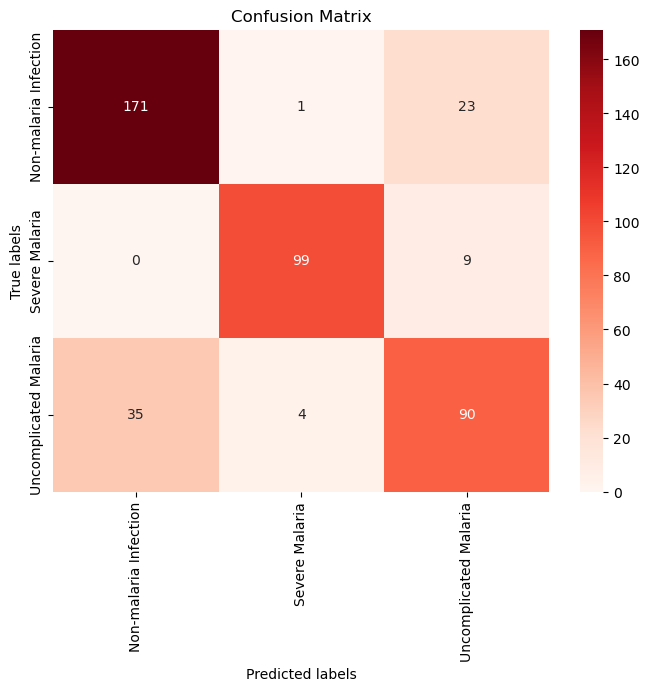

In [92]:
#confusion matrix
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_test,y_pred)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Reds", xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.xticks(rotation='vertical')
plt.show()